In [ ]:
!pip install scipy numpy matplotlib pandas sklearn

In [2]:

import pandas as pd
import numpy as np

## Basic data pre-processing ##

In [3]:
# If the data is in .csv
mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_allsbjs.csv')

In [4]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,-4.516727,-6.263800,-5.725365,-7.130945,-9.711886,...,0.368663,0.388763,0.361791,1.865539,0.0,0.0,0.500000,0.0,NaN,NaN
175296,0.4,6811,79,1,1,-4.225398,-6.021411,-6.309019,-7.301486,-9.633378,...,0.412933,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735,0.254520
175297,0.3,6811,79,1,1,-4.305932,-5.913641,-6.310800,-7.253252,-9.668088,...,0.394851,0.401651,0.379019,1.980931,0.0,0.0,0.500000,0.0,NaN,NaN
175298,0.2,6811,79,1,1,-4.146675,-5.690611,-6.052502,-7.268907,-9.663966,...,0.383634,0.442798,0.392801,1.925202,0.0,0.0,1.000000,0.0,NaN,NaN


In [5]:
# Search for missing values
mydata.isnull().sum()



Label                            0
Sbj_ID                           0
Age                              0
ifCleanOnset                     0
SleepStage                       0
                             ...  
Biphasic_vertices_count,     14820
Sleep_spindles_count,        14820
K_complex_count,             14820
O-information               137816
S-information               137816
Length: 72, dtype: int64

In [6]:
# Exclude the following columns: O-information, S-information, Monophasic_vertices_count, Biphasic_vertices_count, Sleep_spindles_count, K_complex_count

mydata = mydata.drop(['O-information', 'S-information', 'Monophasic_vertices_count,', 'Biphasic_vertices_count,', 'Sleep_spindles_count,', 'K_complex_count,'], axis=1)

In [8]:
# Search for missing values
mydata.isnull().sum()

Label                                   0
Sbj_ID                                  0
Age                                     0
ifCleanOnset                            0
SleepStage                              0
                                    ...  
SP_Summaries_welch_rect_centroid    14820
FC_LocalSimple_mean3_stderr         14820
Entropy_Rate_CTW                    14820
Entropy_Rate_LZ                     14820
Aperiodic_component                 14820
Length: 66, dtype: int64

In [9]:
# Drop rows with missing values
mydata = mydata.dropna()


In [10]:
# Search for missing values
mydata.isnull().sum()

Label                               0
Sbj_ID                              0
Age                                 0
ifCleanOnset                        0
SleepStage                          0
                                   ..
SP_Summaries_welch_rect_centroid    0
FC_LocalSimple_mean3_stderr         0
Entropy_Rate_CTW                    0
Entropy_Rate_LZ                     0
Aperiodic_component                 0
Length: 66, dtype: int64

In [11]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,SP_Summaries_welch_rect_area_5_1,SB_BinaryStats_diff_longstretch0,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.447412,5.500000,0.904203,0.072917,0.062500,0.138058,0.336799,0.316177,0.316998,0.660012
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.462243,5.666667,1.300950,0.083333,0.104167,0.273049,0.539413,0.515705,0.532923,0.645414
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.453025,4.500000,0.895349,0.083333,0.062500,0.104311,0.287693,0.305671,0.334226,0.720780
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.434796,5.500000,0.909583,0.083333,0.416667,0.122718,0.328391,0.316754,0.310106,0.680707
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.457333,4.500000,0.849270,0.083333,0.062500,0.050621,0.270287,0.285799,0.272204,0.673053
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,-4.516727,-6.263800,-5.725365,-7.130945,-9.711886,...,0.960037,12.000000,1.528099,0.375000,0.833333,0.015340,0.368663,0.388763,0.361791,1.865539
175296,0.4,6811,79,1,1,-4.225398,-6.021411,-6.309019,-7.301486,-9.633378,...,0.950024,12.000000,1.580642,0.145833,0.510417,0.035282,0.412933,0.448138,0.423812,1.977827
175297,0.3,6811,79,1,1,-4.305932,-5.913641,-6.310800,-7.253252,-9.668088,...,0.954096,13.000000,1.537313,0.187500,0.479167,0.029146,0.394851,0.401651,0.379019,1.980931
175298,0.2,6811,79,1,1,-4.146675,-5.690611,-6.052502,-7.268907,-9.663966,...,0.959003,14.000000,1.557845,0.187500,0.135417,0.026078,0.383634,0.442798,0.392801,1.925202


In [12]:
# Find infinity values

mydata[mydata == np.inf].sum()


Label                               0.0
Sbj_ID                              0.0
Age                                 0.0
ifCleanOnset                        0.0
SleepStage                          0.0
                                   ... 
SP_Summaries_welch_rect_centroid    0.0
FC_LocalSimple_mean3_stderr         0.0
Entropy_Rate_CTW                    0.0
Entropy_Rate_LZ                     0.0
Aperiodic_component                 0.0
Length: 66, dtype: float64

## Assess correlation between time to sleep onset and other variables ##

In [13]:
# Find correlation between variables

mydata.corr()


,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,SP_Summaries_welch_rect_area_5_1,SB_BinaryStats_diff_longstretch0,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component
Label,1.000000,-0.000259,-0.013603,-0.012703,-0.305875,0.148463,0.099855,0.071331,0.255114,0.310098,...,-0.280831,-0.292472,-0.009466,0.012319,-0.012784,0.096526,0.126801,0.141868,0.142994,-0.327825
Sbj_ID,-0.000259,1.000000,0.016314,0.002368,0.023388,0.023903,0.030145,0.016074,0.027999,0.012340,...,-0.001536,-0.009988,-0.029780,0.002941,0.007041,-0.015391,-0.018129,-0.017668,-0.020308,0.002053
Age,-0.013603,0.016314,1.000000,-0.027153,0.024021,-0.080454,-0.012146,0.036940,-0.047393,-0.003087,...,-0.021545,0.016085,0.029916,-0.007828,-0.027903,0.050523,0.037071,0.037211,0.038582,-0.034990
ifCleanOnset,-0.012703,0.002368,-0.027153,1.000000,-0.145535,0.000521,-0.006602,-0.027448,0.029946,0.067573,...,-0.071493,-0.082723,0.049078,0.011451,0.004540,0.045580,0.079438,0.076472,0.076769,-0.071775
SleepStage,-0.305875,0.023388,0.024021,-0.145535,1.000000,0.101388,0.048358,-0.075795,-0.165757,-0.174121,...,0.166767,0.184739,-0.103915,0.019093,-0.006439,-0.146847,-0.205091,-0.206817,-0.201487,0.265268
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SP_Summaries_welch_rect_centroid,0.096526,-0.015391,0.050523,0.045580,-0.146847,-0.340769,-0.197317,-0.031636,0.141649,0.234716,...,-0.506997,-0.188911,0.459350,0.029434,-0.043975,1.000000,0.770965,0.634212,0.669547,-0.420772
FC_LocalSimple_mean3_stderr,0.126801,-0.018129,0.037071,0.079438,-0.205091,-0.452506,-0.434666,-0.338112,-0.010948,0.186618,...,-0.371183,-0.306073,0.813803,0.138545,0.092123,0.770965,1.000000,0.930693,0.952187,-0.399752
Entropy_Rate_CTW,0.141868,-0.017668,0.037211,0.076472,-0.206817,-0.406803,-0.443652,-0.394481,-0.073950,0.165786,...,-0.302465,-0.324280,0.844923,0.173116,0.120958,0.634212,0.930693,1.000000,0.974165,-0.411806
Entropy_Rate_LZ,0.142994,-0.020308,0.038582,0.076769,-0.201487,-0.400405,-0.418674,-0.372939,-0.069478,0.170579,...,-0.322313,-0.320814,0.848044,0.153224,0.102082,0.669547,0.952187,0.974165,1.000000,-0.409955


In [14]:
# Find the most correlated variables

mydata.corr().unstack().sort_values().drop_duplicates()

gamma_power                  SP_Summaries_welch_rect_area_5_1   -0.920314
Aperiodic_component          gamma_power                        -0.882005
Beta_to_gamma_ratio          gamma_power                        -0.838281
gamma_power                  SB_BinaryStats_diff_longstretch0   -0.824243
Alpha_to_gamma_ratio         gamma_power                        -0.817536
                                                                   ...   
Phase_amplitude_coupling_TG  Phase_amplitude_coupling_DA         0.964005
Phase_amplitude_coupling_DT  Phase_amplitude_coupling_TG         0.965191
Entropy_Rate_LZ              Entropy_Rate_CTW                    0.974165
Phase_amplitude_coupling_DB  Phase_amplitude_coupling_TG         0.983030
Label                        Label                               1.000000
Length: 2146, dtype: float64

In [15]:
# Find the most correlated variables with the target variable (Label) but exclude the results that have NaN values and the results that are equal to 1

mydata.corr()['Label'].sort_values().dropna().drop_duplicates()

#mydata.corr()['Label'].sort_values()





Aperiodic_component                    -0.327825
CO_Embed2_Dist_tau_d_expfit_meandiff   -0.310326
SleepStage                             -0.305875
SB_BinaryStats_diff_longstretch0       -0.292472
CO_HistogramAMI_even_2_5               -0.291186
                                          ...   
Entropy_Rate_LZ                         0.142994
delta_power                             0.148463
beta_power                              0.255114
gamma_power                             0.310098
Label                                   1.000000
Name: Label, Length: 66, dtype: float64

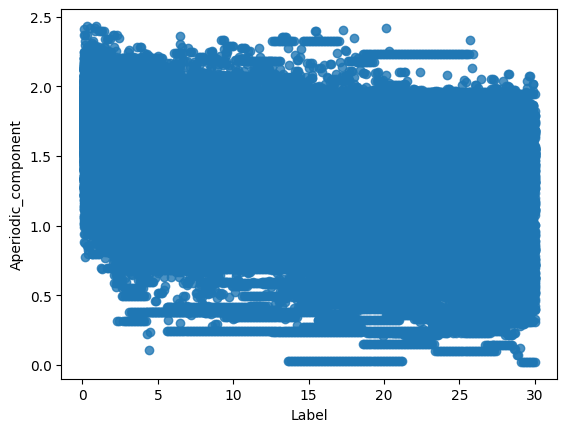

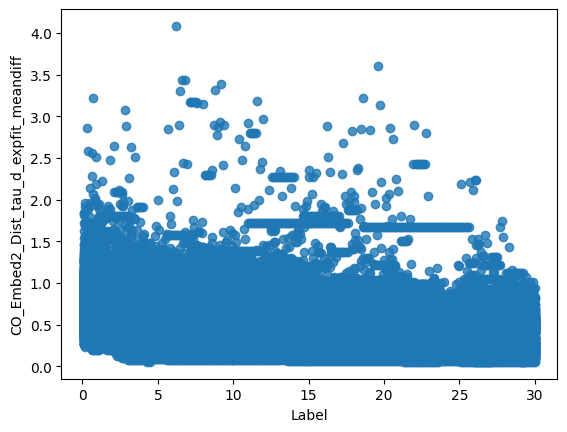

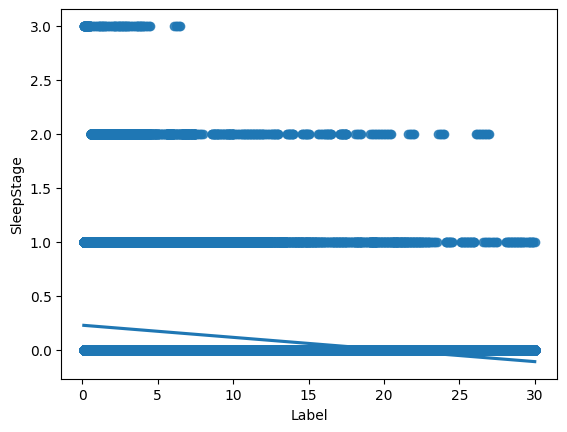

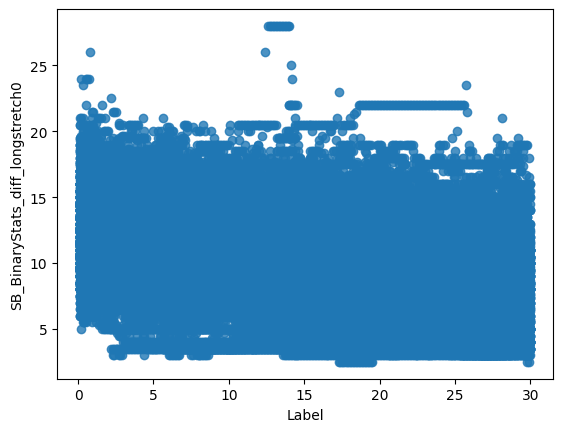

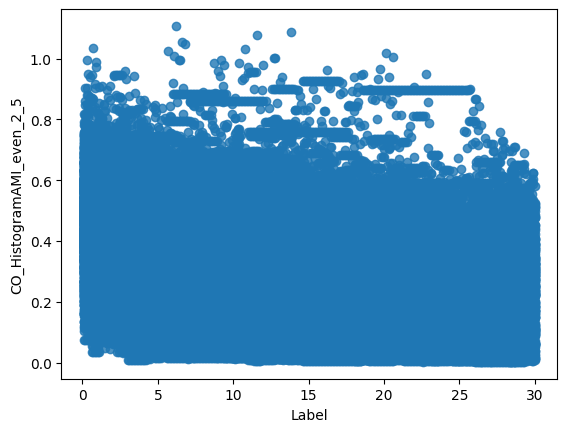

...

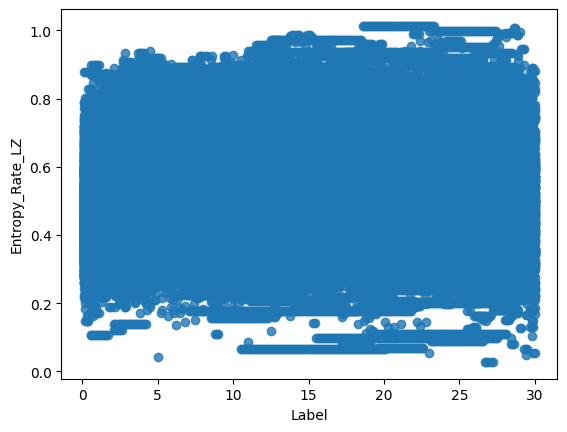

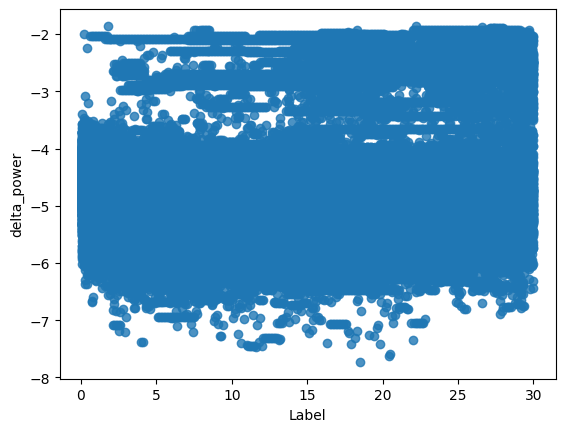

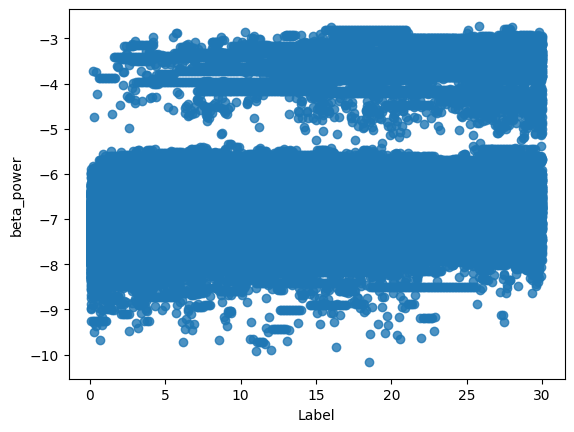

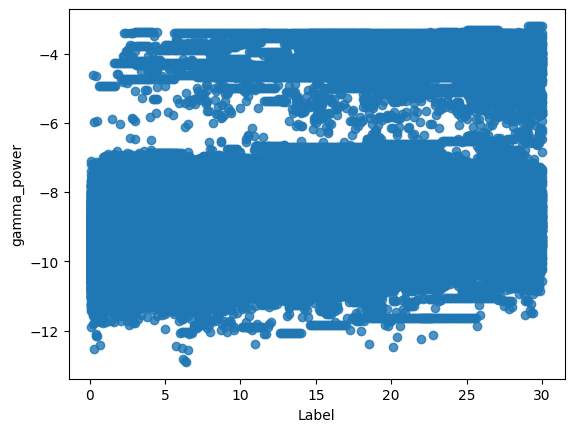

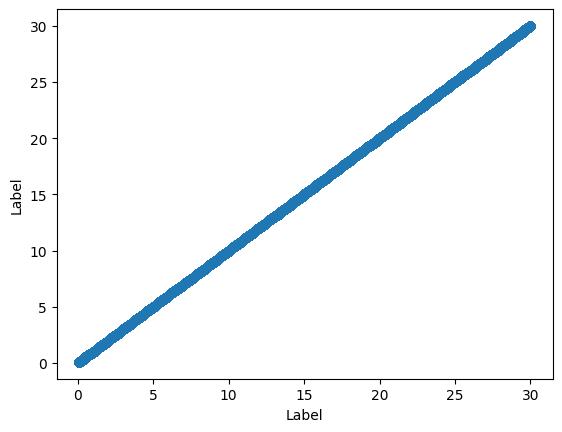

In [17]:
# Make plots the correlation between the Label and most correlated variables for each variable

import matplotlib.pyplot as plt
import seaborn as sns

for i in mydata.corr()['Label'].sort_values().dropna().drop_duplicates().index[0:]:
    sns.regplot(x= "Label", y=i, data=mydata)
    plt.show()

In [18]:
# Plot the correlation of top 20 correlated and anticorrelated variables with the target variable (Label)

import seaborn as sns

corr = mydata.corr()
corr_target = abs(corr["Label"])
relevant_features = corr_target[corr_target>0.15]
relevant_features.sort_values(ascending=False)

top_20 = relevant_features.sort_values(ascending=False).head(20)

top_20



Label                                      1.000000
Aperiodic_component                        0.327825
CO_Embed2_Dist_tau_d_expfit_meandiff       0.310326
gamma_power                                0.310098
SleepStage                                 0.305875
SB_BinaryStats_diff_longstretch0           0.292472
CO_HistogramAMI_even_2_5                   0.291186
Alpha_to_gamma_ratio                       0.289303
SP_Summaries_welch_rect_area_5_1           0.280831
Beta_to_gamma_ratio                        0.280034
Theta_to_gamma_ratio                       0.268745
beta_power                                 0.255114
IN_AutoMutualInfoStats_40_gaussian_fmmi    0.222251
Alpha_to_beta_ratio                        0.218368
Theta_to_beta_ratio                        0.217538
Theta_to_alpha_ratio                       0.214544
Delta_to_beta_ratio                        0.160130
SB_BinaryStats_mean_longstretch1           0.154475
Name: Label, dtype: float64

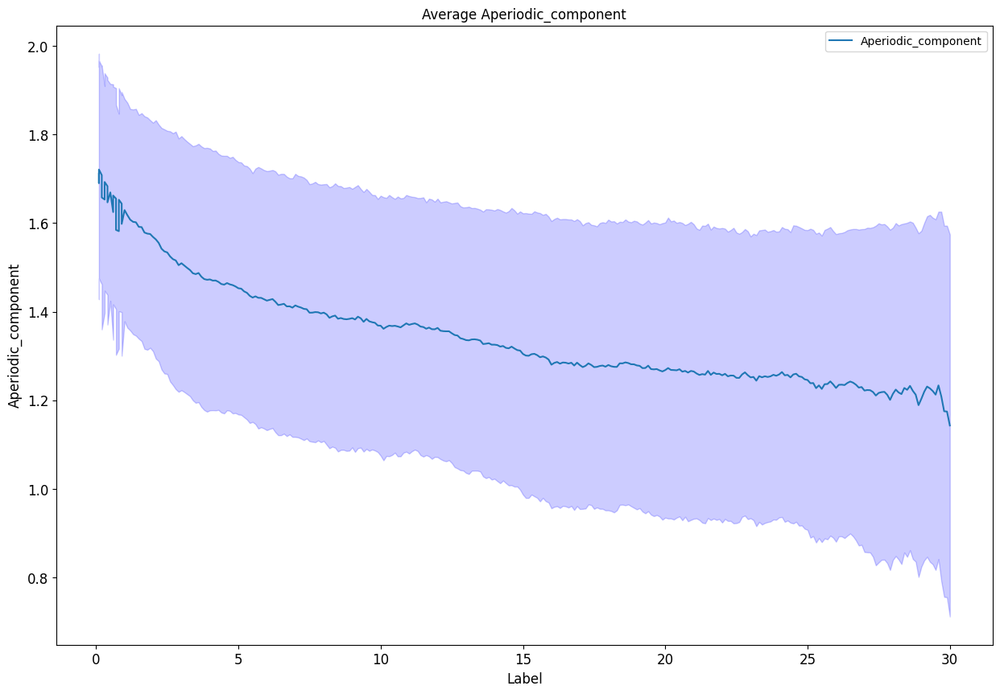

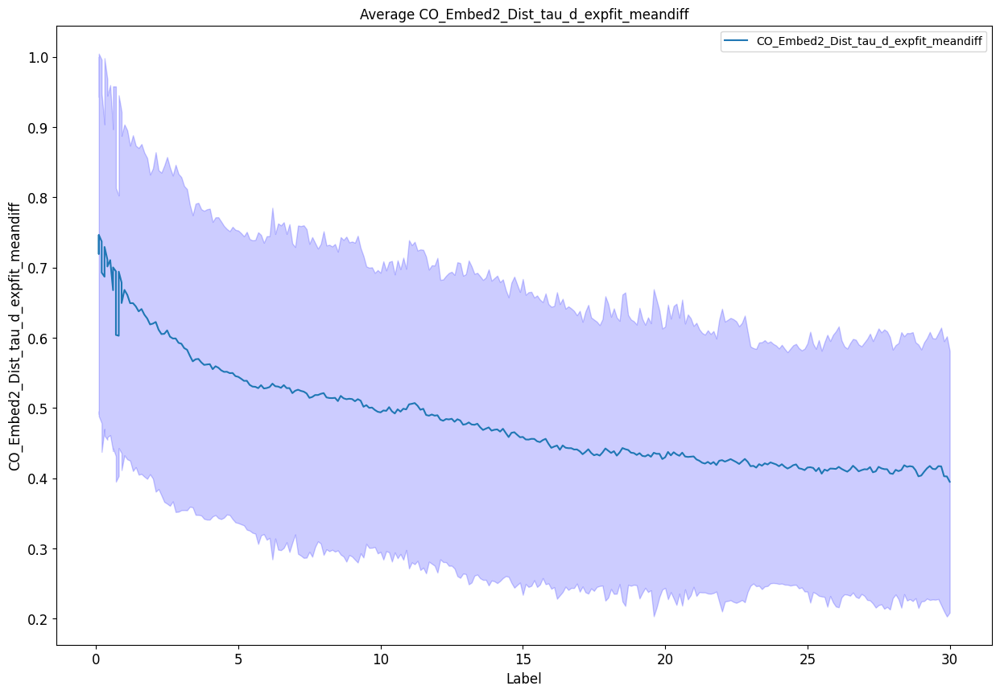

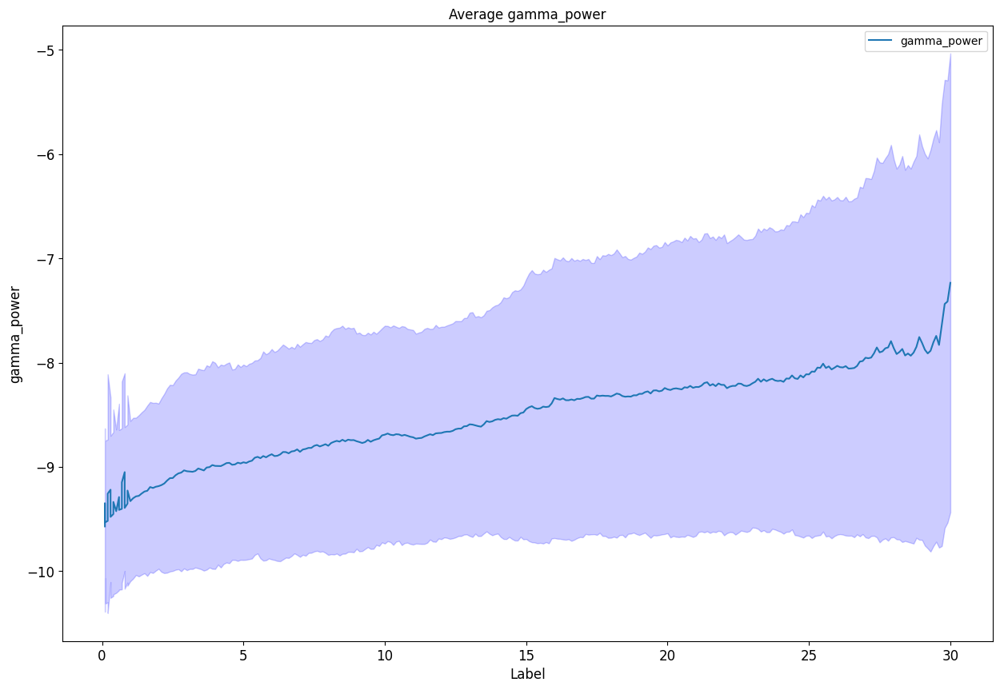

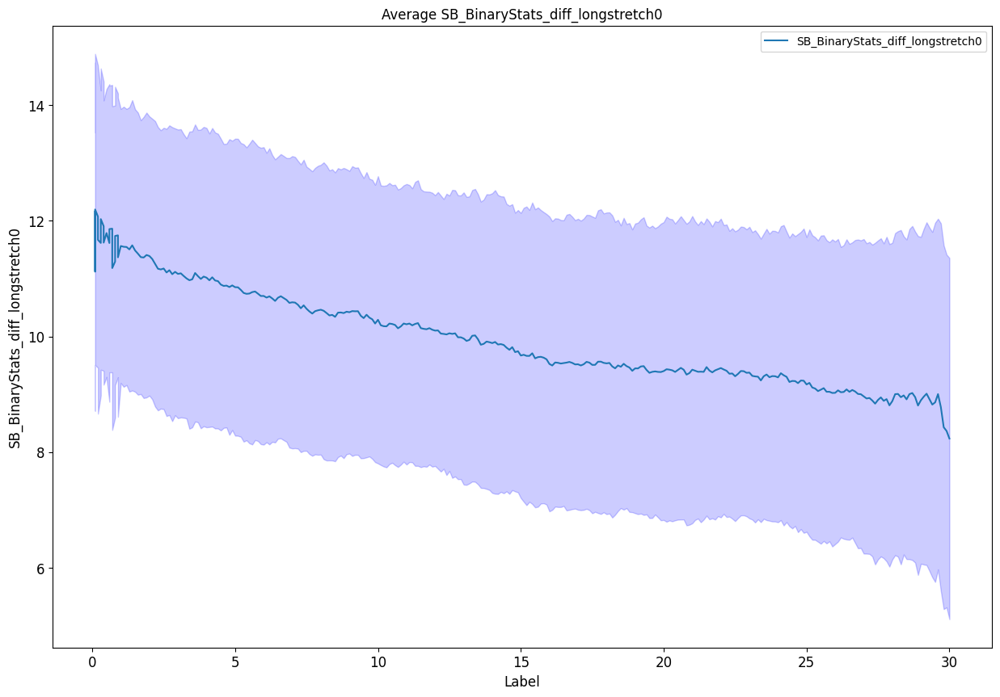

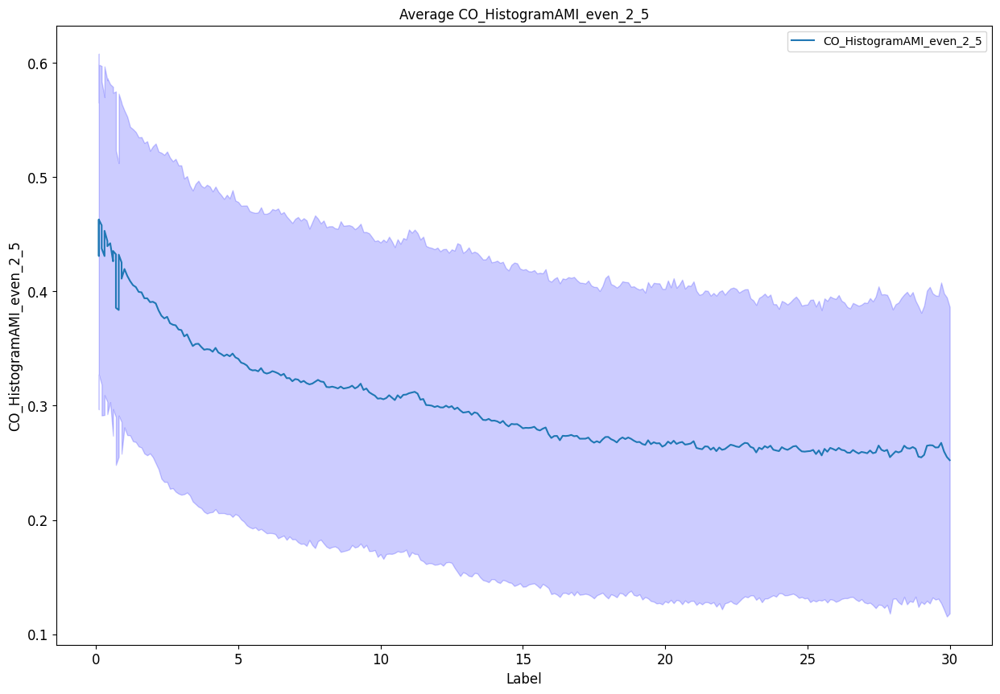

...

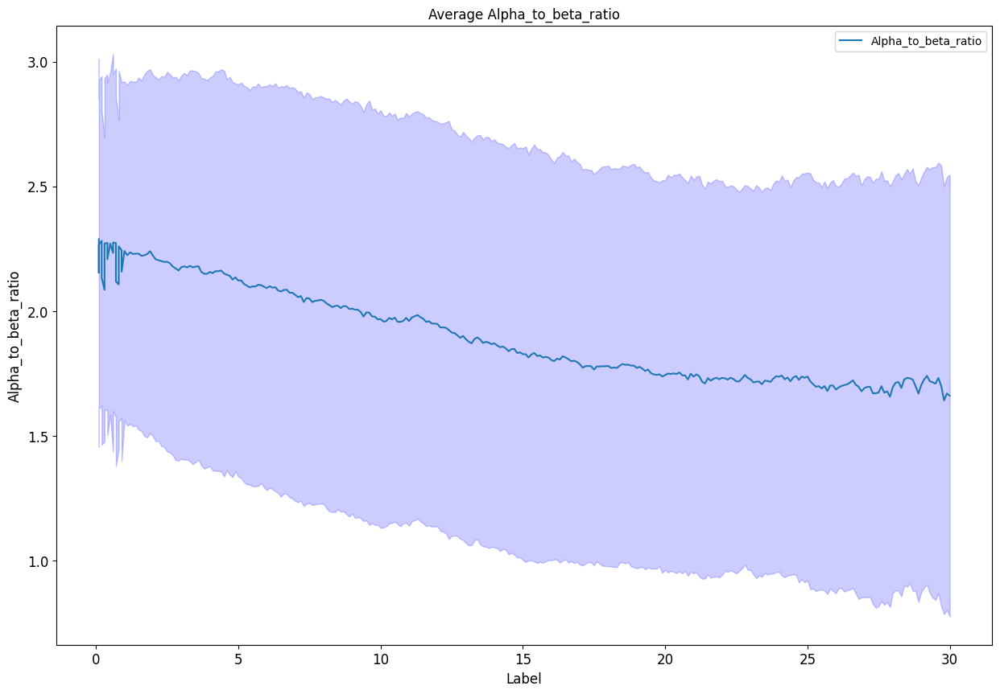

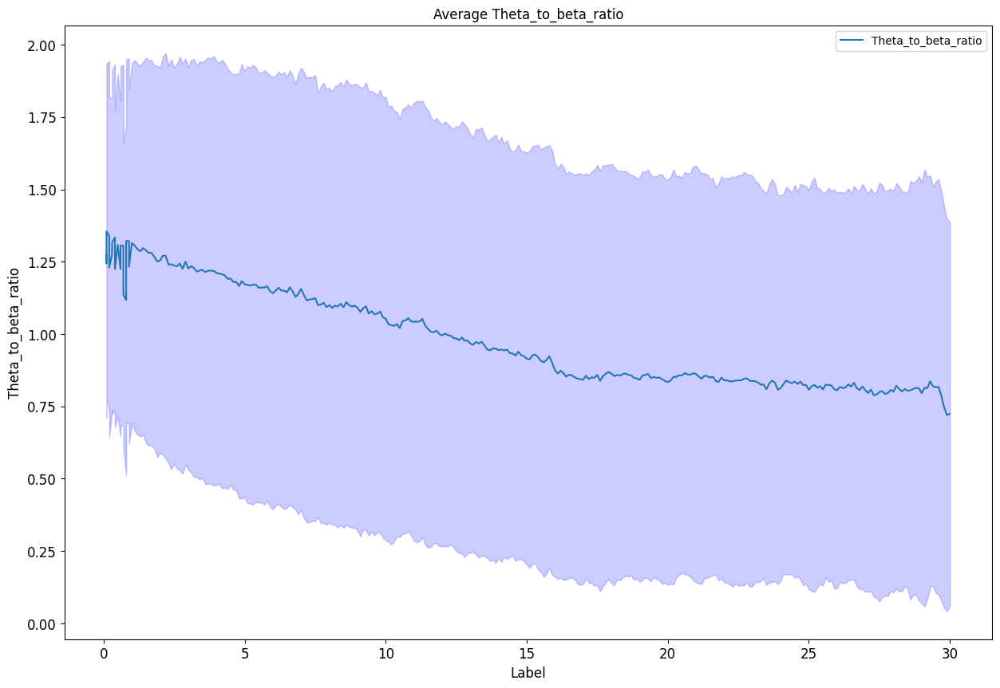

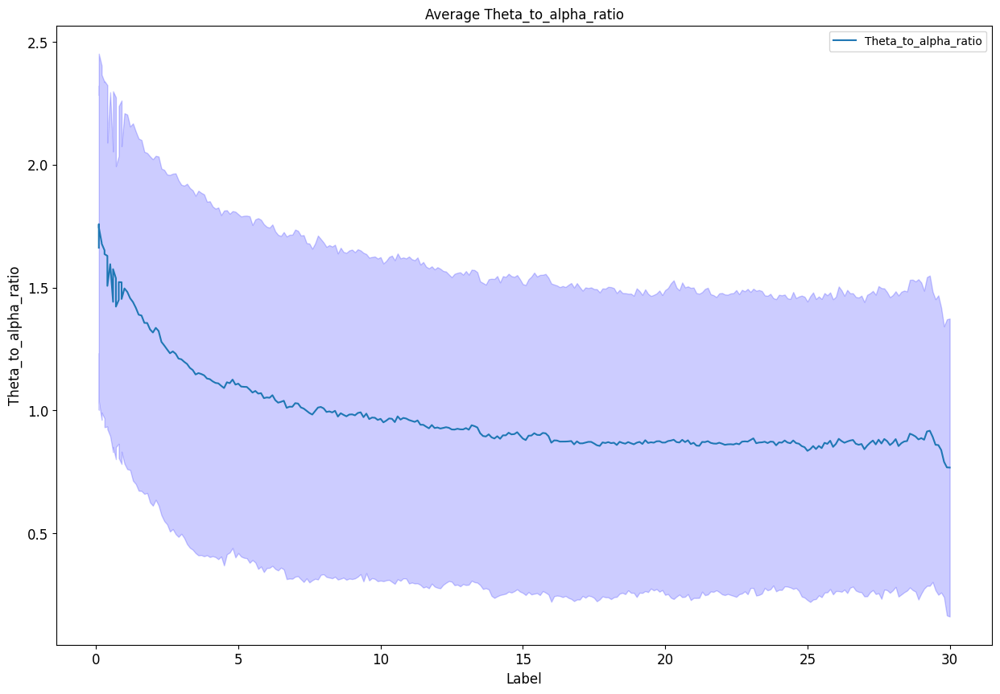

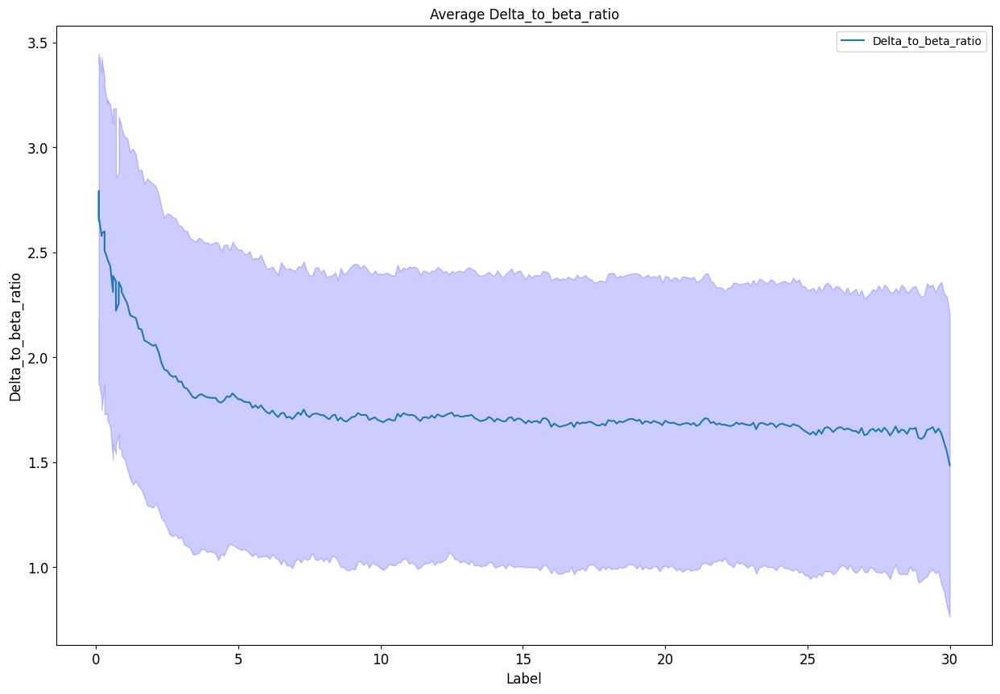

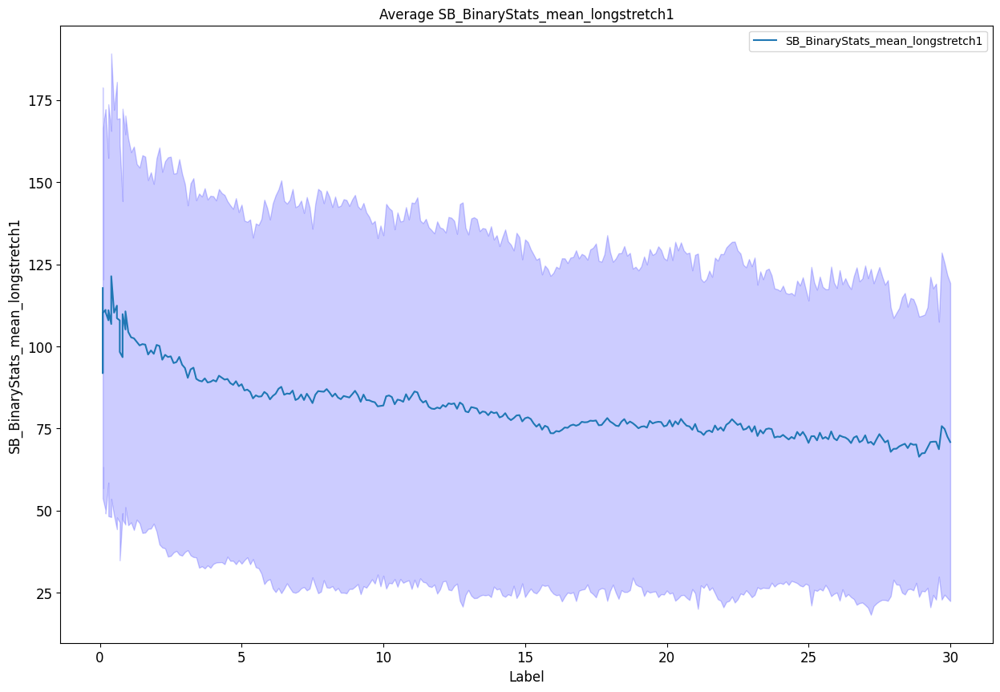

In [31]:
# For the top 20 correlated variables, plot how their values change with the decreasing target variable (Label) (average + std)

labels = mydata['Label'].unique()
labels.sort()

for i in top_20.index[1:]:
    # exclude SleepStage
    if i == 'SleepStage':
        continue
    average = mydata.groupby('Label')[i].mean()
    std = mydata.groupby('Label')[i].std()
    plot = average.plot(title='Average ' + i, figsize=(15, 10), legend=True, fontsize=12)
    plot.fill_between(labels, average - std, average + std, color='b', alpha=0.2)
    plot.set_xlabel('Label', fontsize=12)
    plot.set_ylabel(i, fontsize=12)
    plt.show()



    
    

Sbj ID:  1301


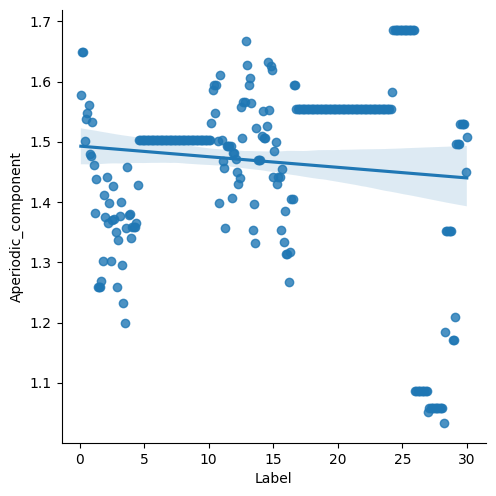

Sbj ID:  405


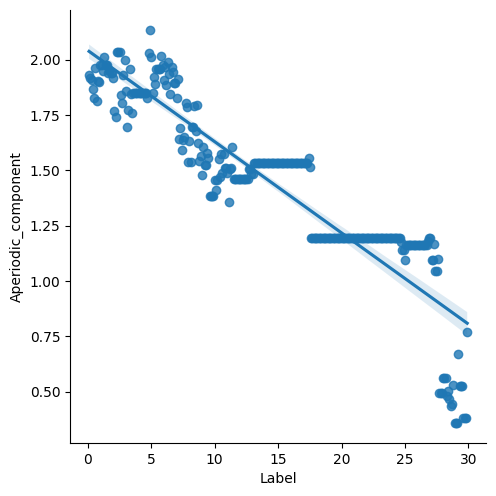

Sbj ID:  1766


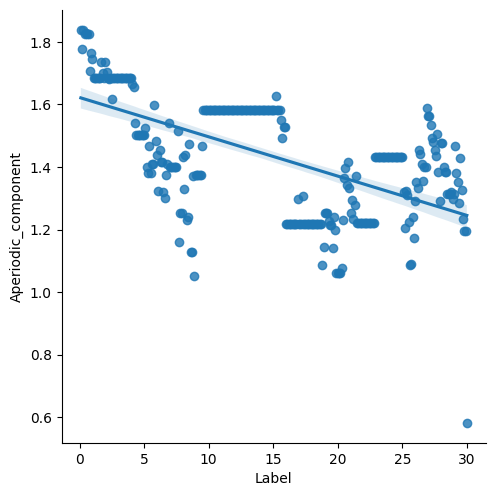

Sbj ID:  4330


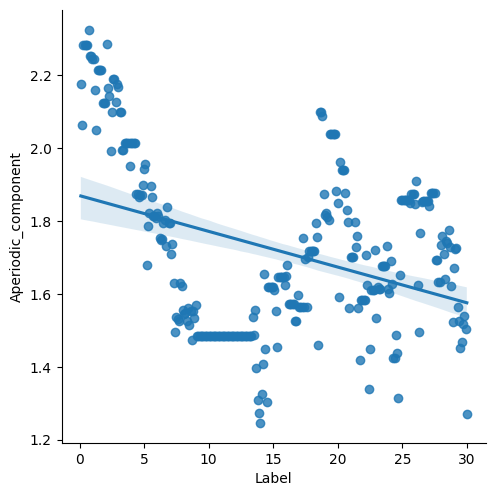

Sbj ID:  3492


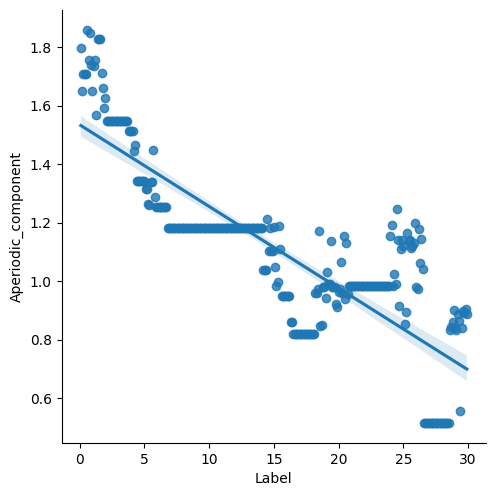

Sbj ID:  2995


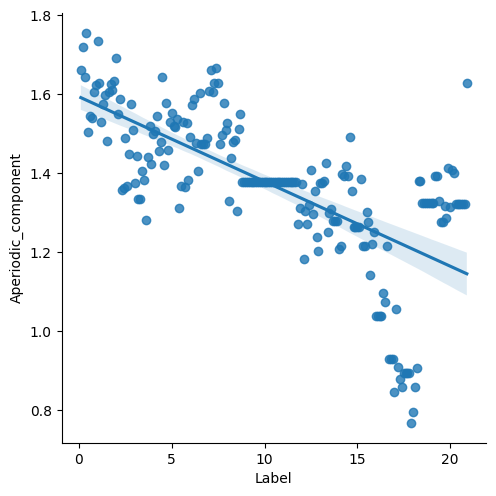

Sbj ID:  4789


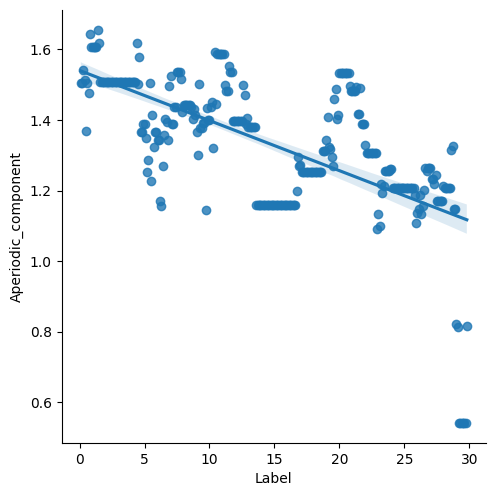

Sbj ID:  10


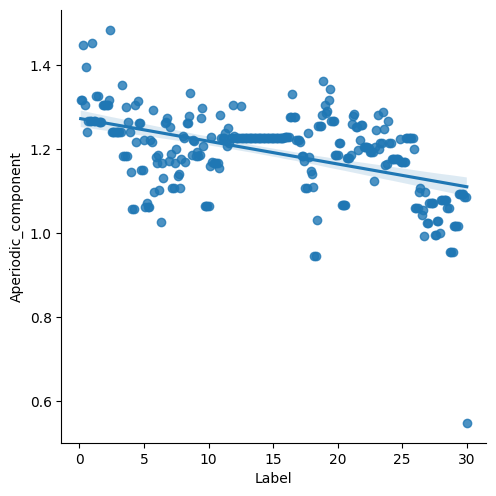

Sbj ID:  5890


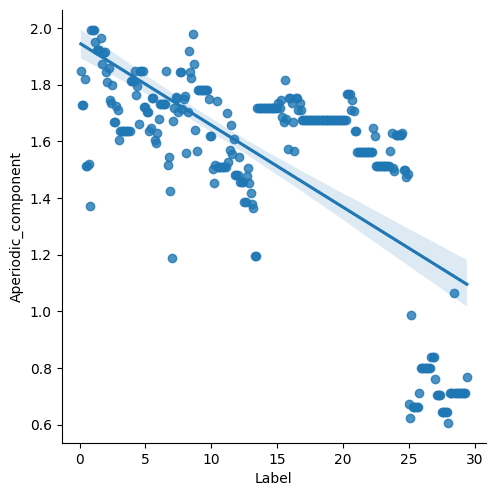

In [21]:
# For first 10 random subject (Sbj_ID) show how each feature is changing with decreasing time to sleep onset (Label) for feature Aperiodic_component

import random

counter = 0
subjects = mydata['Sbj_ID'].unique()
random.shuffle(subjects)
for i in subjects:
    counter = counter + 1
    if counter < 10:
        print('Sbj ID: ', i)
        sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['Aperiodic_component'], height=5, aspect=1, kind='reg')
        plt.show()
    else:
        continue

Sbj ID:  5706


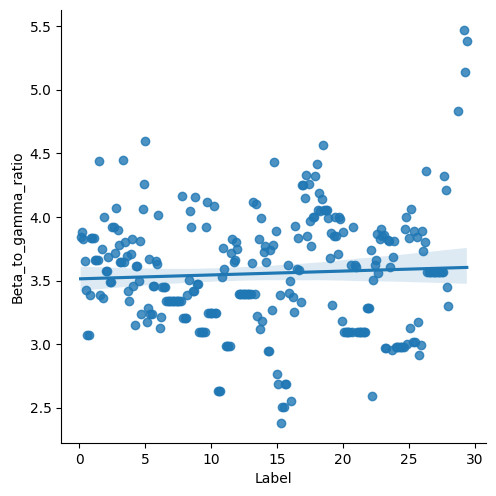

Sbj ID:  4611


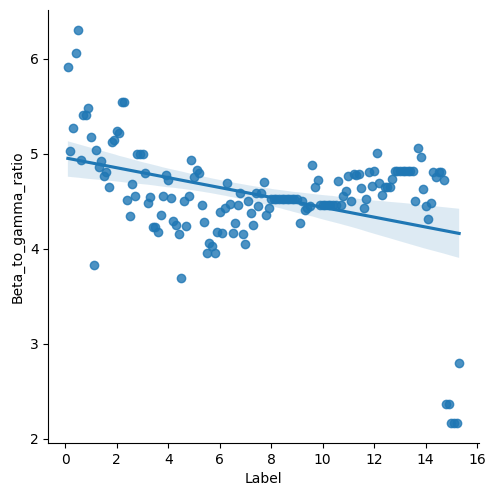

Sbj ID:  5888


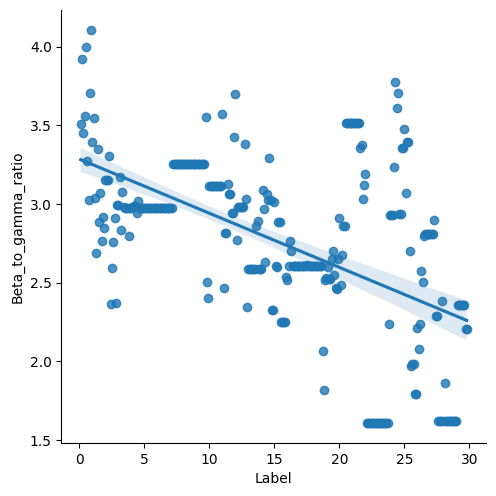

Sbj ID:  726


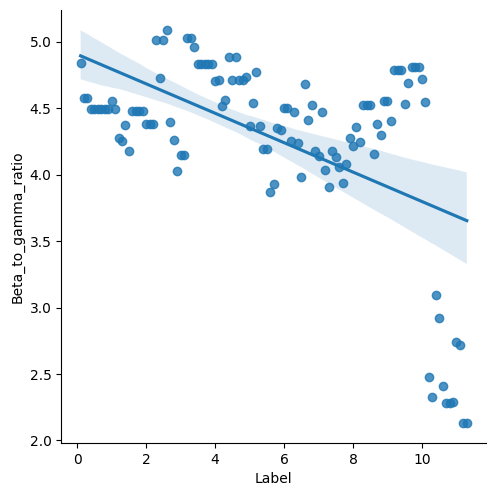

Sbj ID:  3190


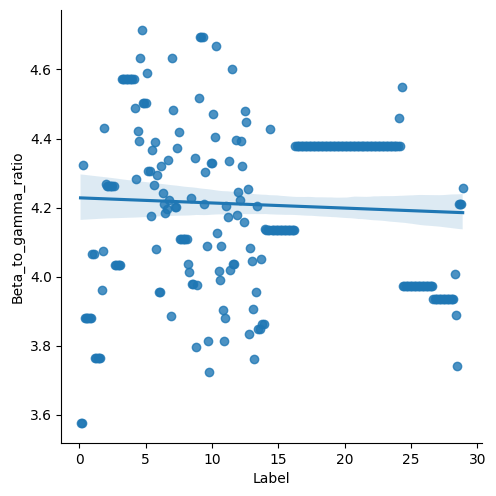

Sbj ID:  5782


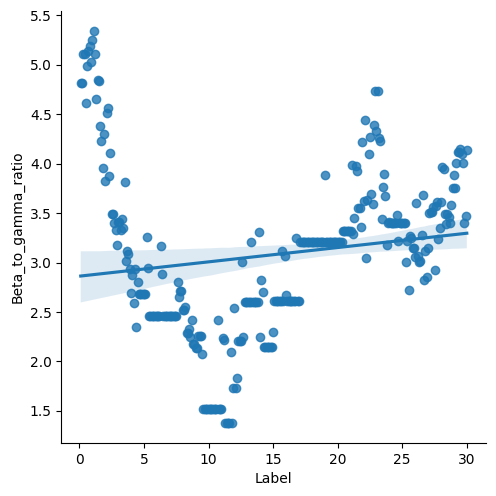

Sbj ID:  3259


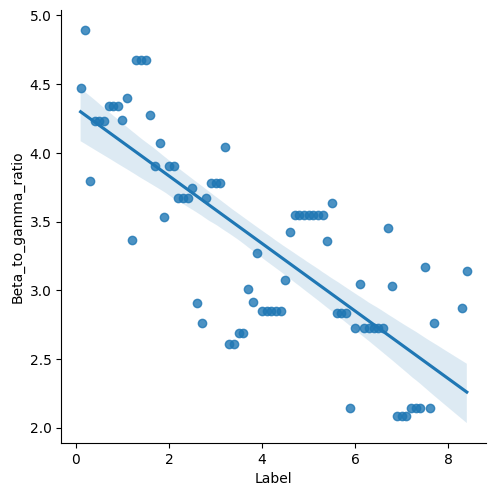

Sbj ID:  6430


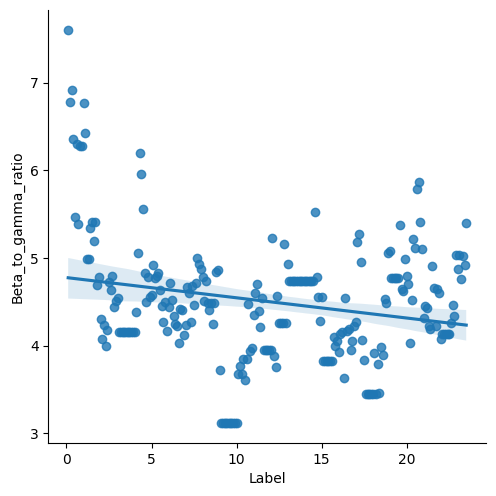

Sbj ID:  6614


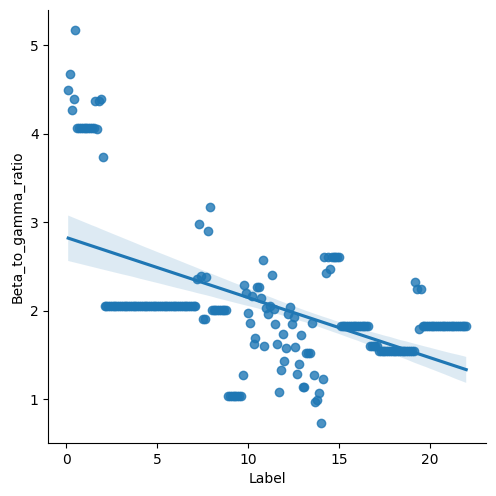

In [32]:

counter = 0
subjects = mydata['Sbj_ID'].unique()
random.shuffle(subjects)
for i in subjects:
    counter = counter + 1
    if counter < 10:
        print('Sbj ID: ', i)
        sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['Beta_to_gamma_ratio'], height=5, aspect=1, kind='reg')
        plt.show()
    else:
        continue

Sbj ID:  1271


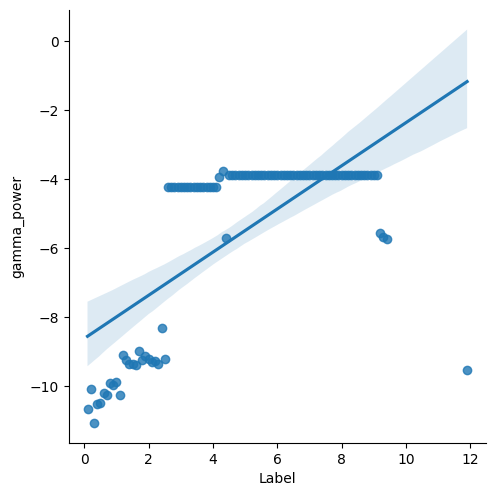

Sbj ID:  4888


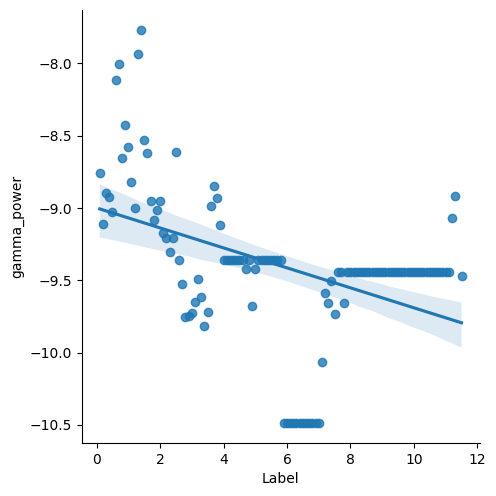

Sbj ID:  2040


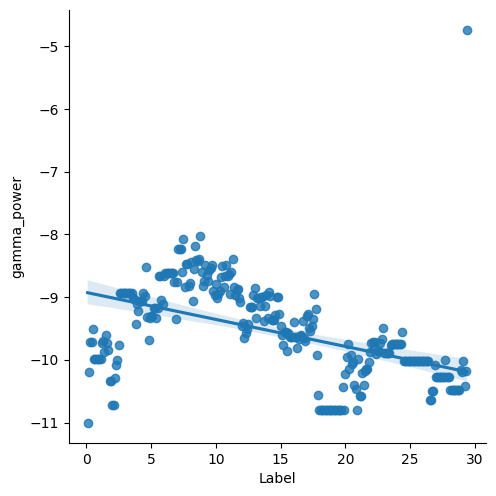

Sbj ID:  491


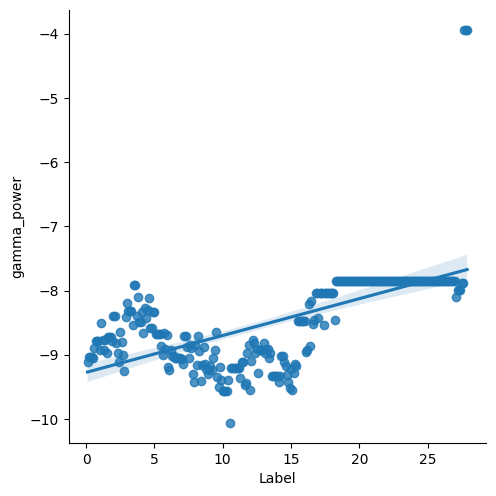

Sbj ID:  784


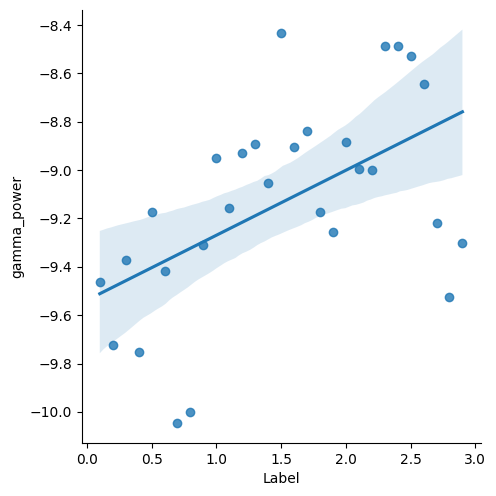

Sbj ID:  4706


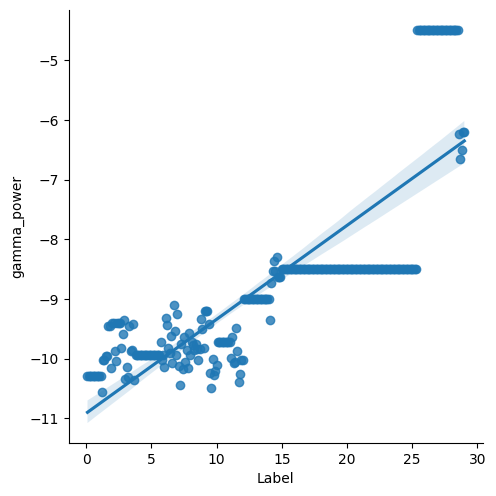

Sbj ID:  6663


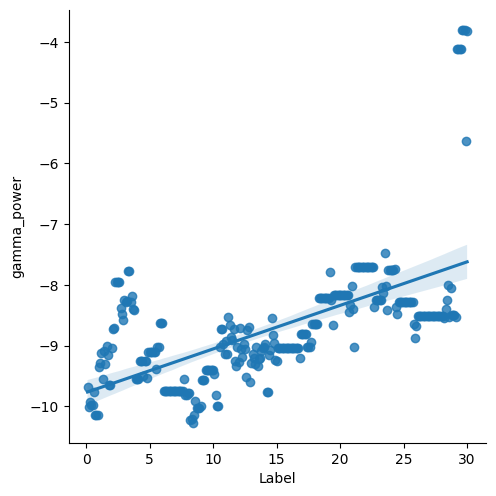

Sbj ID:  4367


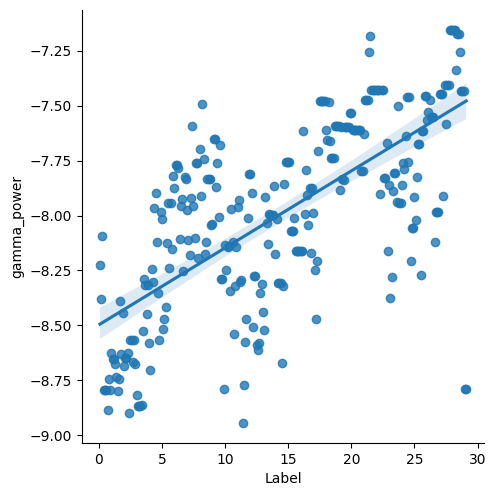

Sbj ID:  5608


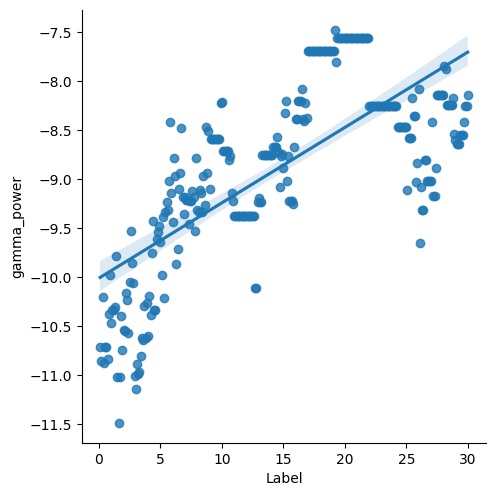

In [33]:

counter = 0
subjects = mydata['Sbj_ID'].unique()
random.shuffle(subjects)
for i in subjects:
    counter = counter + 1
    if counter < 10:
        print('Sbj ID: ', i)
        sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['gamma_power'], height=5, aspect=1, kind='reg')
        plt.show()
    else:
        continue

# Regression from single feature veactor of extracted EEG period 

In [34]:
import pandas as pd
import numpy as np
import sklearn
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict

## Random Forest on the whole dataset

In [35]:
# Create X and y from dataframes to use in scikit-learn (drop Label, DleepStage, Sbj_ID and ifCleanOnset columns)

X = mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y = mydata['Label']

# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# Create a random forest Regressor

rf = RandomForestRegressor(n_estimators=300)
 
# Perform cross-validation and get the predictions

predictions_cv = cross_val_predict(rf, X_train, y_train, cv=10)



In [47]:
import matplotlib.pyplot as plt

# Create a function for plotting the sorted feature importances in a long horizontal bar chart and increased font size

def plot_feature_importances(model, X):
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    names = [X.columns[i] for i in indices]
    fig, ax = plt.subplots(figsize=(16, 24), dpi=80)
    ax.barh(range(X.shape[1]), importances[indices], align='center')
    ax.set_yticks(range(X.shape[1]))
    ax.set_yticklabels(names, fontsize=16)
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')
    ax.set_title('Feature importances')
    plt.show()

    return importances, indices, names

# Create a funciton for evaluating the performance of the model on the test data

def evaluate_performance_test(model, X_test, y_test):

    predictions = model.predict(X_test)

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions, alpha = 0.1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_test - predictions
    plt.scatter(y_test, residuals, alpha = 0.1)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

# Create a function for evaluating the performance of the model on the training data given the predictions it produced

def evaluate_performance_train(model, X_train, y_train, predictions):
    
    errors = abs(y_train - predictions)
    mape = 100 * (errors / y_train)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_train, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_train, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))

    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=1)
    # make a scatter plot with semitransparent dots
    plt.scatter(y_train, predictions, alpha=0.2)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_train - predictions
    plt.scatter(y_train, residuals, alpha=0.2)
    plt.plot([y_train.min(), y_train.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return errors, mape, accuracy, residuals, mse, rmse, r2

In [ ]:
# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_train, y_train, predictions_cv)


Mean Absolute Error: 3.12
Accuracy: -9.6 %.
Mean Squared Error: 22.95
Root Mean Squared Error: 4.79
R2: 0.67


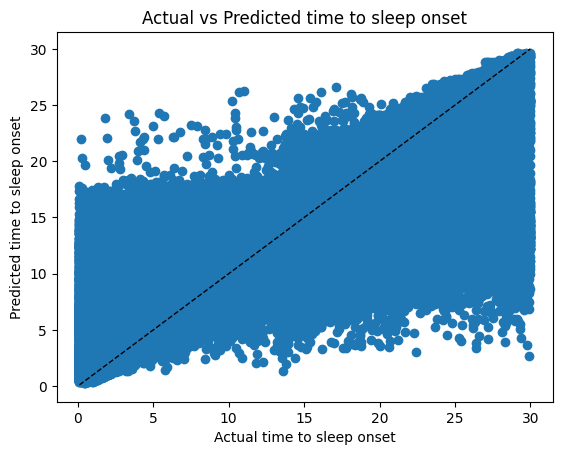

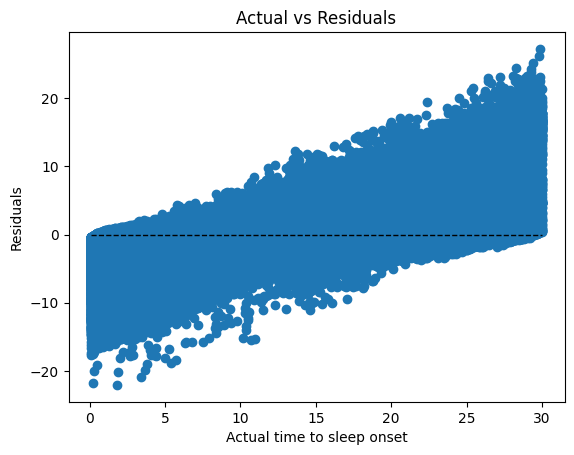

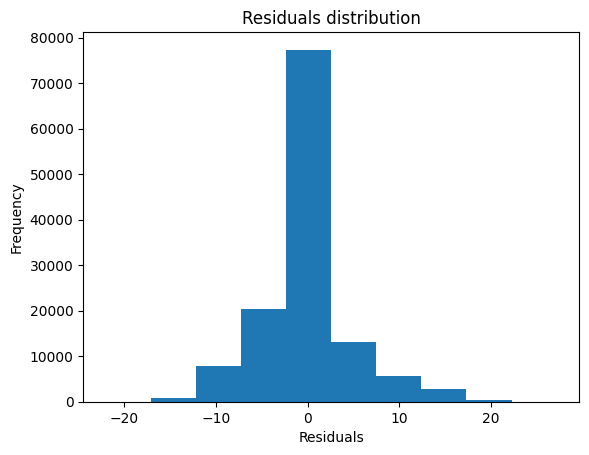

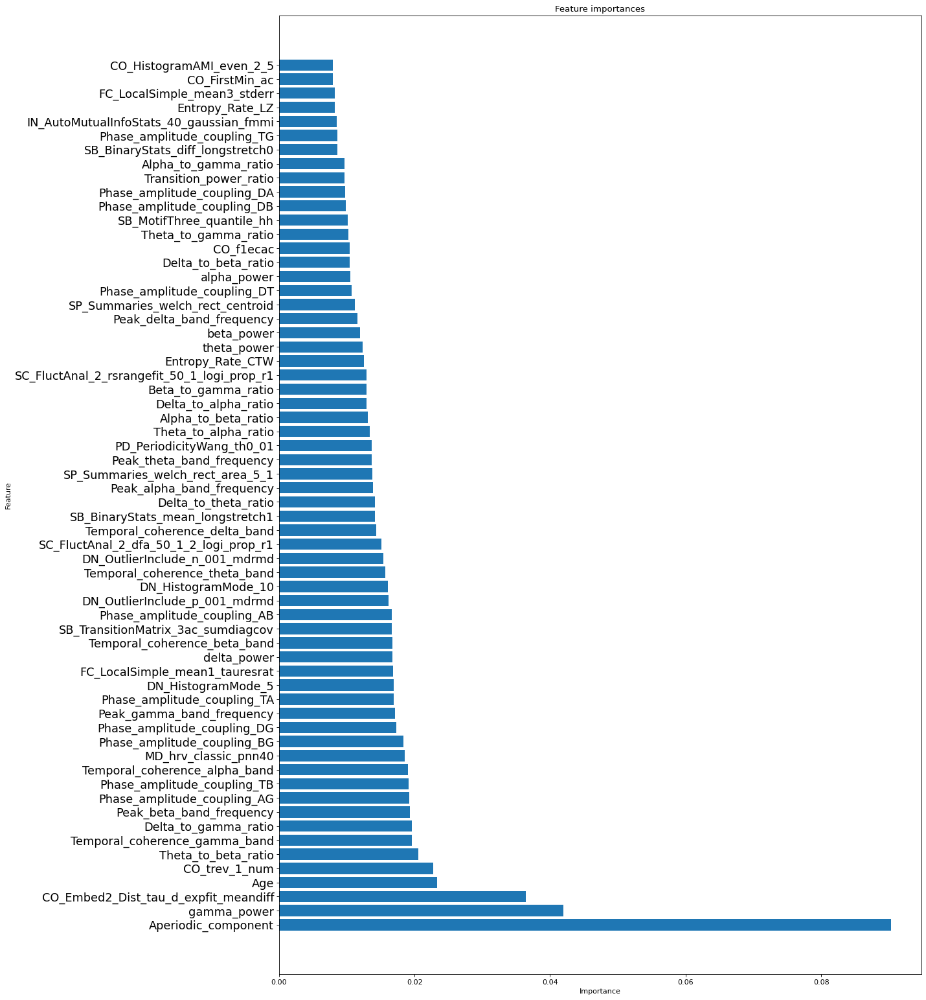

In [37]:


# Plot the feature importances
rf.fit(X_train, y_train)
importances, indices, names = plot_feature_importances(rf, X_train)

Mean Absolute Error: 3.06
Accuracy: -7.31 %.
Mean Squared Error: 22.33
Root Mean Squared Error: 4.73
R2: 0.67


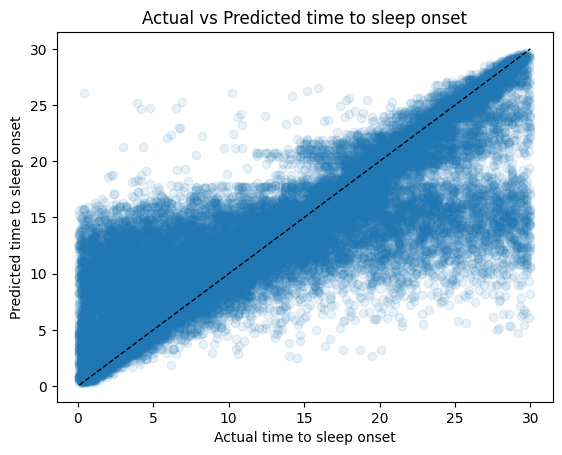

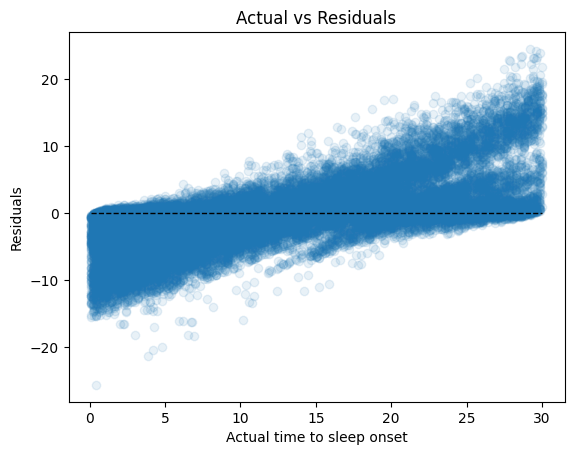

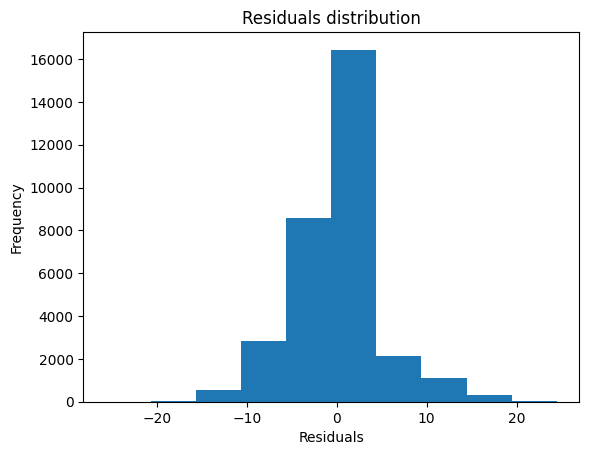

In [48]:
#Evaluate the performance of the model on the test data

predictions, errors, mape, accuracy, residuals,  = evaluate_performance_test(rf, X_test, y_test)



## Random forest only on clean sleep onsets (no intermittent single N2 epochs prior to sleep onset (2 consecutive epochs of N2)) ##

Mean Absolute Error: 3.06
Accuracy: -8.74 %.
Mean Squared Error: 22.46
Root Mean Squared Error: 4.74
R2: 0.67


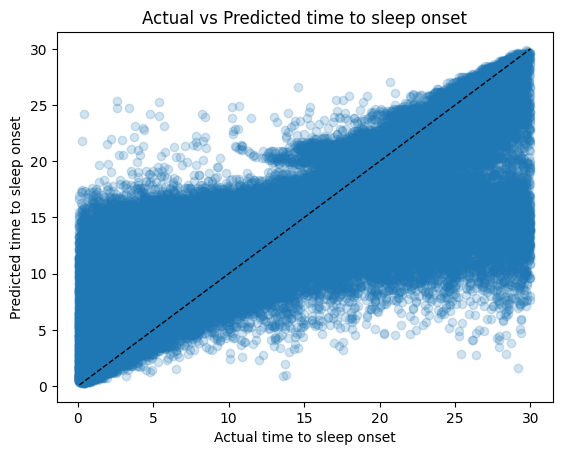

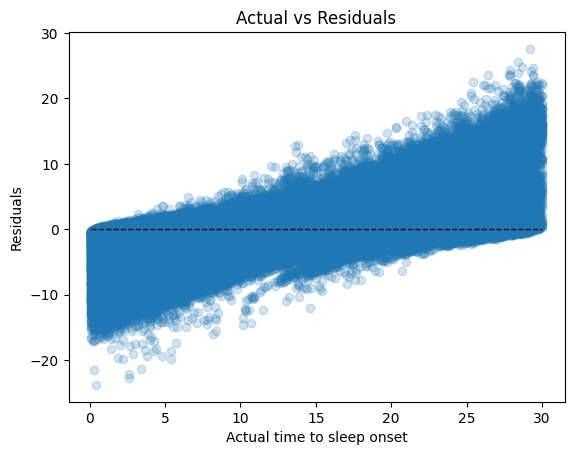

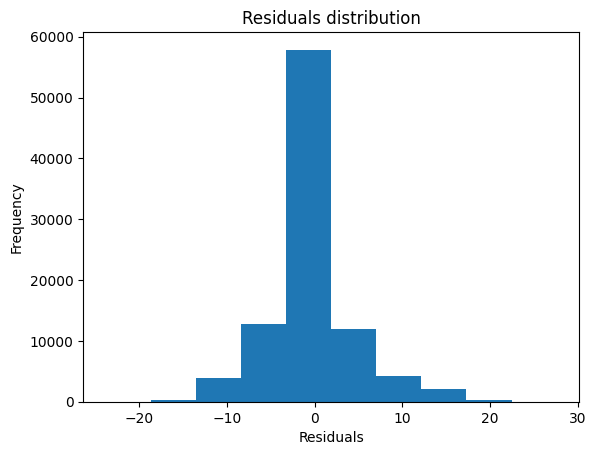

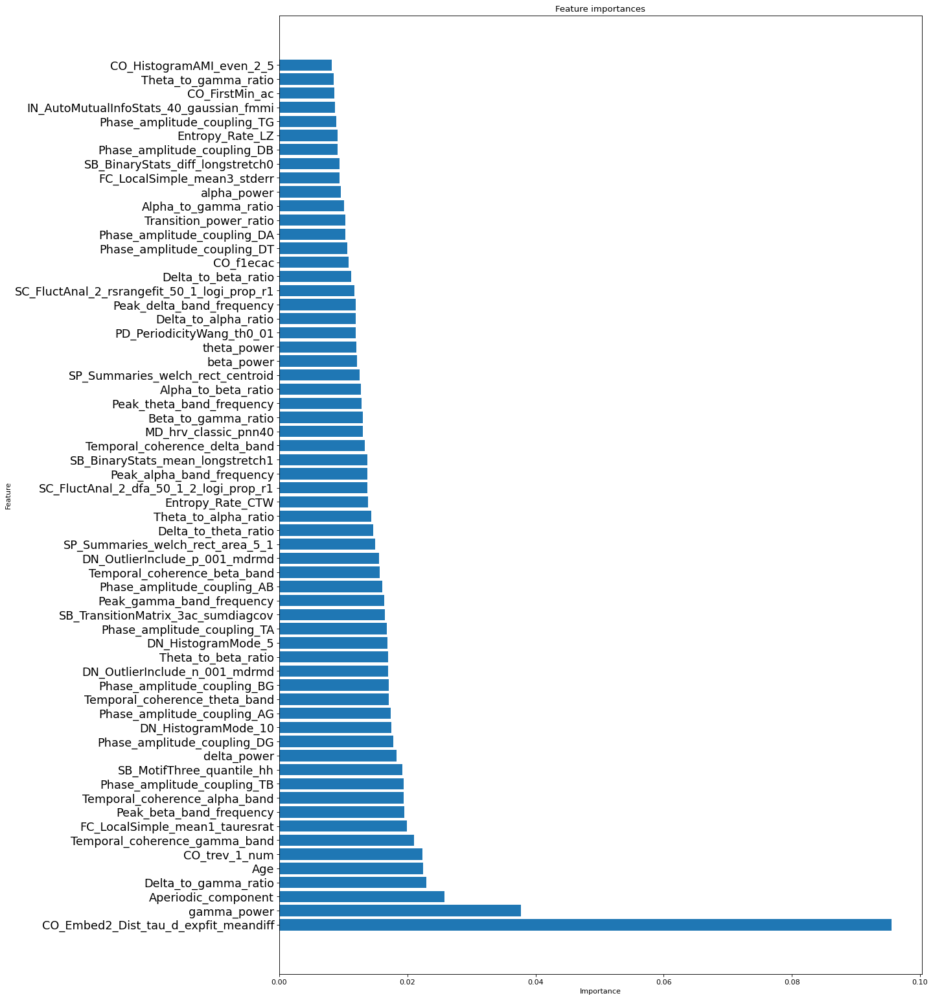

In [51]:
# Create a new dataset only with ifCleanOnset = 1

mydata_clean = mydata[mydata['ifCleanOnset'] == 1]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean = mydata_clean.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean = mydata_clean['Label']

# Split the data into training and testing sets

X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X_clean, y_clean, test_size=0.2)

# Create a random forest Regressor

rf_clean = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_cv = cross_val_predict(rf_clean, X_train_clean, y_train_clean, cv=10)

# evaluate the predictions made during cross-validation

errors_clean, mape_clean, accuracy_clean, residuals_clean, mse_clean, rmse_clean, r2_clean  = evaluate_performance_train(rf_clean, X_train_clean, y_train_clean, predictions_clean_cv)

# Plot the feature importances
rf_clean.fit(X_train_clean, y_train_clean)

importances_clean, indices_clean, names_clean = plot_feature_importances(rf_clean, X_train_clean)




Mean Absolute Error: 2.99
Accuracy: -11.69 %.
Mean Squared Error: 21.74
Root Mean Squared Error: 4.66
R2: 0.69


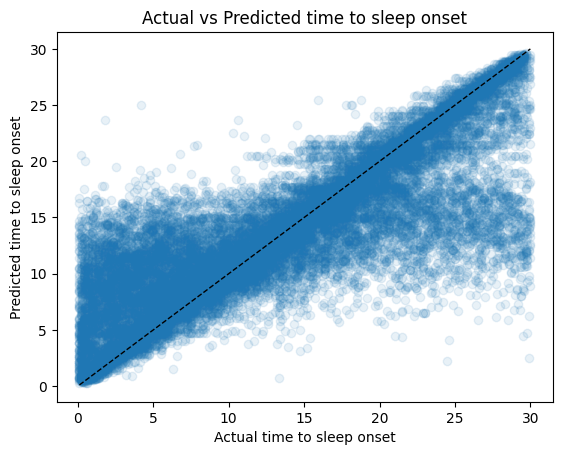

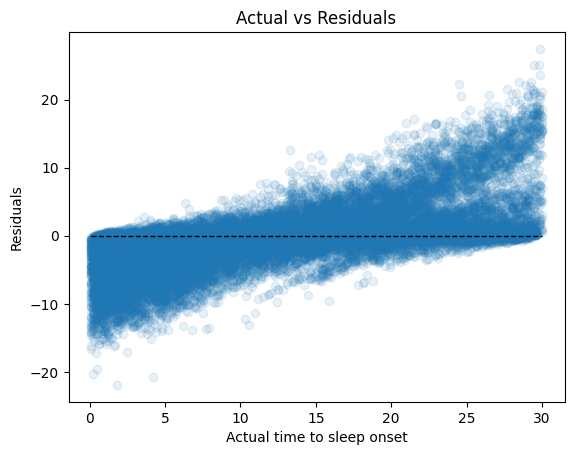

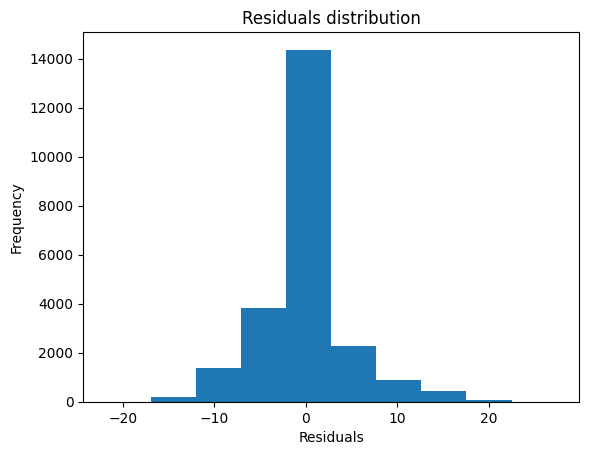

In [52]:
# Evaluate the performance of the model on the test data

predictions_clean, errors_clean, mape_clean, accuracy_clean, residuals_clean  = evaluate_performance_test(rf_clean, X_test_clean, y_test_clean)

## Random forest on **clean onset** and **15 minutes prior to sleep onset** (instead of 30 minutes) ##

Mean Absolute Error: 1.85
Accuracy: 1.31 %.
Mean Squared Error: 6.86
Root Mean Squared Error: 2.62
R2: 0.63


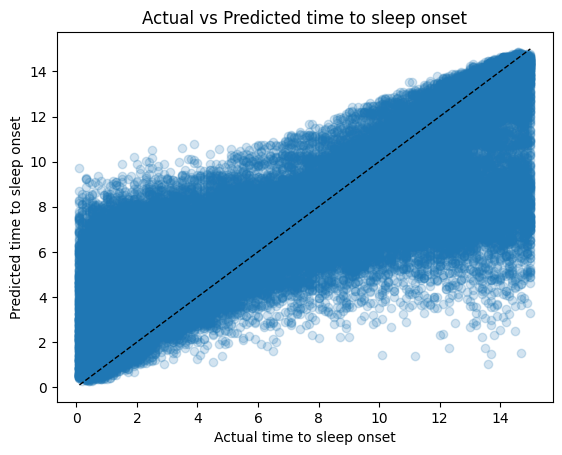

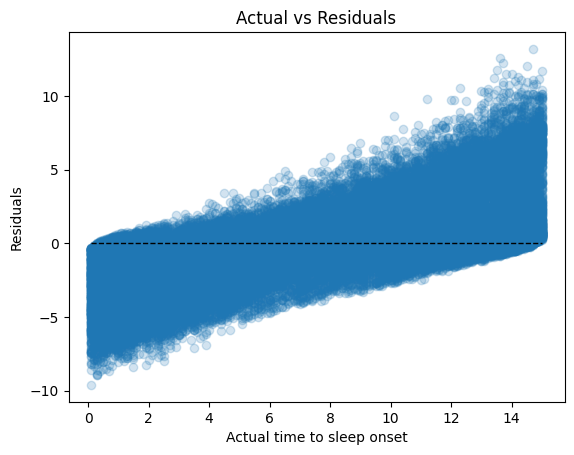

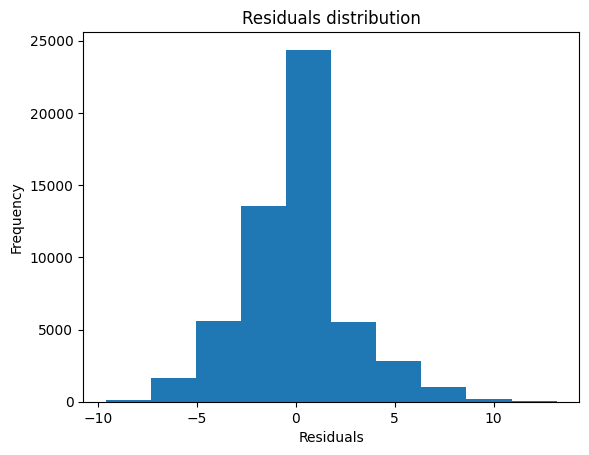

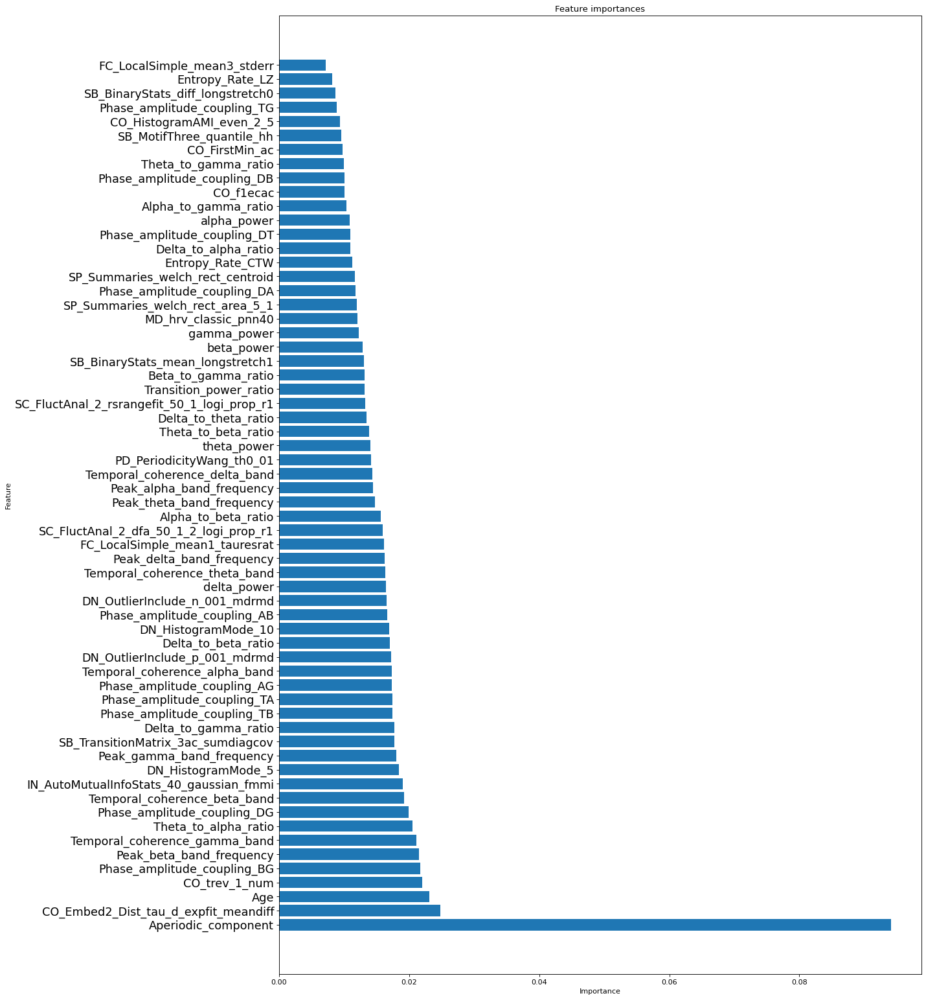

In [53]:
# Look at the clean onset (ifCleanOnset = 1) data and no longer than 15 minutes before the onset (Label <=15)

mydata_clean_15 = mydata_clean[mydata_clean['Label'] <= 15]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_15 = mydata_clean_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_15 = mydata_clean_15['Label']

# Split the data into training and testing sets

X_train_clean_15, X_test_clean_15, y_train_clean_15, y_test_clean_15 = train_test_split(X_clean_15, y_clean_15, test_size=0.2)

# Create a random forest Regressor

rf_clean_15 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_15_cv = cross_val_predict(rf_clean_15, X_train_clean_15, y_train_clean_15, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15, mse_clean_15, rmse_clean_15, r2_clean_15 = evaluate_performance_train(rf_clean_15, X_train_clean_15, y_train_clean_15, predictions_clean_15_cv)

# Plot the feature importances

rf_clean_15.fit(X_train_clean_15, y_train_clean_15)

importances_clean_15, indices_clean_15, names_clean_15 = plot_feature_importances(rf_clean_15, X_train_clean_15)




Mean Absolute Error: 1.81
Accuracy: 5.65 %.
Mean Squared Error: 6.62
Root Mean Squared Error: 2.57
R2: 0.64


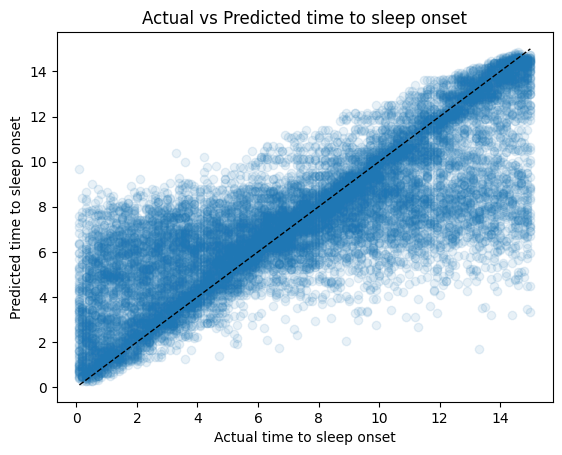

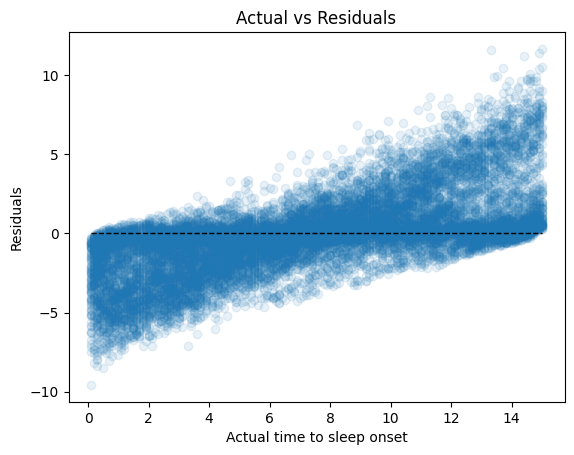

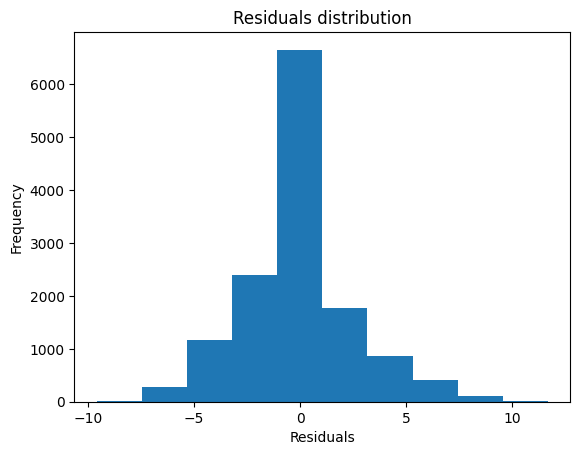

In [54]:
# Evaluate the performance of the model on the test data

predictions_clean_15, errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15  = evaluate_performance_test(rf_clean_15, X_test_clean_15, y_test_clean_15)

Mean Absolute Error: 1.35
Accuracy: 5.95 %.
Mean Squared Error: 3.4
Root Mean Squared Error: 1.84
R2: 0.59


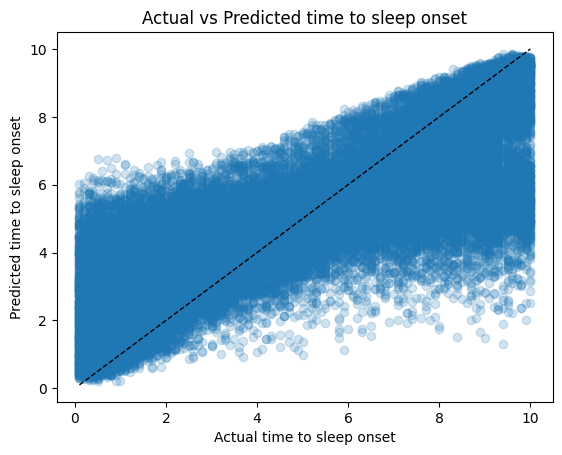

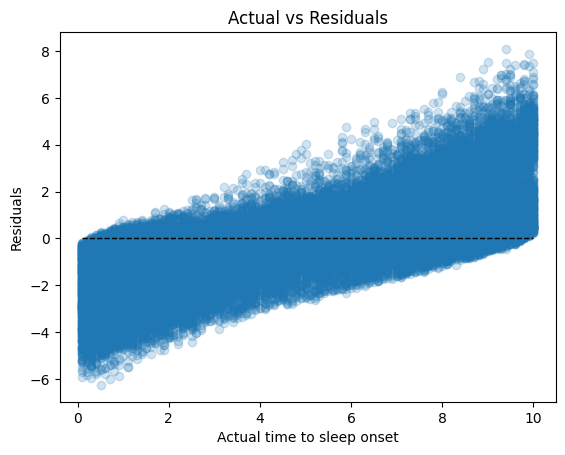

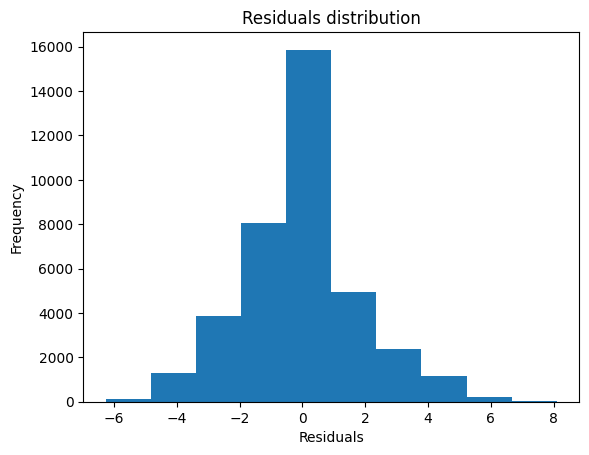

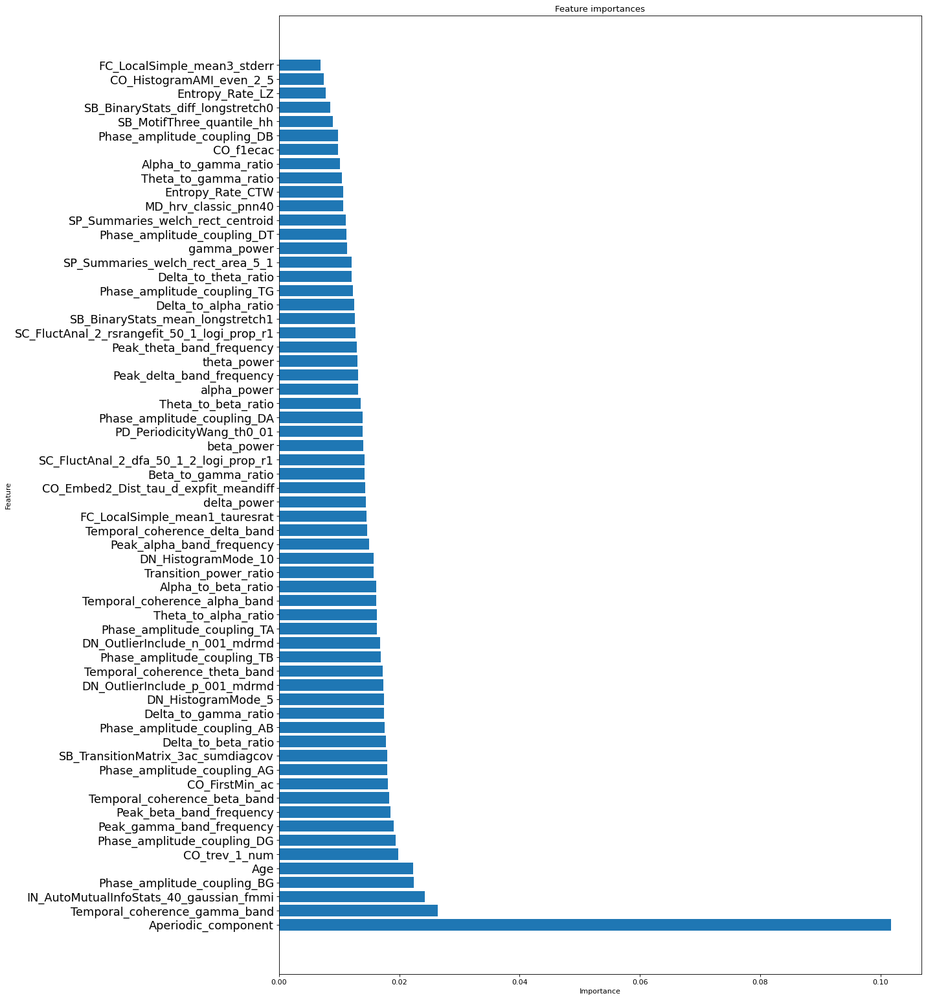

In [55]:

# Look at the clean onset (ifCleanOnset = 1) data and no longer than 10 minutes before the onset (Label <=10)

mydata_clean_10 = mydata_clean[mydata_clean['Label'] <= 10]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_10 = mydata_clean_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_10 = mydata_clean_10['Label']

# Split the data into training and testing sets

X_train_clean_10, X_test_clean_10, y_train_clean_10, y_test_clean_10 = train_test_split(X_clean_10, y_clean_10, test_size=0.2)

# Create a random forest Regressor

rf_clean_10 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_10_cv = cross_val_predict(rf_clean_10, X_train_clean_10, y_train_clean_10, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_10, mape_clean_10, accuracy_clean_10, residuals_clean_10, mse_clean_10, rmse_clean_10, r2_clean_10 = evaluate_performance_train(rf_clean_10, X_train_clean_10, y_train_clean_10, predictions_clean_10_cv)

# Plot the feature importances

rf_clean_10.fit(X_train_clean_10, y_train_clean_10)

importances_clean_10, indices_clean_10, names_clean_10 = plot_feature_importances(rf_clean_10, X_train_clean_10)




Mean Absolute Error: 1.33
Accuracy: 11.29 %.
Mean Squared Error: 3.33
Root Mean Squared Error: 1.82
R2: 0.6


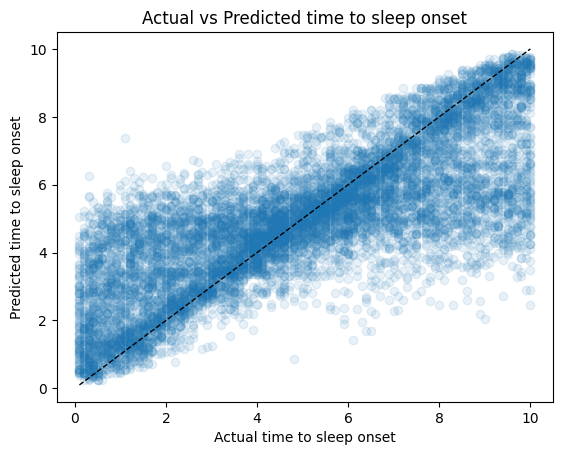

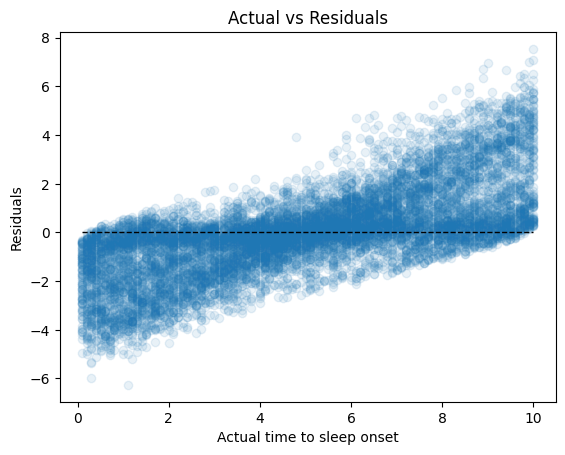

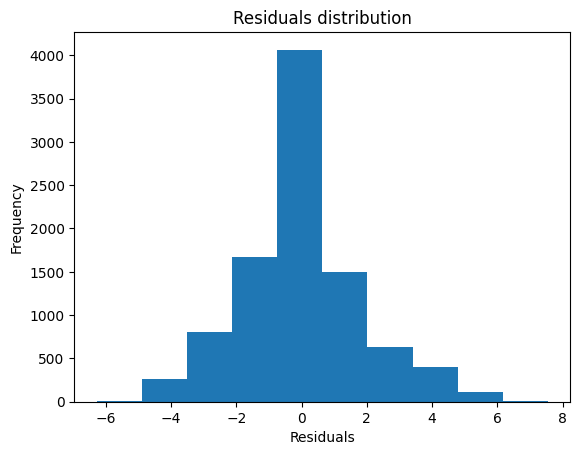

In [56]:
# Evaluate the performance of the model on the test data

predictions_clean_10, errors_clean_10, mape_clean_10, accuracy_clean_10, residuals_clean_10  = evaluate_performance_test(rf_clean_10, X_test_clean_10, y_test_clean_10)

## Random forest on **clean onset** and **30-15 minutes prior to sleep onset** ##

Mean Absolute Error: 1.78
Accuracy: 91.51 %.
Mean Squared Error: 6.63
Root Mean Squared Error: 2.58
R2: 0.62


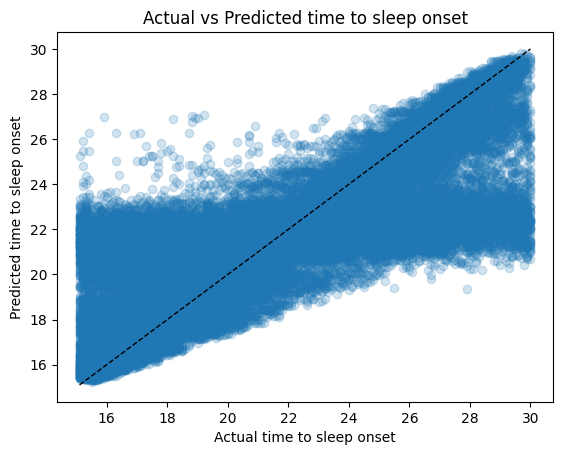

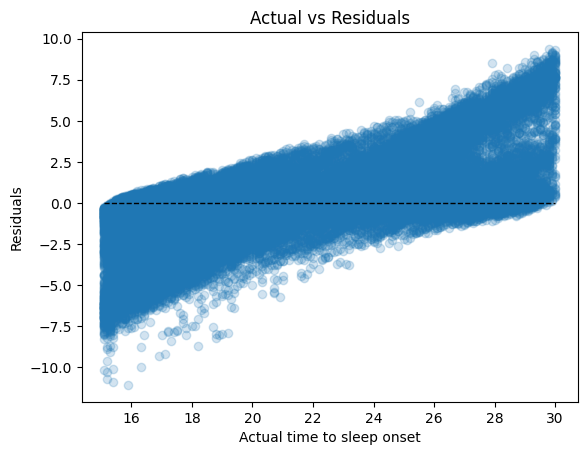

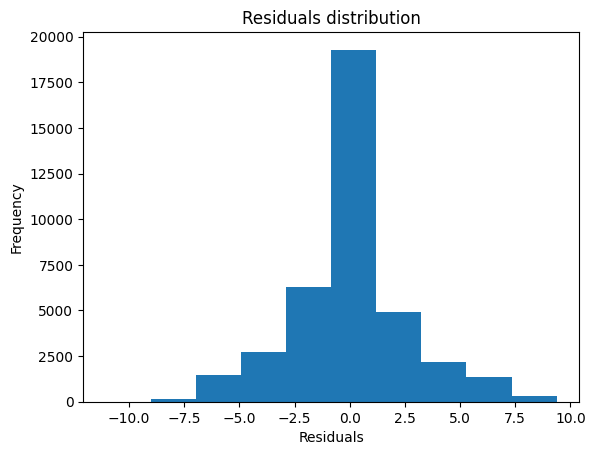

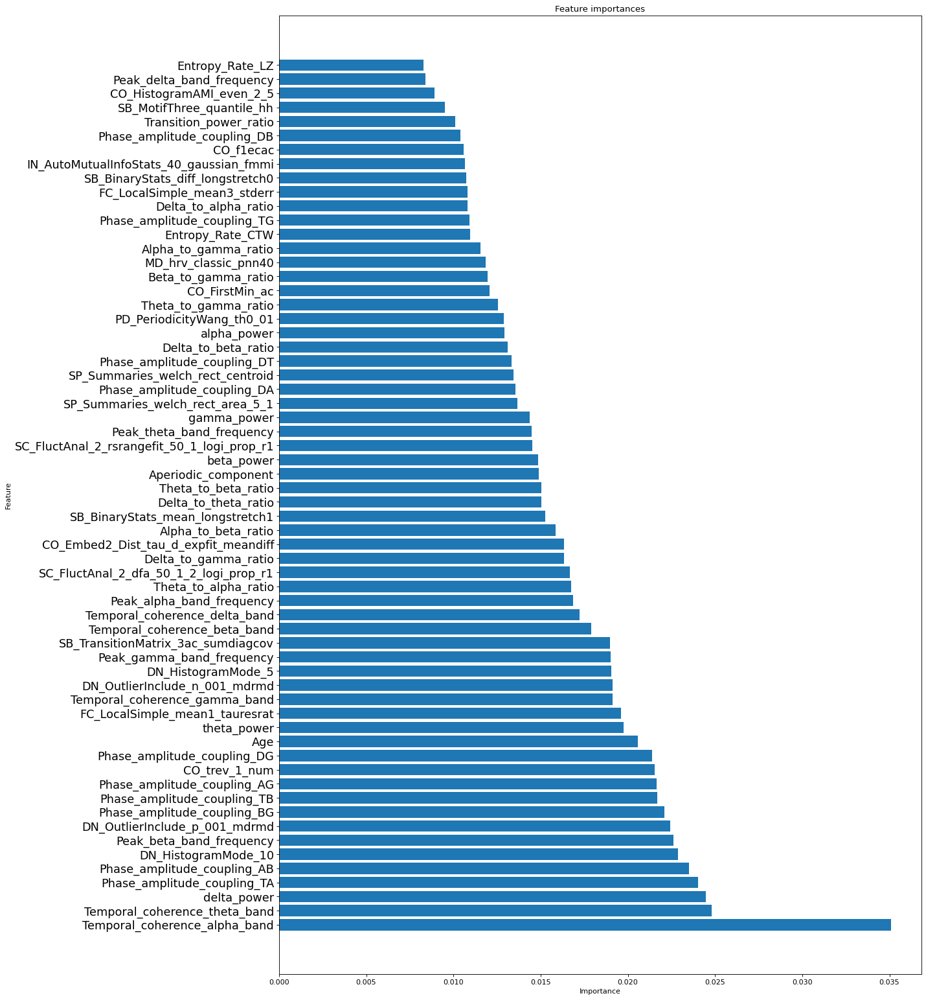

In [57]:
# Repeat the same for ifCleanOnset = 1 and Label > 15

mydata_clean_15_1 = mydata_clean[mydata_clean['Label'] > 15]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_15_1 = mydata_clean_15_1.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_15_1 = mydata_clean_15_1['Label']

# Split the data into training and testing sets

X_train_clean_15_1, X_test_clean_15_1, y_train_clean_15_1, y_test_clean_15_1 = train_test_split(X_clean_15_1, y_clean_15_1, test_size=0.2)

# Create a random forest Regressor

rf_clean_15_1 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_15_1_cv = cross_val_predict(rf_clean_15_1, X_train_clean_15_1, y_train_clean_15_1, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1, mse_clean_15_1, rmse_clean_15_1, r2_clean_15_1 = evaluate_performance_train(rf_clean_15_1, X_train_clean_15_1, y_train_clean_15_1, predictions_clean_15_1_cv)

# Plot the feature importances

rf_clean_15_1.fit(X_train_clean_15_1, y_train_clean_15_1)

importances_clean_15_1, indices_clean_15_1, names_clean_15_1 = plot_feature_importances(rf_clean_15_1, X_train_clean_15_1)



Mean Absolute Error: 1.74
Accuracy: 91.63 %.
Mean Squared Error: 6.45
Root Mean Squared Error: 2.54
R2: 0.63


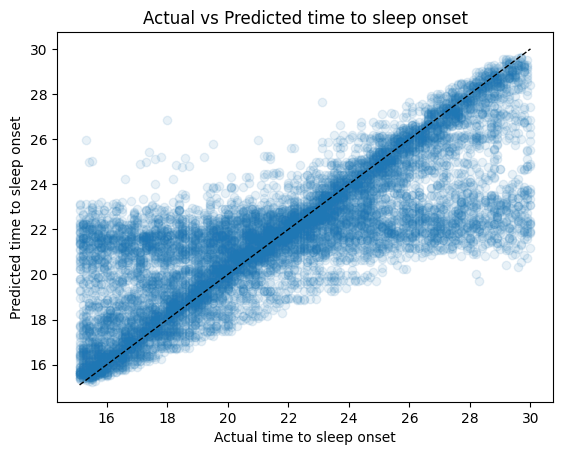

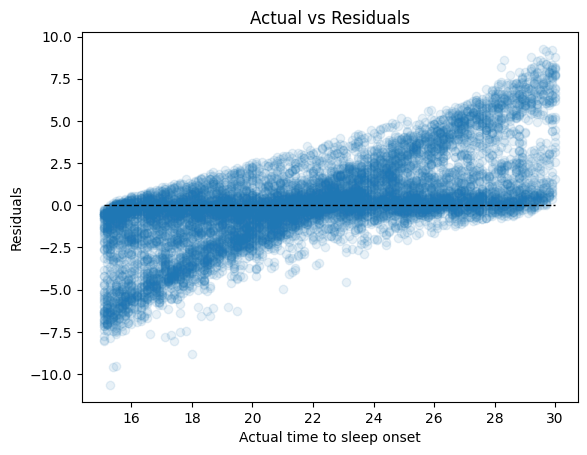

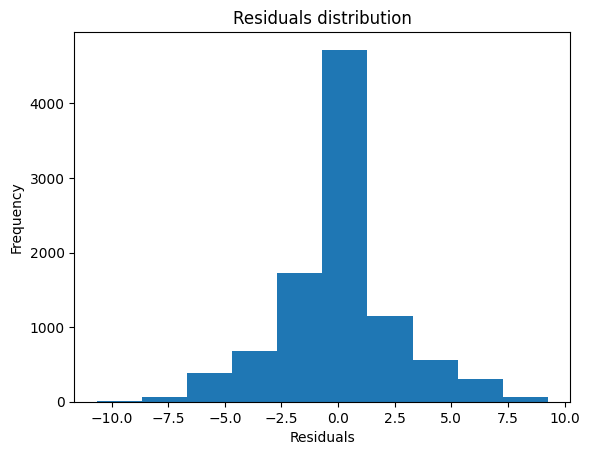

In [58]:
# Evaluate the performance of the model on the test data

predictions_clean_15_1, errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1  = evaluate_performance_test(rf_clean_15_1, X_test_clean_15_1, y_test_clean_15_1)

In [59]:
import pickle
# save the models to disk

# pickle the models
pickle.dump(rf_clean_15, open('rf_clean_15.sav', 'wb'))
pickle.dump(rf_clean_10, open('rf_clean_10.sav', 'wb'))
pickle.dump(rf_clean_15_1, open('rf_clean_15_1.sav', 'wb'))
pickle.dump(rf, open('rf.sav', 'wb'))
pickle.dump(rf_clean, open('rf_clean.sav', 'wb'))


## Random Forest: Performing analysis to predict test subjects from train subjects ##

In [60]:
# Identify how many unique subjects are in the dataset

mydata['Sbj_ID'].nunique()


668

In [61]:
# Identify how many unique subjects are in the dataset with clean onset

mydata_clean['Sbj_ID'].nunique()

494

In [62]:
import random
from sklearn.utils import shuffle

In [82]:
# Try in on all data 

unique_subjects = mydata['Sbj_ID'].unique()

# Split it into 20% for testing and 80% for training 

# define the size of the test set 

test_size = 0.2

# define the size of the training set

train_size = 0.8

# define the number of subjects in the test set

test_size_subjects = int(test_size * len(unique_subjects))

# Select the unique subjects for the test set

test_subjects = random.sample(list(unique_subjects), test_size_subjects)

# Select the unique subjects for the training set
train_subjects = [x for x in unique_subjects if x not in test_subjects]

# Create the test and training sets
test_set = mydata[mydata['Sbj_ID'].isin(test_subjects)]
train_set = mydata[mydata['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train = train_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_train = train_set['Label']
X_test = test_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_test = test_set['Label']

# Create a random forest Regressor
rf = RandomForestRegressor(n_estimators = 300)
rf.fit(X_train, y_train)

# Predict the labels for the test set
predictions = rf.predict(X_test)





ValueError: operands could not be broadcast together with shapes (127657,) (32823,) 

Mean Absolute Error: 6.25
Accuracy: -89.7 %.
Mean Squared Error: 57.61
Root Mean Squared Error: 7.59
R2: 0.16


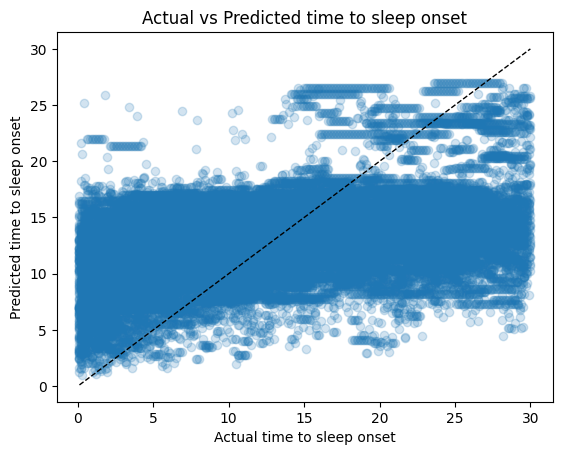

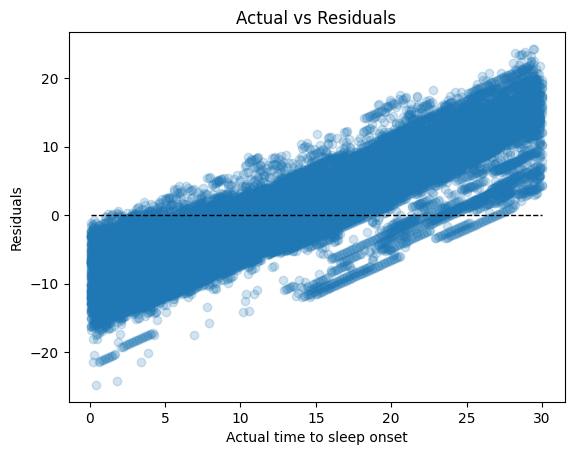

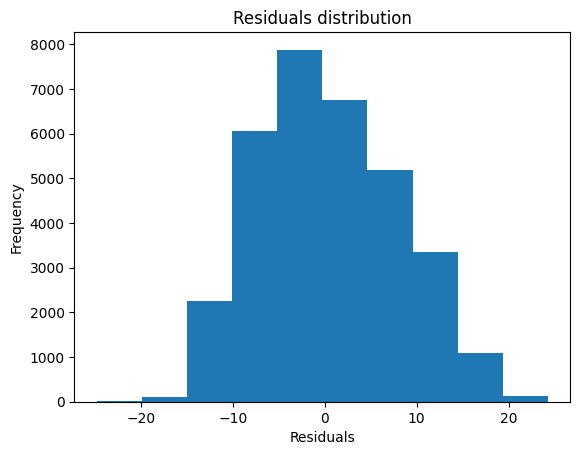

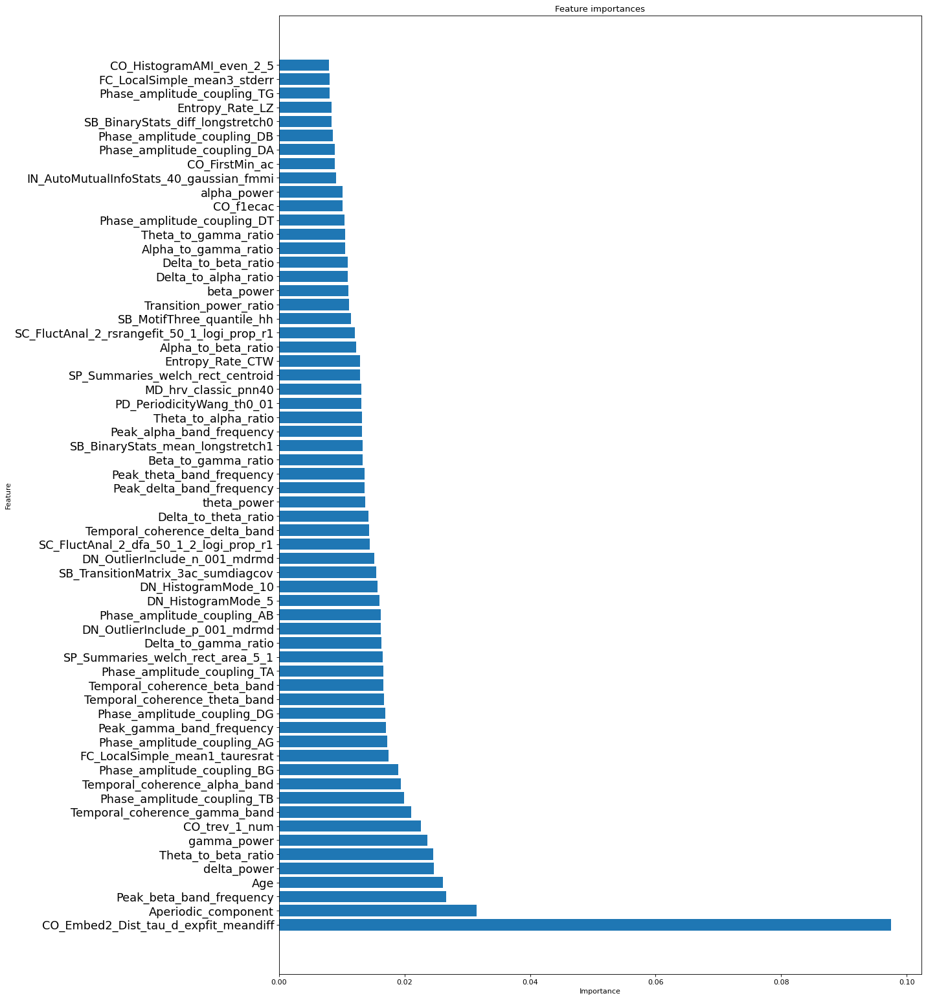

In [83]:

# Evaluate the performance of the model on the test data
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_test, y_test, predictions)

importances, indices, names = plot_feature_importances(rf, X_train)

Mean Absolute Error: 6.6
Accuracy: -102.11 %.
Mean Squared Error: 62.67
Root Mean Squared Error: 7.92
R2: 0.08


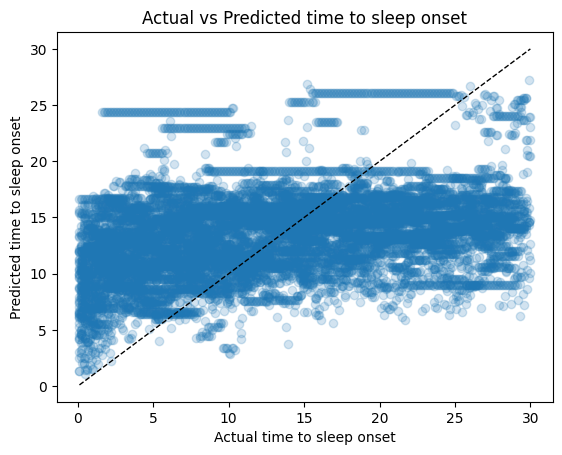

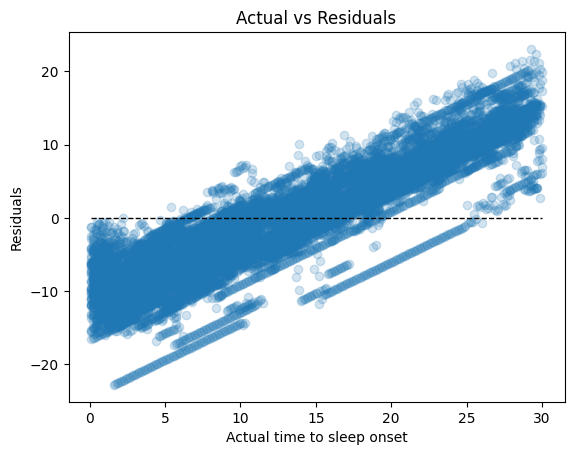

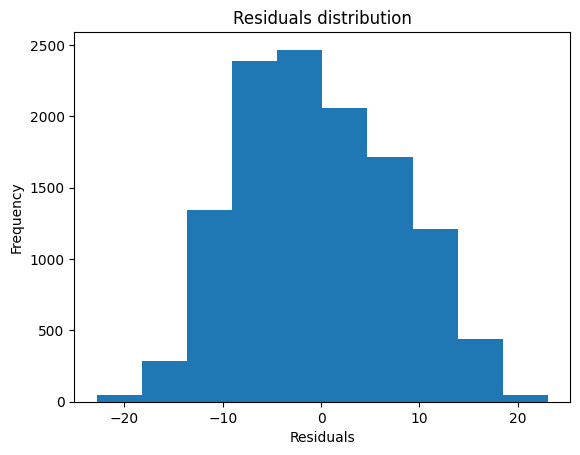

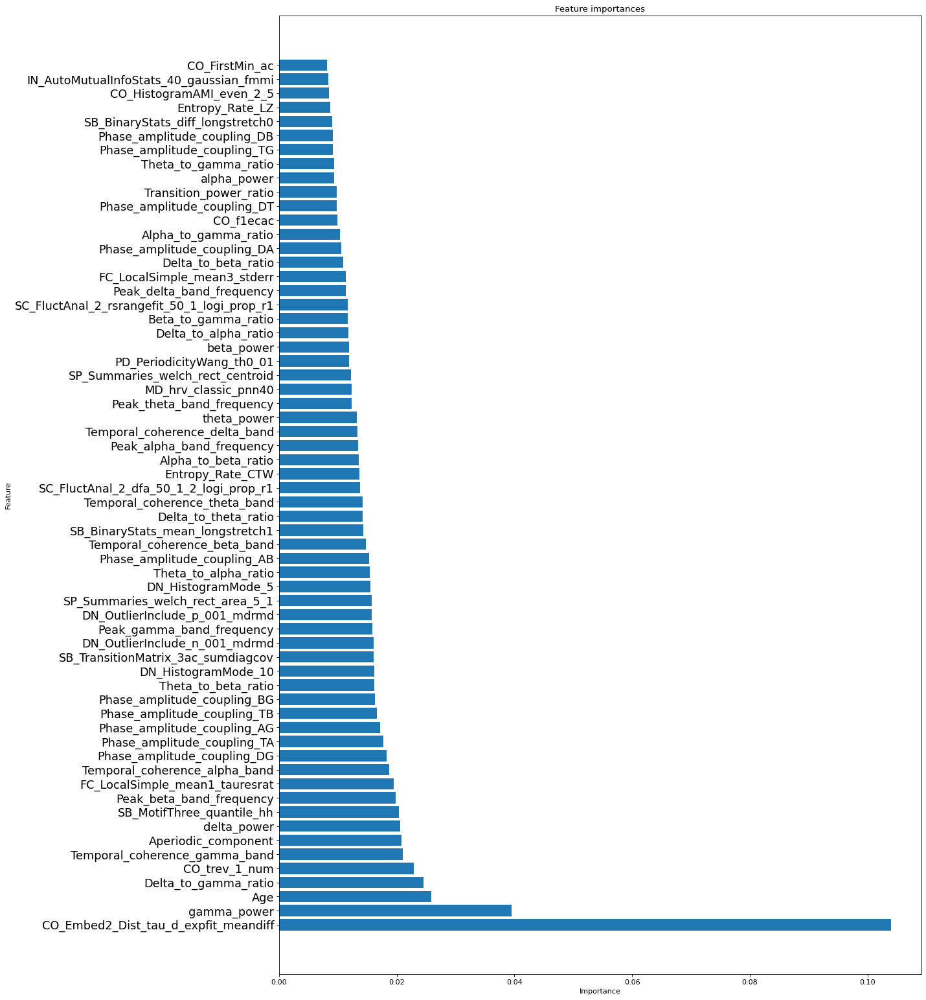

In [63]:
# choose 3 subjects to test the model and the rest to train it

# Create a list of the unique subjects

unique_subjects = mydata_clean['Sbj_ID'].unique()

# Shuffle the list of unique subjects

random.shuffle(unique_subjects)

# Choose 20 subjects to test the model

test_subjects = unique_subjects[0:50]

# Create a dataframe with the rest of the subjects to train the model

train_subjects = unique_subjects[50:]

# Create a dataframe with the test subjects

test_data = mydata_clean[mydata_clean['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data = mydata_clean[mydata_clean['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train = train_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train = train_data['Label']

X_test = test_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test = test_data['Label']

# Shuffle the data

#X_train, y_train = shuffle(X_train, y_train, random_state=0)

# Create a random forest Regressor

rf_clean = RandomForestRegressor(n_estimators=300)

rf_clean.fit(X_train, y_train)

# Predict the test data

predictions = rf.predict(X_test)

# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_test, y_test, predictions)

# Plot the feature importances

importances, indices, names = plot_feature_importances(rf, X_train)






Mean Absolute Error: 3.36
Accuracy: -63.67 %.
Mean Squared Error: 15.95
Root Mean Squared Error: 3.99
R2: 0.13


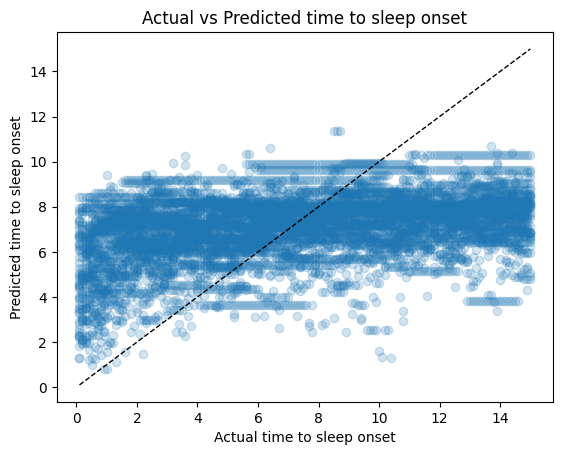

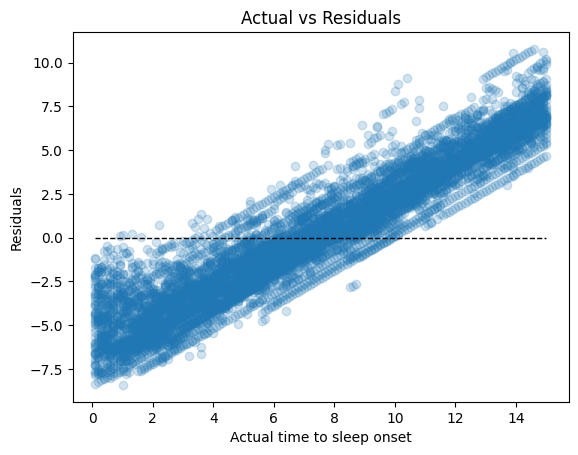

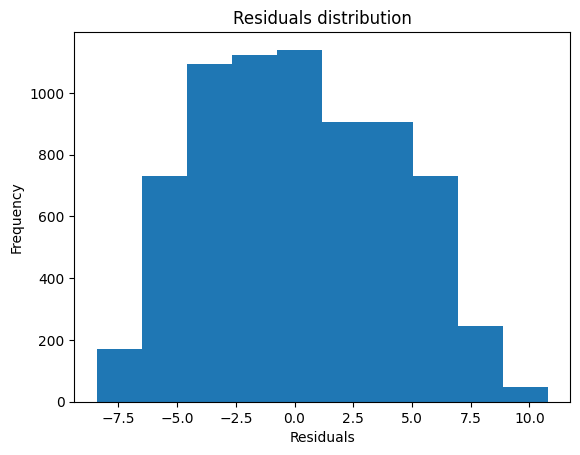

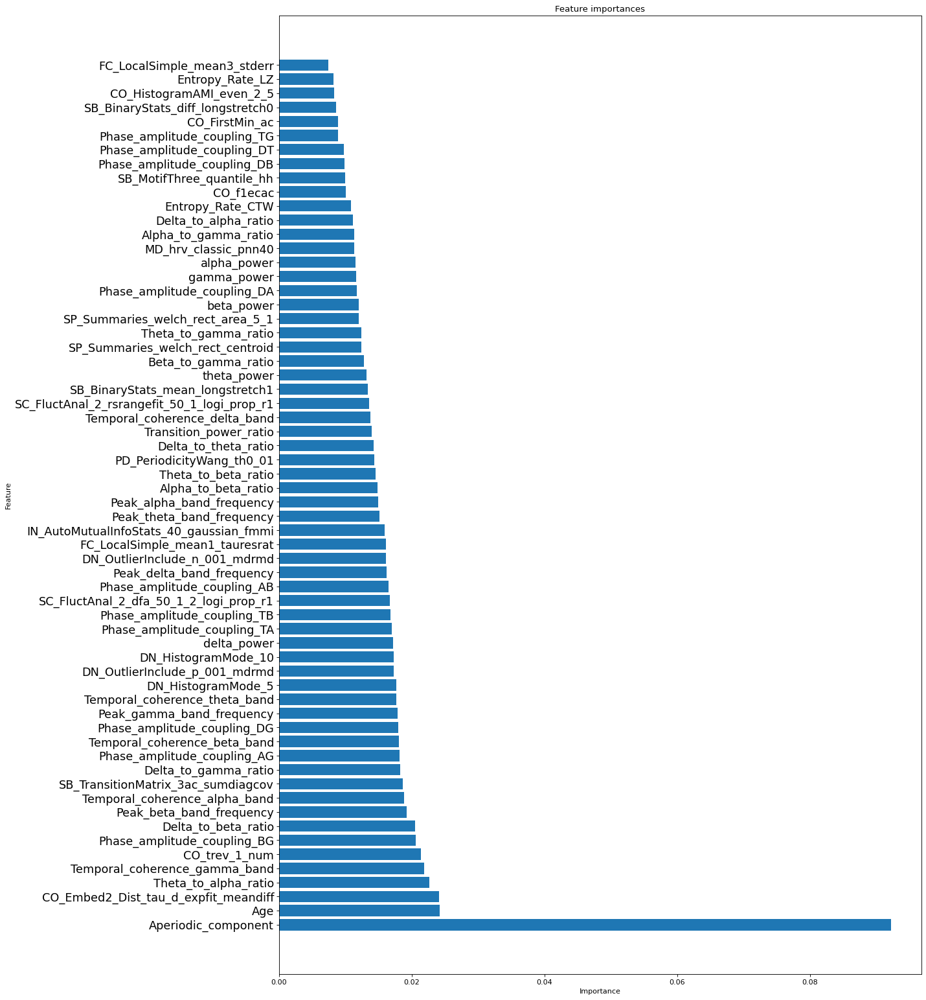

In [64]:
# Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15)

# Create a dataframe with the test subjects

test_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_15 = train_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_15 = train_data_15['Label']

X_test_15 = test_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_15 = test_data_15['Label']

# Shuffle the data

#X_train_15, y_train_15 = shuffle(X_train_15, y_train_15, random_state=0)

# Create a random forest Regressor

rf_15 = RandomForestRegressor(n_estimators=150, )

rf_15.fit(X_train_15, y_train_15)

# Predict the test data

predictions_15 = rf_15.predict(X_test_15)

# evaluate the predictions made during cross-validation

errors_15, mape_15, accuracy_15, residuals_15, mse_15, rmse_15, r2_15 = evaluate_performance_train(rf_15, X_test_15, y_test_15, predictions_15)

# Plot the feature importances

importances_15, indices_15, names_15 = plot_feature_importances(rf_15, X_train_15)






Mean Absolute Error: 2.33
Accuracy: -51.39 %.
Mean Squared Error: 7.52
Root Mean Squared Error: 2.74
R2: 0.09


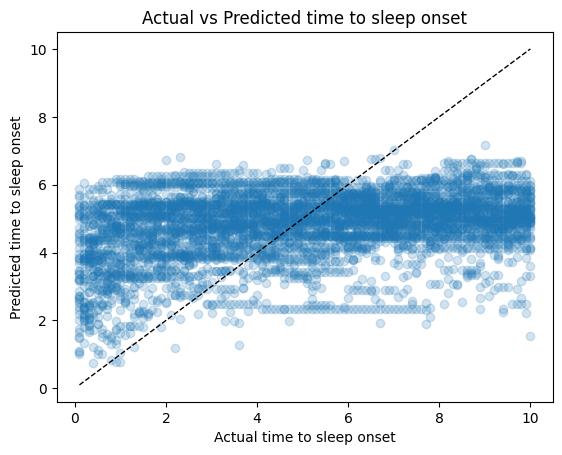

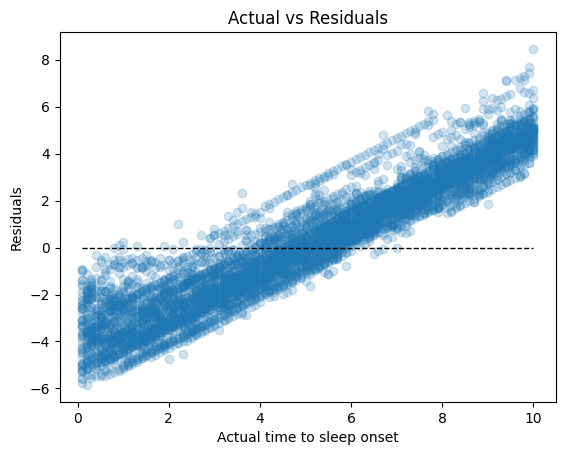

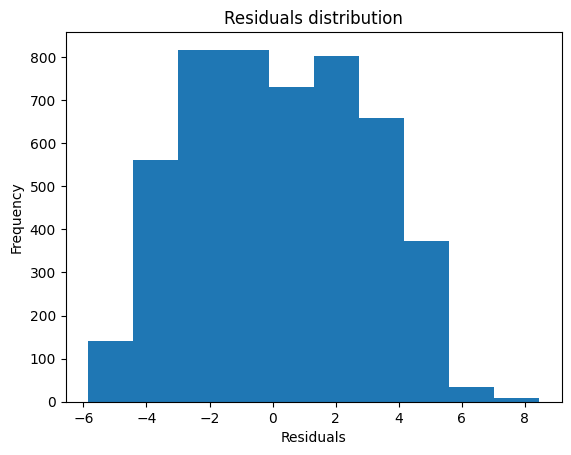

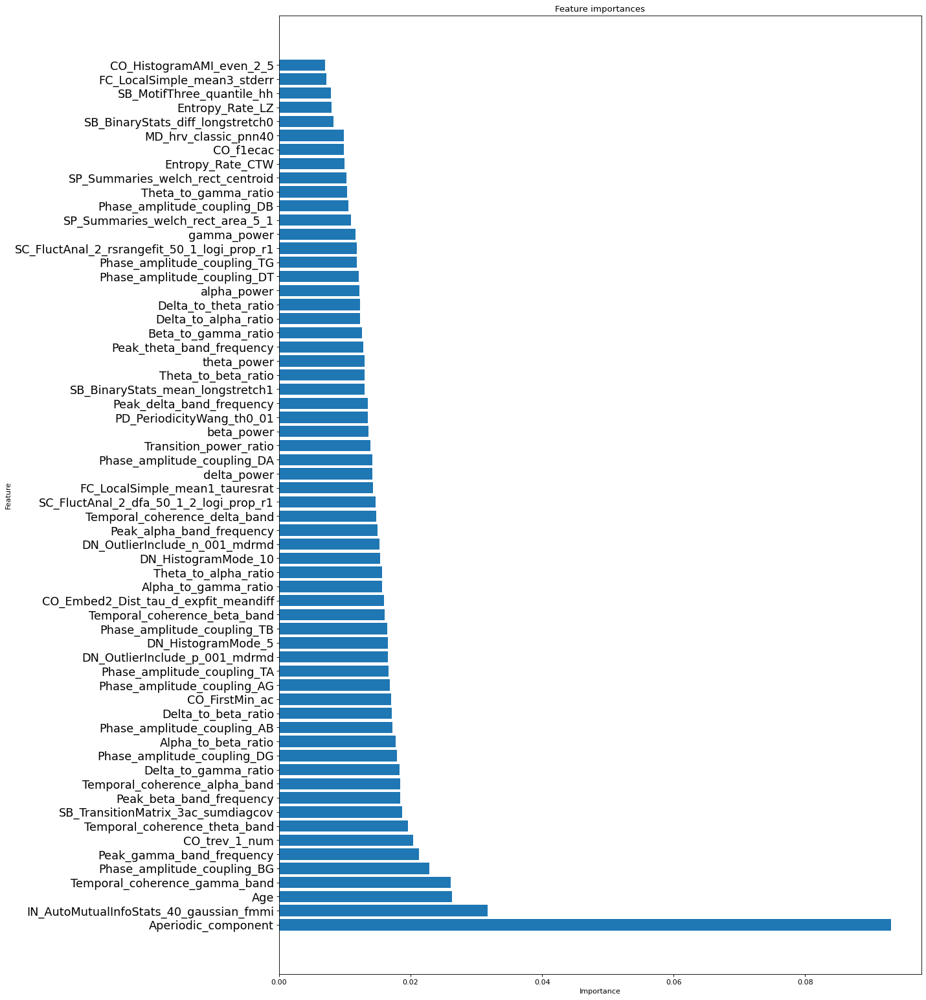

In [65]:
# Repeat the task on the clean data with no longer than 10 minutes before the onset (Label <=10)

# Create a dataframe with the test subjects


test_data_10 = mydata_clean_10[mydata_clean_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_clean_10[mydata_clean_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)


X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_10 = train_data_10['Label']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_10 = test_data_10['Label']

# Shuffle the data

#X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest Regressor

rf_10 = RandomForestRegressor(n_estimators=150)

rf_10.fit(X_train_10, y_train_10)

# Predict the test data

predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during cross-validation

errors_10, mape_10, accuracy_10, residuals_10, mse_10, rmse_10, r2_10 = evaluate_performance_train(rf_10, X_test_10, y_test_10, predictions_10)

# Plot the feature importances

importances_10, indices_10, names_10 = plot_feature_importances(rf_10, X_train_10)



# Try scaling the data


In [66]:
# Create a dataframe with the test subjects from mydata
# drop nan and inf values

mydata = mydata.dropna()

test_data_mydata = mydata[mydata['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects from mydata

train_data_mydata = mydata[mydata['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_mydata = train_data_mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_mydata = train_data_mydata['Label']

X_test_mydata = test_data_mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_mydata = test_data_mydata['Label']

# Shuffle the data

X_train_mydata, y_train_mydata = shuffle(X_train_mydata, y_train_mydata, random_state=0)




Mean Absolute Error: 2.93
Accuracy: -4.74 %.
Mean Squared Error: 21.18
Root Mean Squared Error: 4.6
R2: 0.69


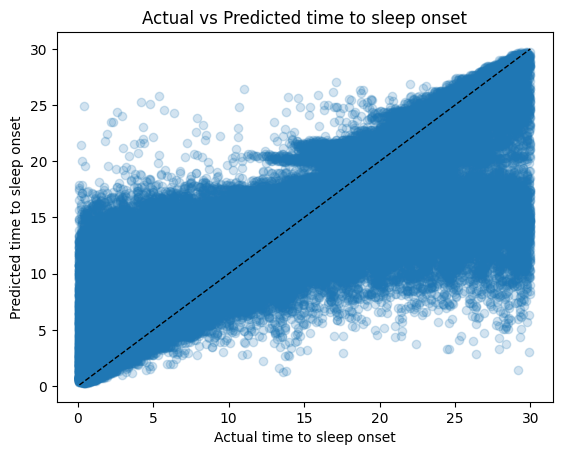

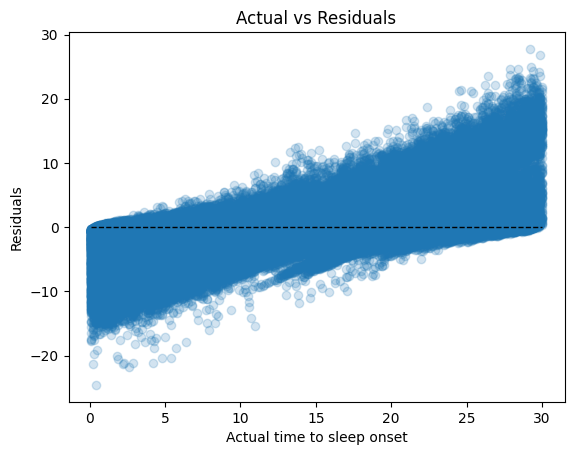

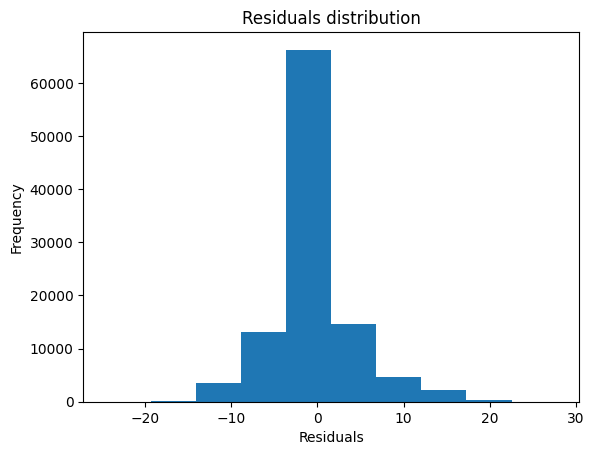

In [67]:
# perfrom min-max scaling on the data

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()



X_train_scaled = scaler.fit_transform(X_train_mydata)

X_test_scaled = scaler.transform(X_test_mydata)

# Create a random forest Regressor

rf_scaled = RandomForestRegressor(n_estimators=150)

# Cross-validate the model

predictions_scaled = cross_val_predict(rf_scaled, X_train_scaled, y_train_mydata, cv=10)

# evaluate the predictions made during cross-validation

errors_scaled, mape_scaled, accuracy_scaled, residuals_scaled, mse_scaled, rmse_scaled, r2_scaled = evaluate_performance_train(rf_scaled, X_train_scaled, y_train_mydata, predictions_scaled)




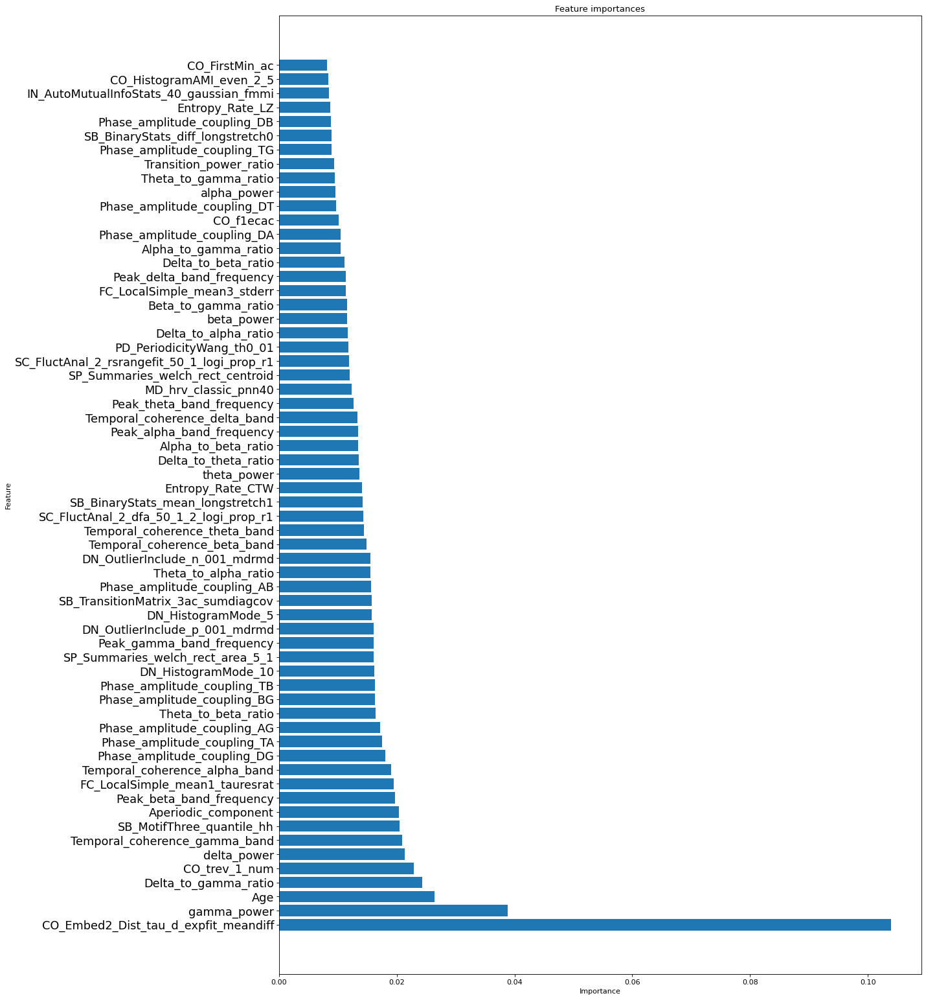

Mean Absolute Error: 6.56
Accuracy: -102.32 %.
Mean Squared Error: 62.1
Root Mean Squared Error: 7.88
R2: 0.09


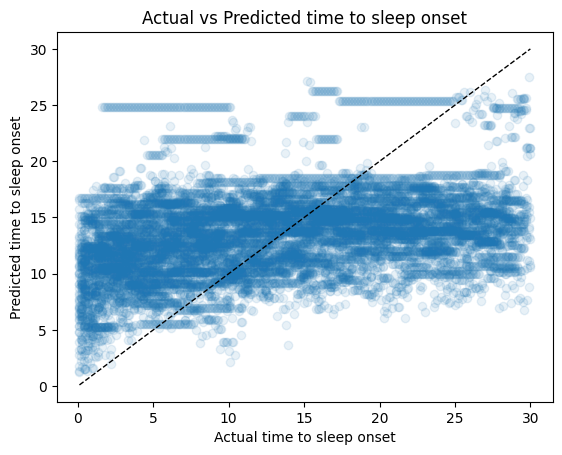

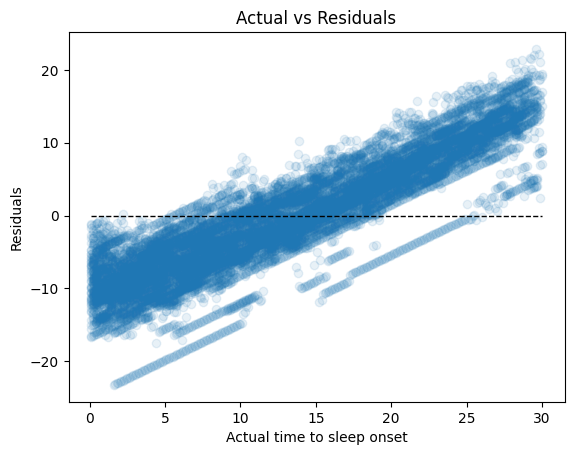

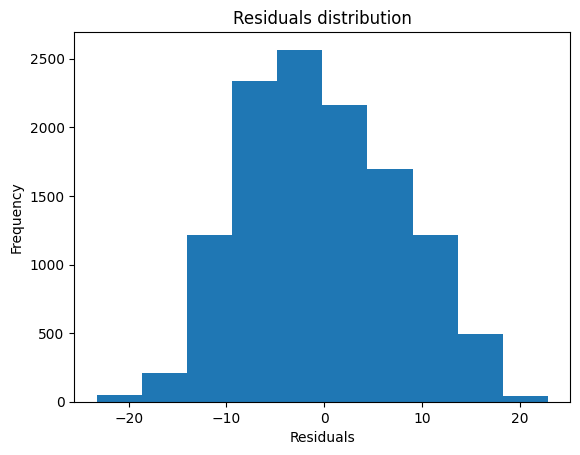

In [68]:
# Fit the model to the training data
rf_scaled.fit(X_train_scaled, y_train_mydata)

# Plot the feature importances

importances_scaled, indices_scaled, names_scaled = plot_feature_importances(rf_scaled, X_train)

# evaluate the predictions made during test
errors_scaled, mape_scaled, accuracy_scaled, residuals_scaled, predictions_scaled = evaluate_performance_test(rf_scaled, X_test_scaled, y_test_mydata)

# Random Forest Classification: Performing analysis to predict test subjects from train subjects

In [69]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [70]:
# take mydata and copy into  a new dataframe. in the new dataframe, switch the labels to 5 minute bins (classes '5 minutes before onset, 10 minutes before onset, 15 minutes before onset')
# and then run the model on the new dataframe

# create a new dataframe

mydata_5 = mydata.copy()

# delete rows with NaN values

mydata_5 = mydata_5.dropna()

# create a new column with the new labels

mydata_5['Label_5'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else (10 if x <= 10 else (15 if x <= 15 else (20 if x <=20 else 25))))

# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_5 = train_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_train_5 = train_data_5['Label_5']

X_test_5 = test_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_test_5 = test_data_5['Label_5']

# Shuffle the data

#X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)



Accuracy: 0.3258564126039521


Text(0.5, 23.52222222222222, 'Predicted label')

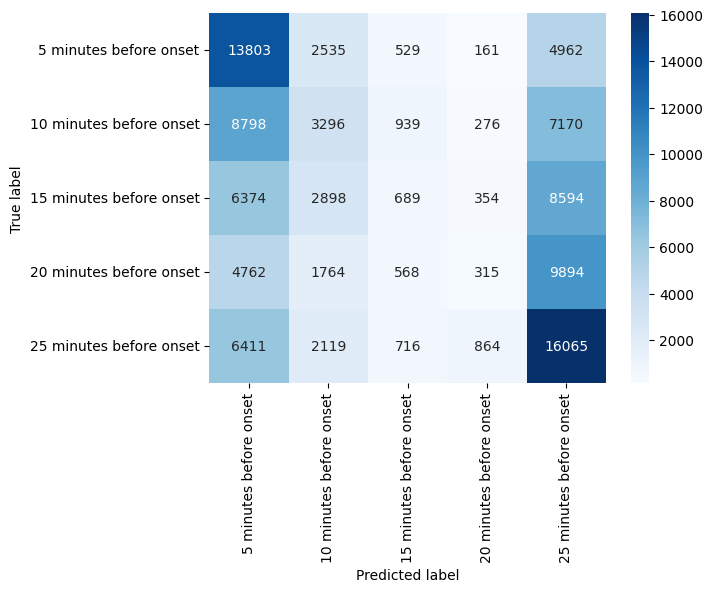

In [71]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)
print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_5, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')







In [72]:
# plot the classification report

class_report = classification_report(y_train_5, predictions_cv)
print(class_report)




              precision    recall  f1-score   support

           5       0.34      0.63      0.44     21990
          10       0.26      0.16      0.20     20479
          15       0.20      0.04      0.06     18909
          20       0.16      0.02      0.03     17303
          25       0.34      0.61      0.44     26175

    accuracy                           0.33    104856
   macro avg       0.26      0.29      0.24    104856
weighted avg       0.27      0.33      0.26    104856



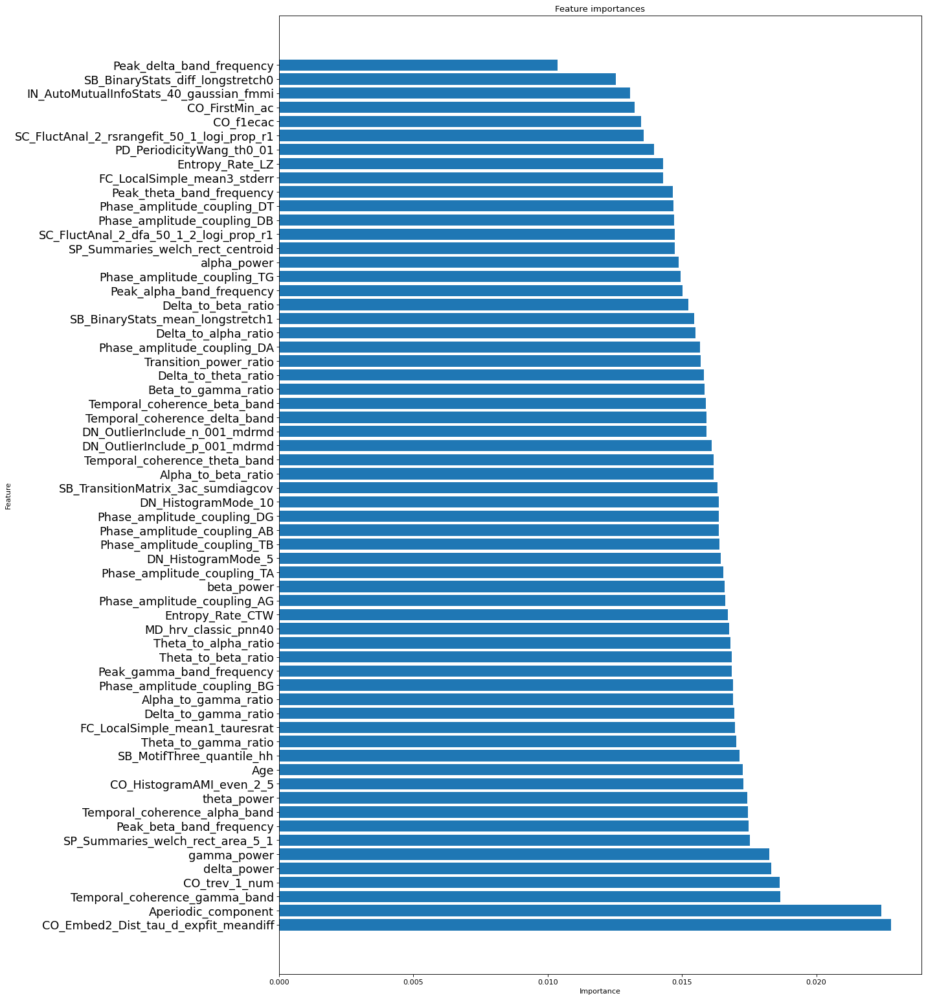

In [73]:
# Plot the feature importances
rf_5.fit(X_train_5, y_train_5)
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)

In [74]:

# Predict the test data

predictions_5 = rf_5.predict(X_test_5)

#evaluate the predictions made during test 

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')




Accuracy: 0.3218007503126303


In [75]:
# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

              precision    recall  f1-score   support

           5       0.36      0.55      0.44      2500
          10       0.26      0.16      0.20      2440
          15       0.23      0.04      0.06      2154
          20       0.20      0.03      0.05      1936
          25       0.32      0.66      0.43      2965

    accuracy                           0.32     11995
   macro avg       0.28      0.29      0.24     11995
weighted avg       0.28      0.32      0.26     11995



Text(0.5, 23.52222222222222, 'Predicted label')

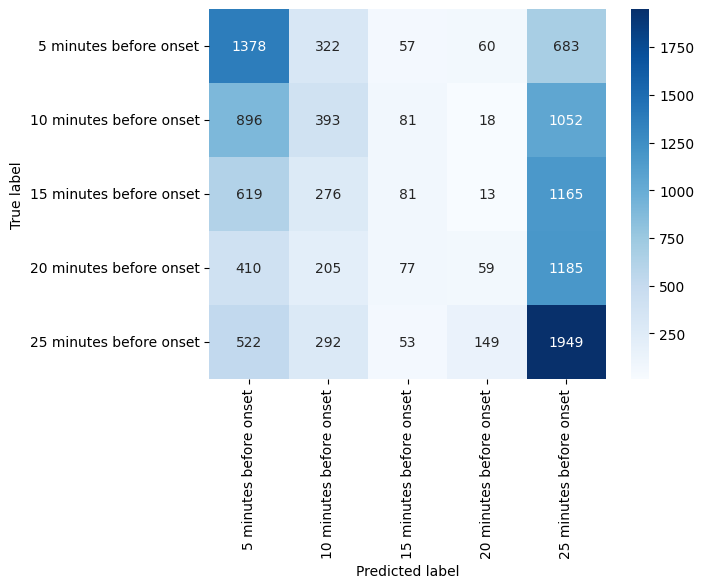

In [76]:
import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_test_5, predictions_5)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



In [77]:
#Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata.copy()

#delete rows with NaN values

mydata_10 = mydata_10.dropna()

#create a new column with the new labels

mydata_10['Label_10'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# Perform a classification task on the new dataframe

#Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

#Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

#Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_train_10 = train_data_10['Label_10']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_test_10 = test_data_10['Label_10']

#Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

#Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)




Accuracy: 0.6153948329680548


Text(0.5, 23.52222222222222, 'Predicted label')

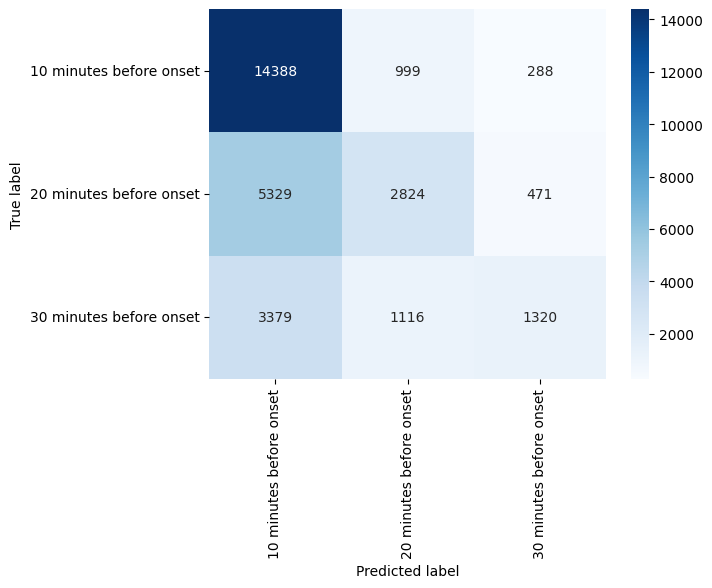

In [92]:
#evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

#plot the confusion matrix

# nclude the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')




Accuracy: 0.4558566069195498
              precision    recall  f1-score   support

          10       0.50      0.74      0.60      4940
          20       0.41      0.29      0.34      4090
          30       0.34      0.21      0.26      2965

    accuracy                           0.46     11995
   macro avg       0.42      0.41      0.40     11995
weighted avg       0.43      0.46      0.43     11995



Text(0.5, 23.52222222222222, 'Predicted label')

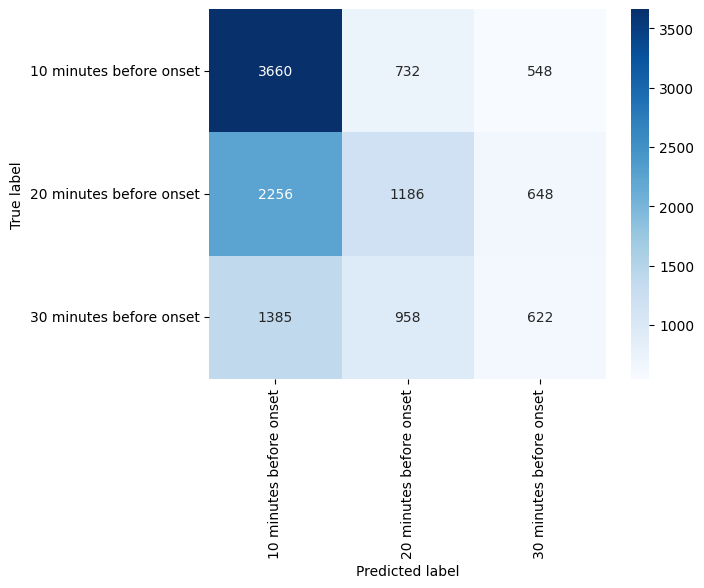

In [78]:
# try it with the test data 
rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)

print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



In [79]:
# get train and test subjects from sbj_ID column in mydata(uniques)


participants = mydata['Sbj_ID'].unique()

# randomly select 80% of the participants for training and 20% for testing

train_subjects = np.random.choice(participants, int(len(participants)*0.8), replace=False)

test_subjects = [x for x in participants if x not in train_subjects]







In [95]:
train_subjects, test_subjects 

(array([4229,  518, 1476, 3603,  800, 6756, 2083,  399, 1901, 3216, 6811,
        1847, 2798, 2119, 2276, 1769, 1418, 3133, 1256, 1890, 5887, 6252,
         937,  490,  933, 5513, 3839,  169,  485, 2400, 3311, 4116, 2896,
        2941,  914, 4186, 5864,  193,  344, 2311, 1571, 1478, 4273, 4389,
        4474, 2969, 5274, 5599, 4592, 6549, 6695, 4190, 2084, 6132, 5662,
        4892,  159, 1876, 4171, 5876,  626, 1497, 5255, 5896, 3874, 2175,
         332, 1613, 6139, 2879, 2572, 2836, 2819, 4016, 1732,  893,  776,
        4642, 4276, 3317, 5292, 2634, 1427, 2780, 2750, 2881, 5780, 5827,
        6663, 3021, 6318, 1983, 5354, 1472, 4805, 5302, 3542, 1531, 5121,
        1212, 2265, 5654, 5463, 2216, 4367, 3399,  329, 3147, 1068, 4023,
        6279, 4715, 2988, 5958, 5182, 5939, 3492, 4228, 4295, 5801, 4038,
           6, 5606, 5551, 3375,   35, 1673, 4495,  219, 6440, 3703, 2995,
        3917, 4077,  688, 1260, 1735, 1656, 3918, 5837, 5073,  419, 3387,
        2363,  632, 5283, 1271, 5396, 

In [81]:
# Try to perfrom min-max scaling on the data per subject 

# Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata.copy()

# delete rows with NaN values

mydata_10 = mydata_10.dropna()

# create a new column with the new labels

mydata_10['Label'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# exclude biphasic_vertices_count and k_complex_count columns

#mydata_10 = mydata_10.drop(['Biphasic_vertices_count,', 'K_complex_count,', 'Monophasic_vertices_count,'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_10[mydata_10.columns[5:]] = mydata_10[mydata_10.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))


# find nan values

mydata_10.isnull().sum()



Label                               0
Sbj_ID                              0
Age                                 0
ifCleanOnset                        0
SleepStage                          0
                                   ..
SP_Summaries_welch_rect_centroid    0
FC_LocalSimple_mean3_stderr         0
Entropy_Rate_CTW                    0
Entropy_Rate_LZ                     0
Aperiodic_component                 0
Length: 66, dtype: int64

In [ ]:
# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_train_10 = train_data_10['Label']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_test_10 = test_data_10['Label']

# Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)

Accuracy: 0.6201160154687292


Text(0.5, 23.52222222222222, 'Predicted label')

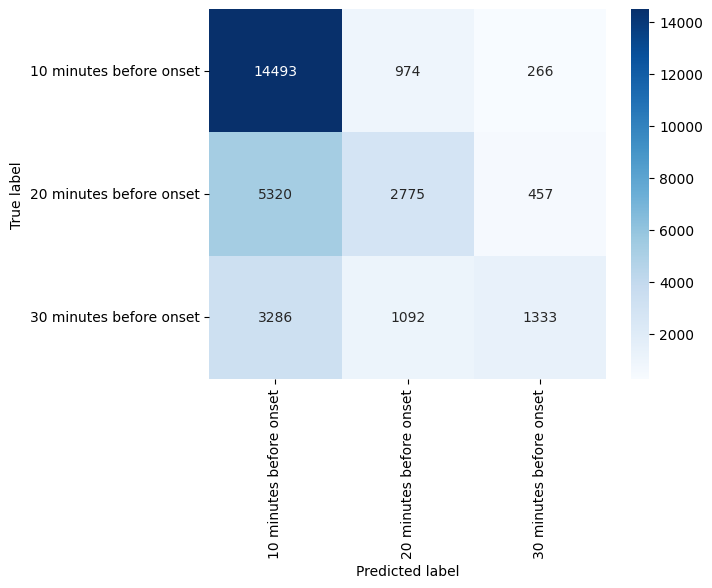

In [98]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')



Accuracy: 0.5365918803418803
              precision    recall  f1-score   support

          10       0.58      0.88      0.70      4050
          20       0.31      0.14      0.19      1974
          30       0.36      0.11      0.17      1464

    accuracy                           0.54      7488
   macro avg       0.42      0.38      0.35      7488
weighted avg       0.47      0.54      0.46      7488



Text(0.5, 23.52222222222222, 'Predicted label')

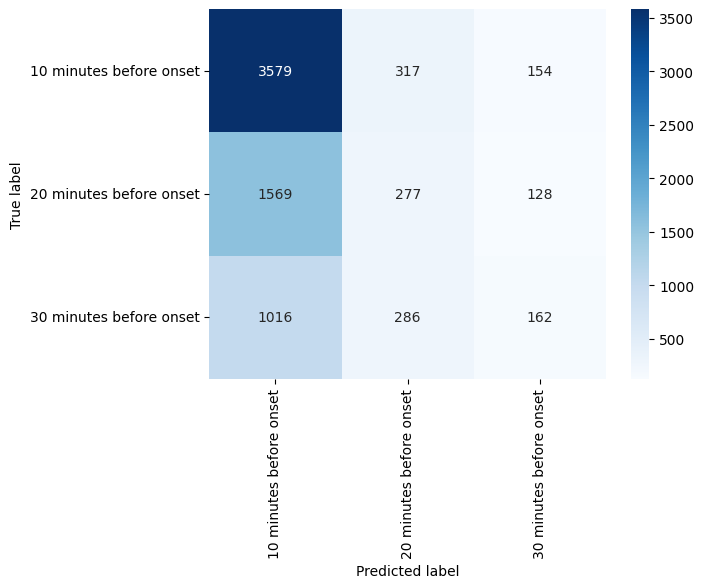

In [ ]:
# try it with the test data

rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)
print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



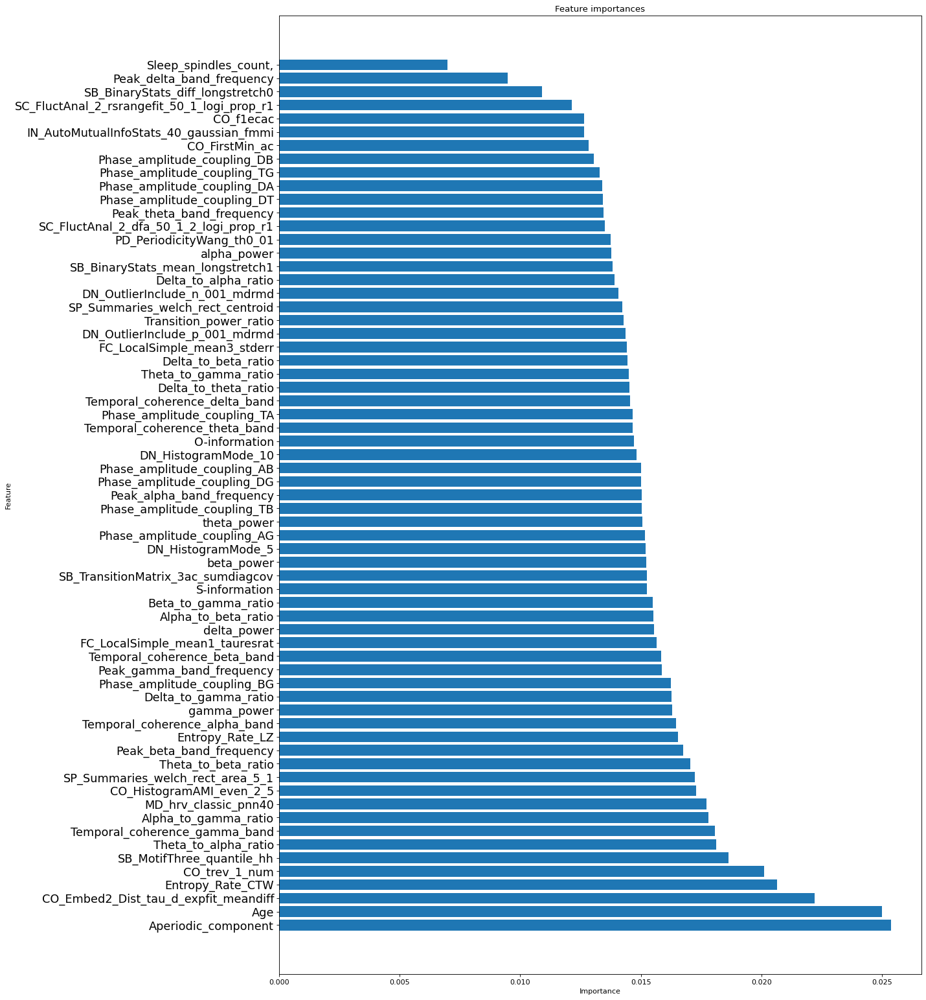

In [ ]:
# plot the feature importance

importances_cv, indices_cv, names_cv = plot_feature_importances(rf_10, X_train_10)


Accuracy: 0.7659687958394452


Text(0.5, 23.52222222222222, 'Predicted label')

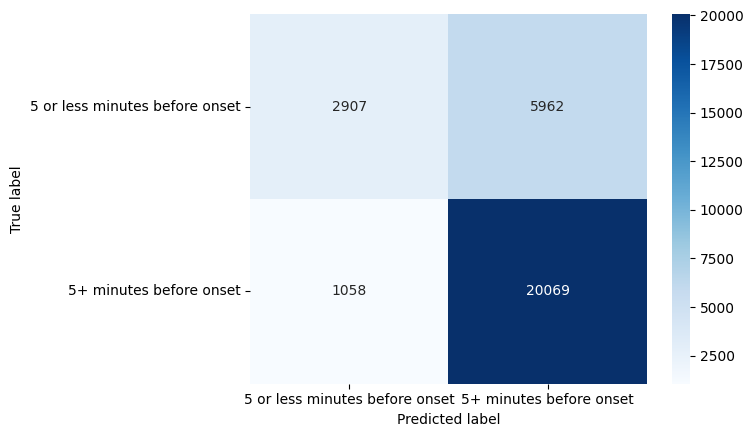

In [ ]:
# Build  new dataset with less than 5 minutes before onset and more than 5 minutes before onset

# Create a new dataframe with the labels less than 5 minutes before onset and more than 5 minutes before onset

mydata_5 = mydata.copy()

# delete rows with NaN values

mydata_5 = mydata_5.dropna()

# create a new column with the new labels

mydata_5['Label'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else 30)

# exclude biphasic_vertices_count and k_complex_count columns

mydata_5 = mydata_5.drop(['Biphasic_vertices_count,', 'K_complex_count,', 'Monophasic_vertices_count,'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_5[mydata_5.columns[5:]] = mydata_5[mydata_5.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))



# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_5 = train_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_train_5 = train_data_5['Label']

X_test_5 = test_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_test_5 = test_data_5['Label']

# Shuffle the data

X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)

# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_train_5, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')





In [102]:
# classification report

print(classification_report(y_train_5, predictions_cv))



              precision    recall  f1-score   support

           5       0.73      0.33      0.45      8869
          30       0.77      0.95      0.85     21127

    accuracy                           0.77     29996
   macro avg       0.75      0.64      0.65     29996
weighted avg       0.76      0.77      0.73     29996



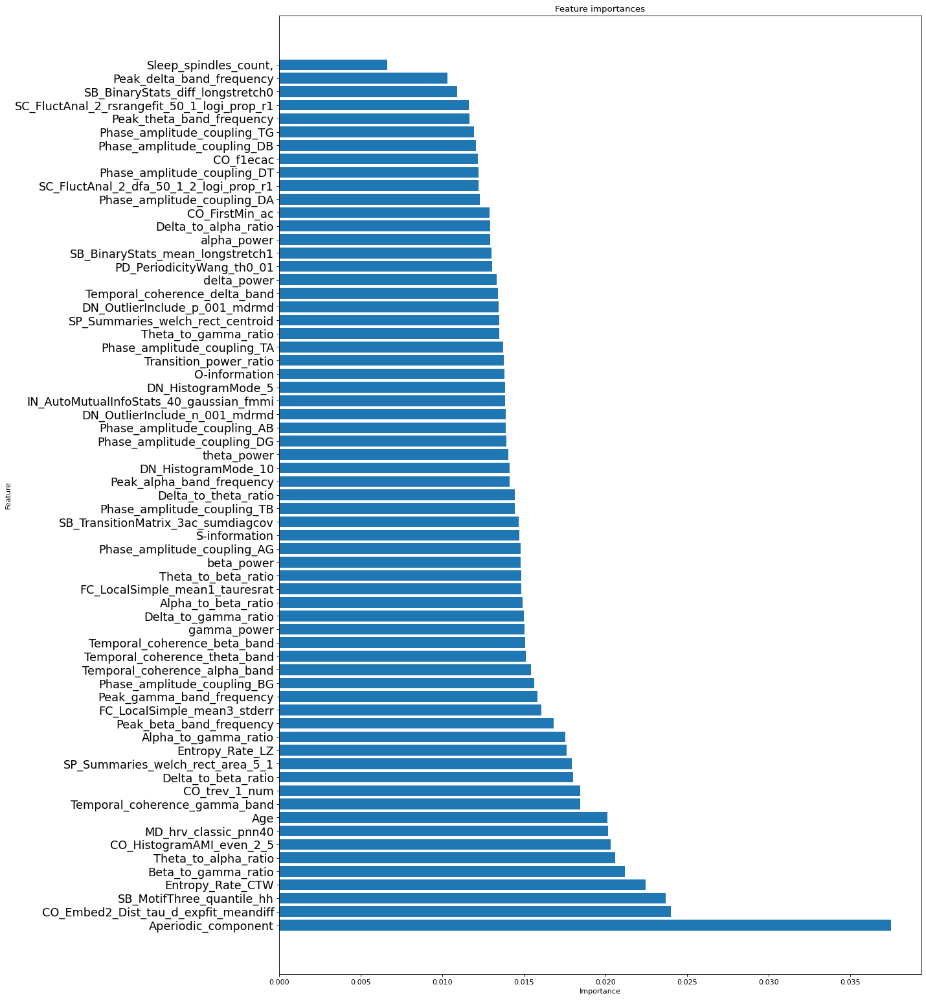

In [103]:
# fit the model with the train data

rf_5.fit(X_train_5, y_train_5)

# plot the feature importance
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)





Accuracy: 0.7268963675213675
              precision    recall  f1-score   support

           5       0.60      0.30      0.40      2266
          30       0.75      0.91      0.82      5222

    accuracy                           0.73      7488
   macro avg       0.67      0.61      0.61      7488
weighted avg       0.70      0.73      0.69      7488

              precision    recall  f1-score   support

           5       0.60      0.30      0.40      2266
          30       0.75      0.91      0.82      5222

    accuracy                           0.73      7488
   macro avg       0.67      0.61      0.61      7488
weighted avg       0.70      0.73      0.69      7488



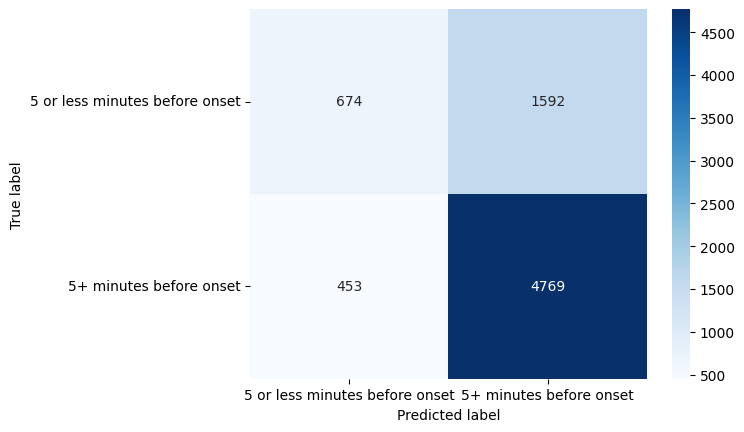

In [104]:
# predict the test data

predictions_5 = rf_5.predict(X_test_5)

# evaluate the predictions made during test

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')

# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_5, predictions_5)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],      
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')


# classification report

print(classification_report(y_test_5, predictions_5))


# Gradient Boosting Regression

In [69]:
# Repeat all of the above experiments with gradient boosting regressor
from sklearn.ensemble import GradientBoostingRegressor

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X = mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y = mydata['Label']

# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions

predictions = cross_val_predict(gbr, X_train, y_train, cv=10)

Mean Absolute Error: 6.05
Accuracy: -104.82 %.
Mean Squared Error: 54.45
Root Mean Squared Error: 7.38
R2: 0.22


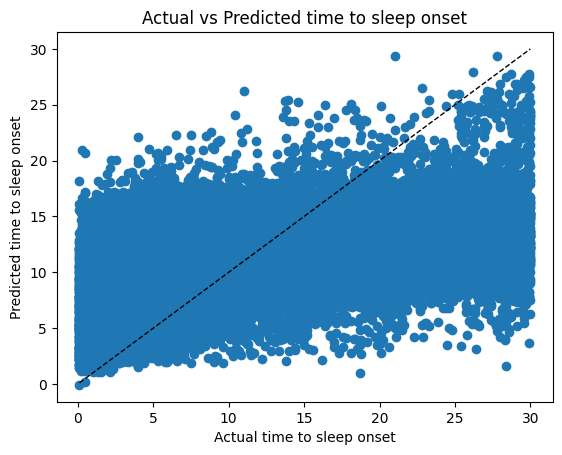

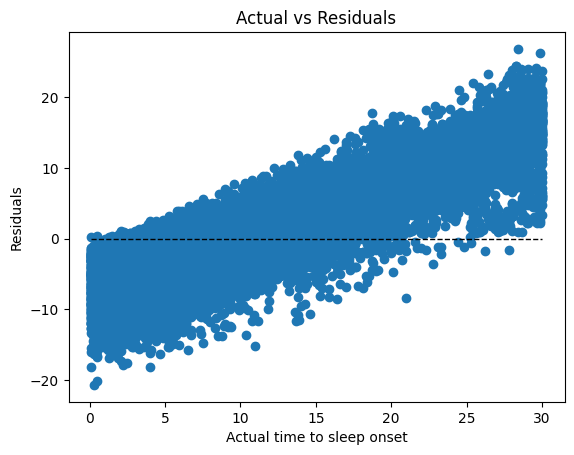

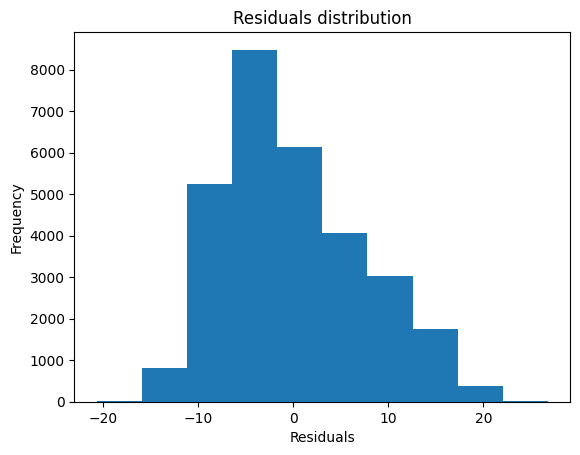

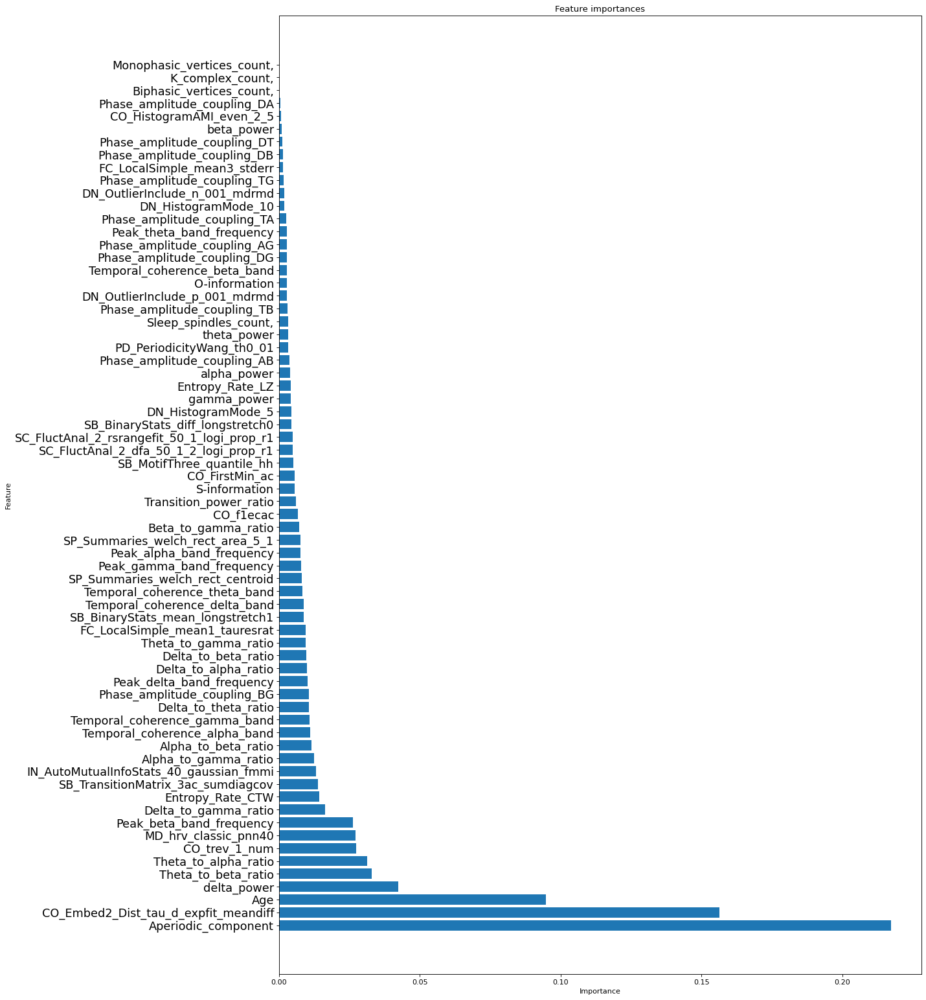

In [70]:
# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(gbr, X_train, y_train, predictions)


# Plot the feature importances
gbr.fit(X_train, y_train)
importances, indices, names = plot_feature_importances(gbr, X_train)

Mean Absolute Error: 5.99
Accuracy: -106.67 %.
Mean Squared Error: 53.64
Root Mean Squared Error: 7.32
R2: 0.21


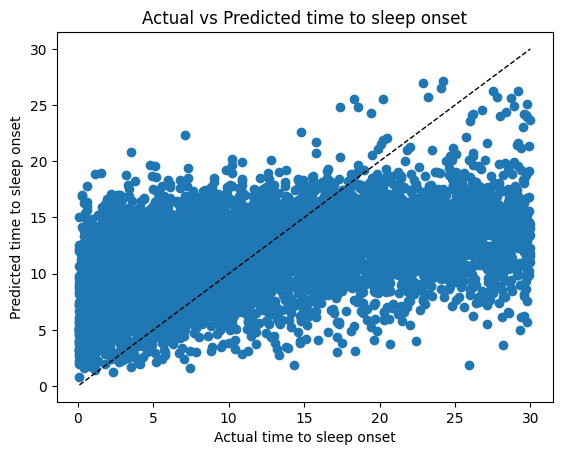

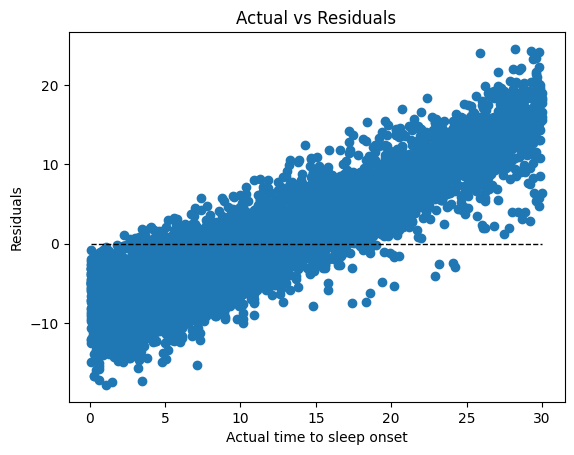

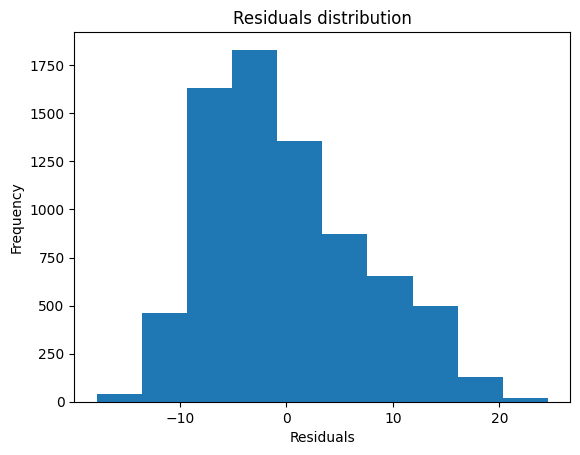

In [71]:
# Evaluate the performance on the test set

predictions_test, errors_test, mape_test, accuracy_test, residuals_test = evaluate_performance_test(gbr, X_test, y_test)


Mean Absolute Error: 5.97
Accuracy: -112.54 %.
Mean Squared Error: 53.9
Root Mean Squared Error: 7.34
R2: 0.25


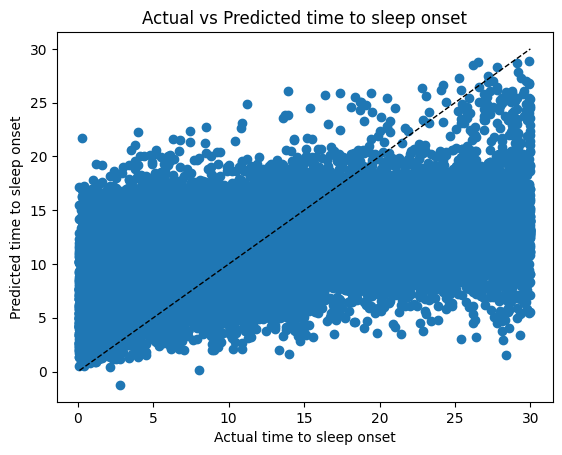

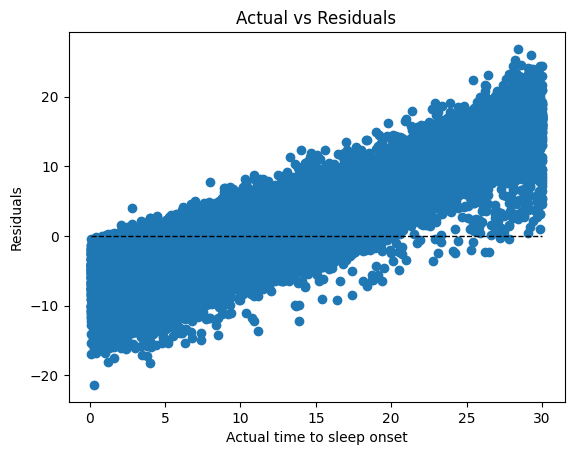

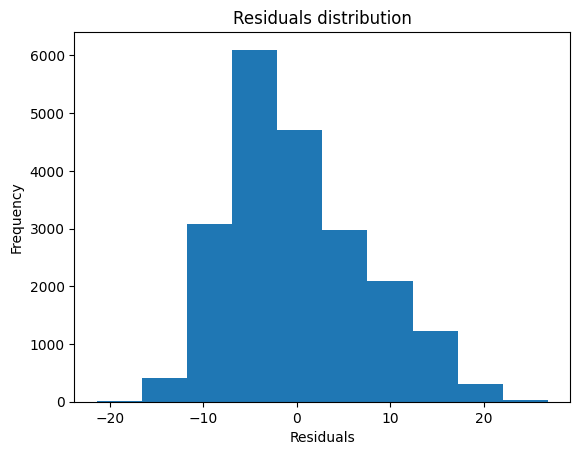

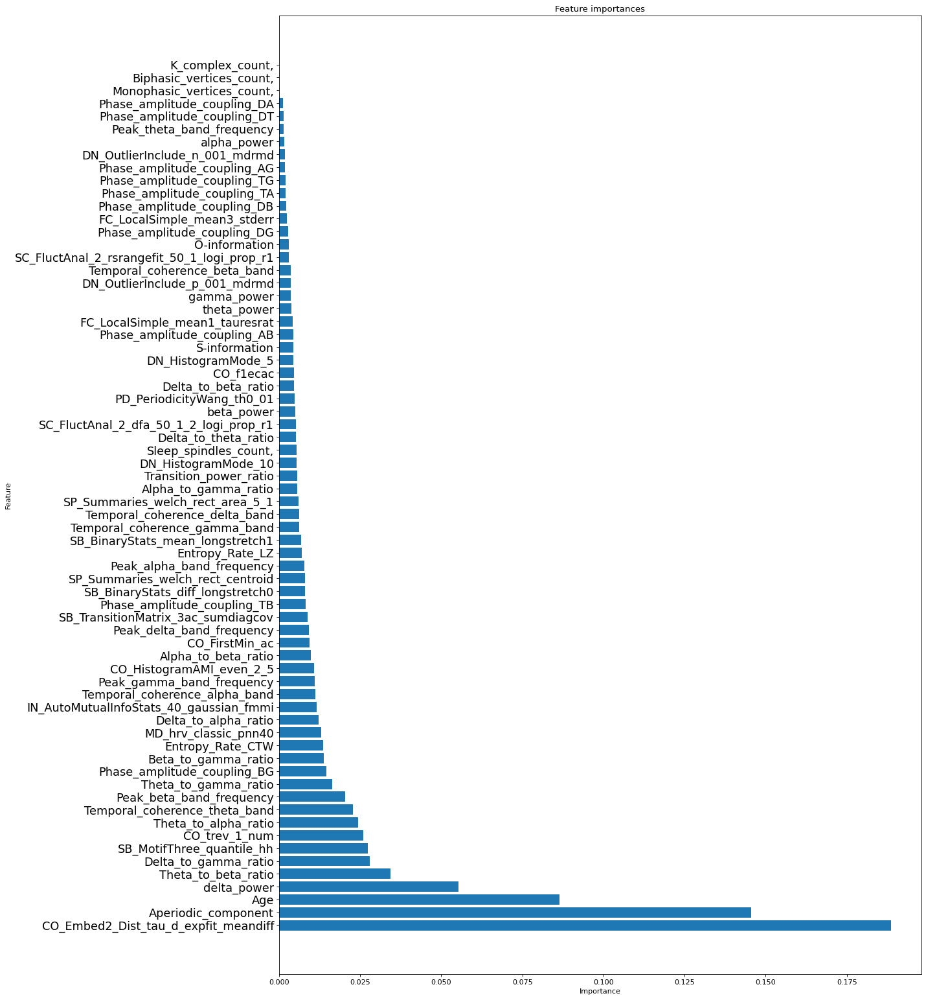

In [72]:
# Create a new dataset only with ifCleanOnset = 1
mydata_clean = mydata[mydata['ifCleanOnset'] == 1]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)
X_clean = mydata_clean.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean = mydata_clean['Label']

# Split the data into training and testing sets
X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X_clean, y_clean, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr_clean = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_clean = cross_val_predict(gbr_clean, X_train_clean, y_train_clean, cv=10)

# evaluate the predictions made during cross-validation
errors_clean, mape_clean, accuracy_clean, residuals_clean, mse_clean, rmse_clean, r2_clean = evaluate_performance_train(gbr_clean, X_train_clean, y_train_clean, predictions_clean)

# Plot the feature importances
gbr_clean.fit(X_train_clean, y_train_clean)
importances_clean, indices_clean, names_clean = plot_feature_importances(gbr_clean, X_train_clean)



Mean Absolute Error: 6.0
Accuracy: -111.82 %.
Mean Squared Error: 54.34
Root Mean Squared Error: 7.37
R2: 0.22


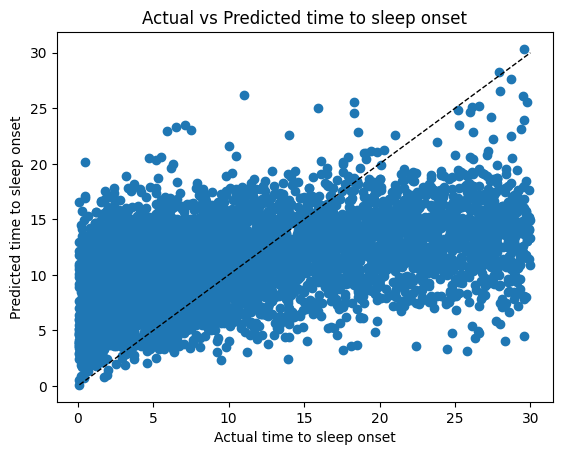

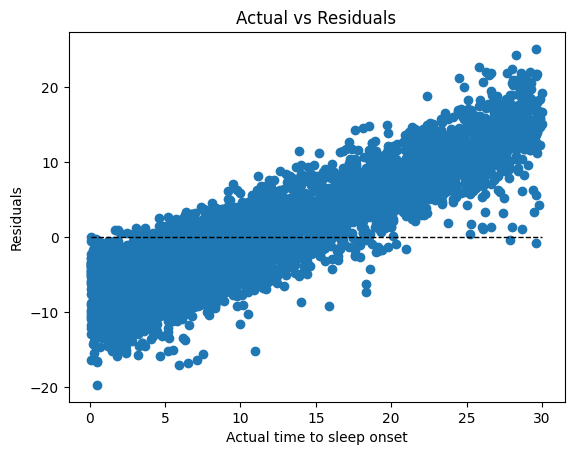

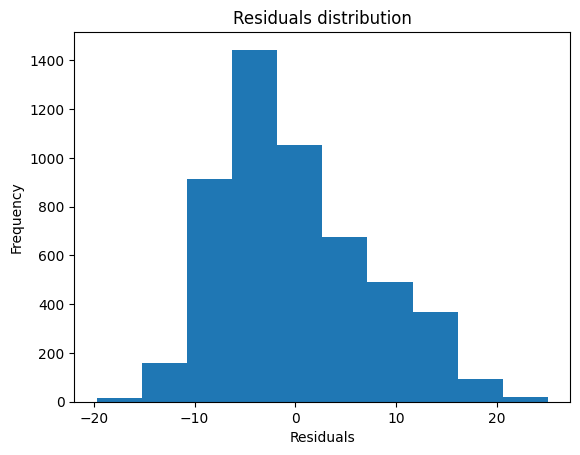

In [73]:

# Evaluate the performance on the test set

predictions_test_clean, errors_test_clean, mape_test_clean, accuracy_test_clean, residuals_test_clean = evaluate_performance_test(gbr_clean, X_test_clean, y_test_clean)

Mean Absolute Error: 3.17
Accuracy: -64.11 %.
Mean Squared Error: 14.4
Root Mean Squared Error: 3.79
R2: 0.19


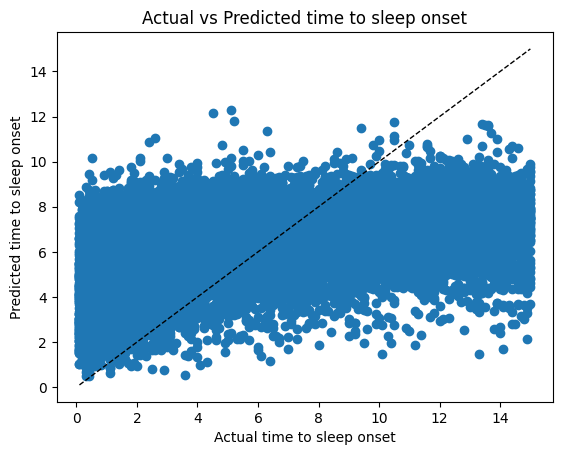

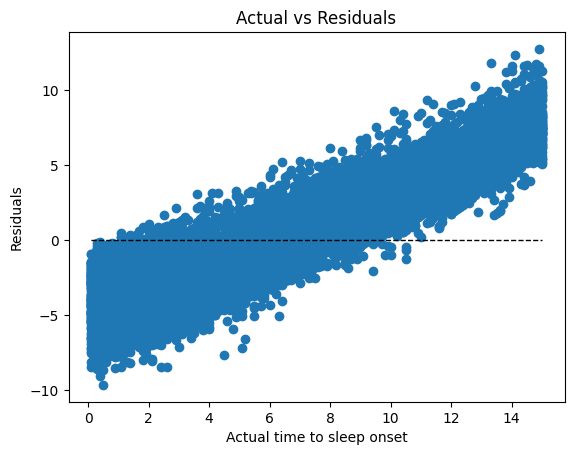

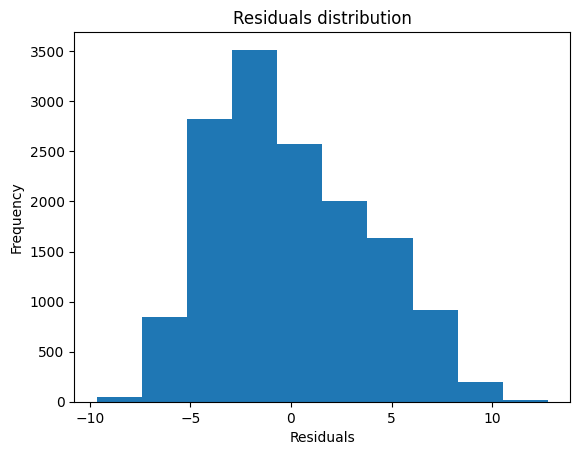

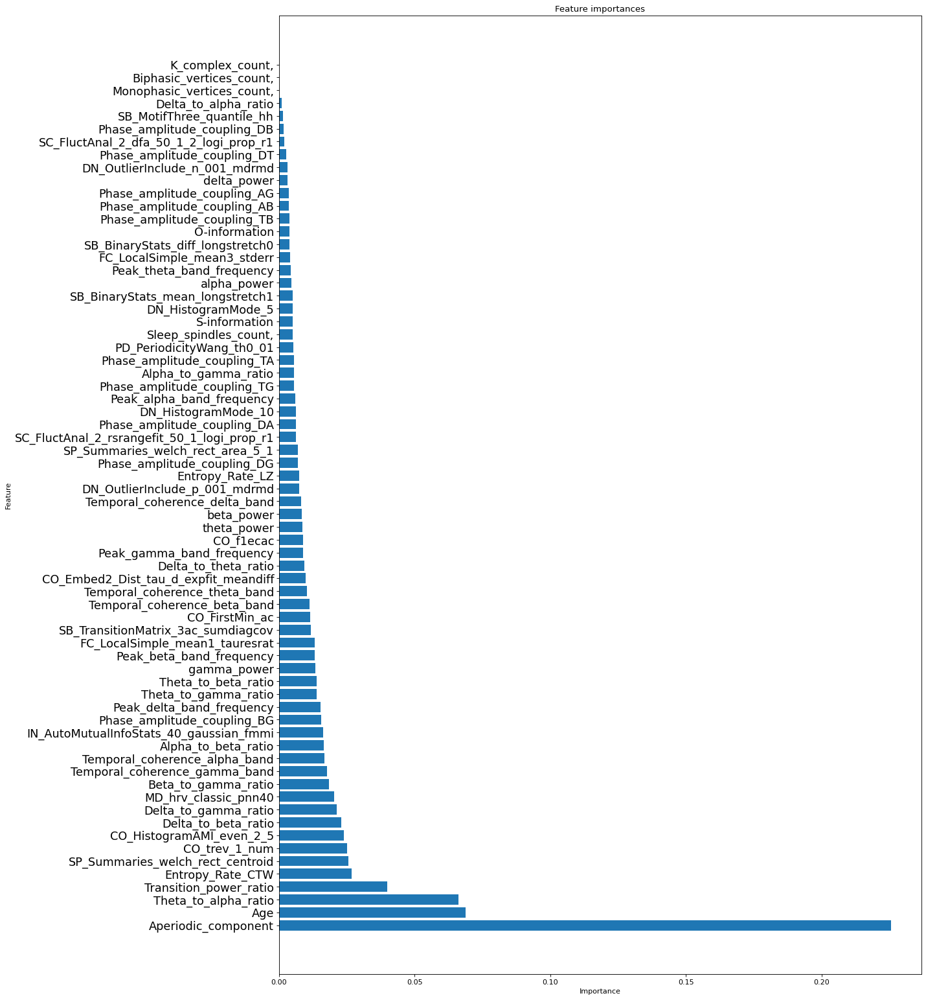

In [77]:
# # Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15). Split the data into training and testing sets randomly


# Create a train dataframe 
X_clean_15 = mydata_clean_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean_15 = mydata_clean_15['Label']

# Split the data into training and testing sets
X_train_15, X_test_15, y_train_15, y_test_15 = train_test_split(X_clean_15, y_clean_15, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr_clean_15 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_clean_15 = cross_val_predict(gbr_clean_15, X_train_15, y_train_15, cv=10)

# evaluate the predictions made during cross-validation
errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15, mse_clean_15, rmse_clean_15, r2_clean_15 = evaluate_performance_train(gbr_clean_15, X_train_15, y_train_15, predictions_clean_15)

# Plot the feature importances
gbr_clean_15.fit(X_train_15, y_train_15)
importances_clean_15, indices_clean_15, names_clean_15 = plot_feature_importances(gbr_clean_15, X_train_15)





Mean Absolute Error: 3.08
Accuracy: -63.04 %.
Mean Squared Error: 13.66
Root Mean Squared Error: 3.7
R2: 0.21


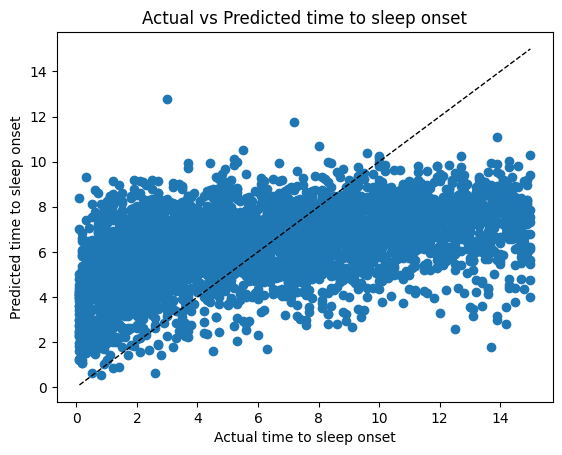

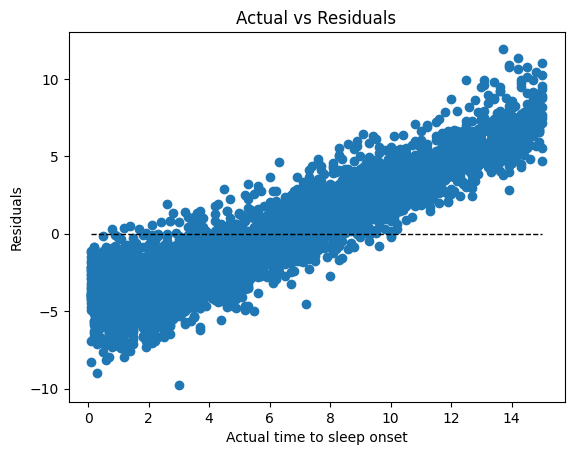

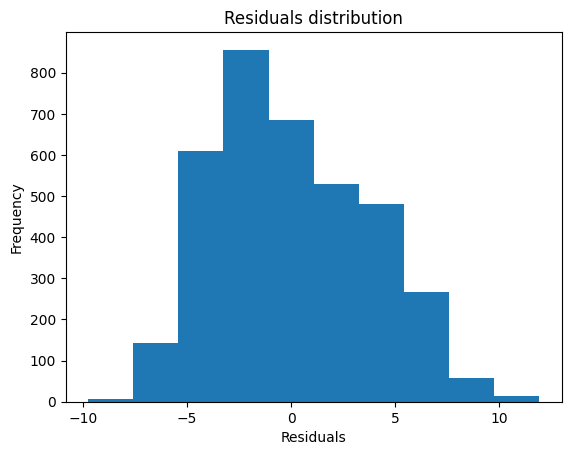

In [75]:
# Evaluate the performance on the test set

predictions_test_clean_15, errors_test_clean_15, mape_test_clean_15, accuracy_test_clean_15, residuals_test_clean_15 = evaluate_performance_test(gbr_clean_15, X_test_15, y_test_15)


Mean Absolute Error: 3.55
Accuracy: 83.18 %.
Mean Squared Error: 17.41
Root Mean Squared Error: 4.17
R2: 0.08


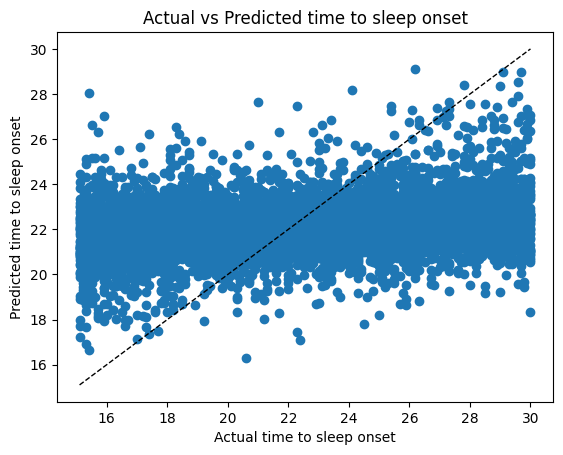

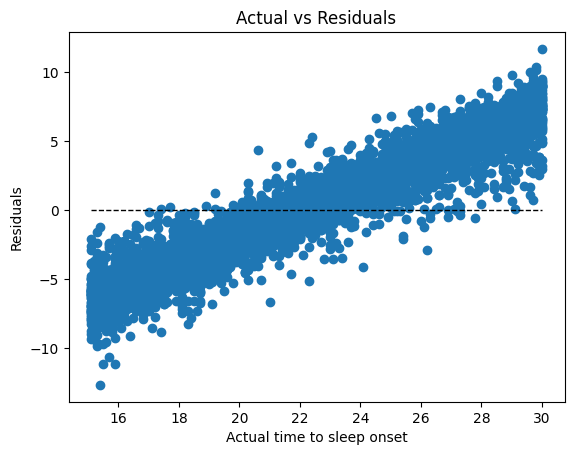

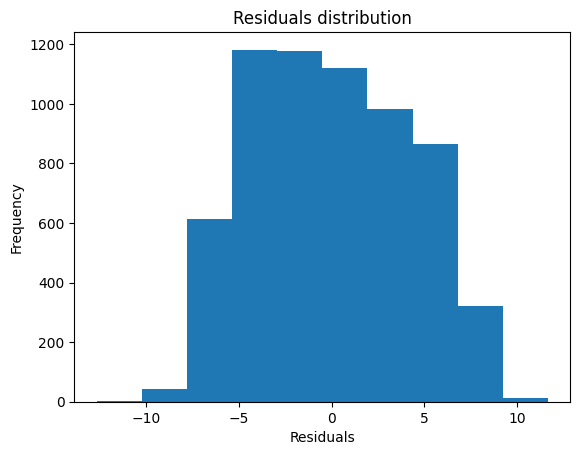

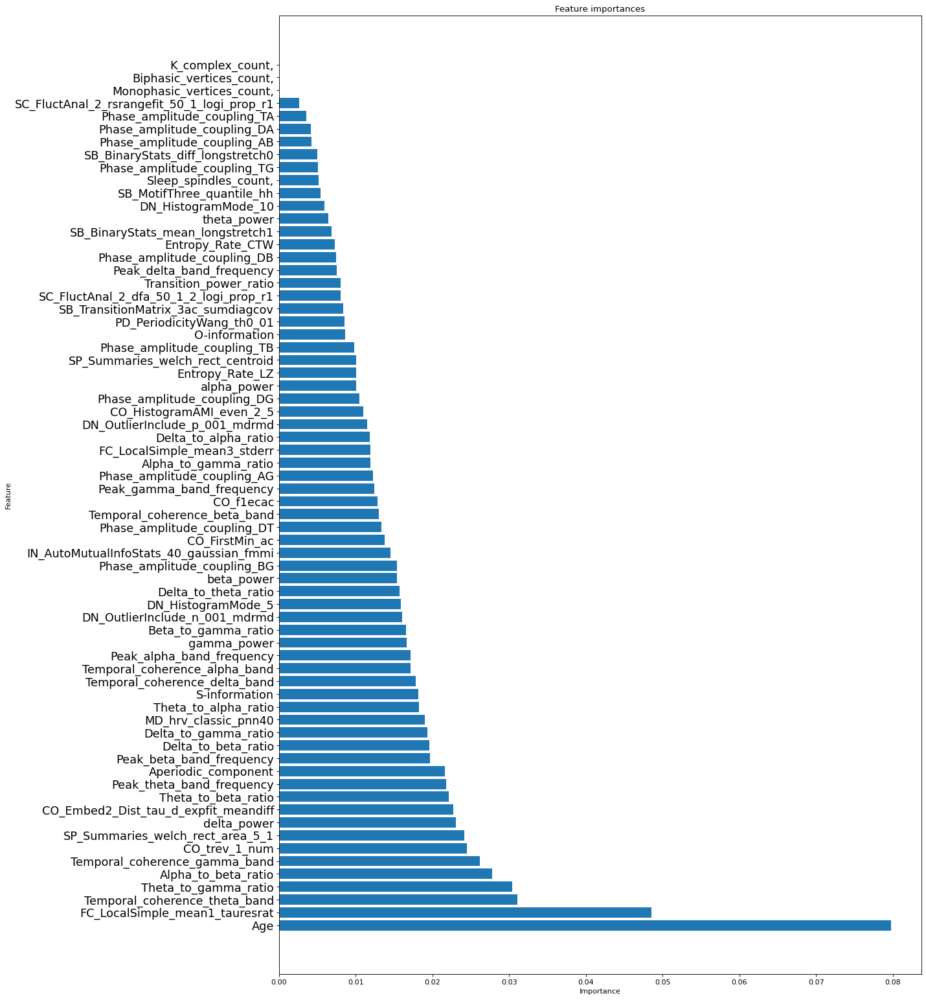

In [78]:
# # Repeat the task on the clean data with no longer than 15 minutes before the onset (Label > 15). Split the data into training and testing sets randomly

X_clean_15_1 = mydata_clean_15_1.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean_15_1 = mydata_clean_15_1['Label']

# Split the data into training and testing sets

X_train_15_1, X_test_15_1, y_train_15_1, y_test_15_1 = train_test_split(X_clean_15_1, y_clean_15_1, test_size=0.2, random_state=0)

# Create a gradient boosting regressor

gbr_clean_15_1 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions

predictions_clean_15_1 = cross_val_predict(gbr_clean_15_1, X_train_15_1, y_train_15_1, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1, mse_clean_15_1, rmse_clean_15_1, r2_clean_15_1 = evaluate_performance_train(gbr_clean_15_1, X_train_15_1, y_train_15_1, predictions_clean_15_1)

# Plot the feature importances

gbr_clean_15_1.fit(X_train_15_1, y_train_15_1)

importances_clean_15_1, indices_clean_15_1, names_clean_15_1 = plot_feature_importances(gbr_clean_15_1, X_train_15_1)


Mean Absolute Error: 3.69
Accuracy: 82.69 %.
Mean Squared Error: 18.55
Root Mean Squared Error: 4.31
R2: 0.09


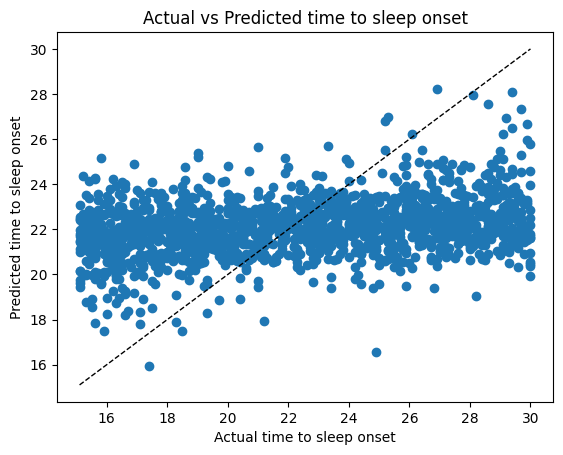

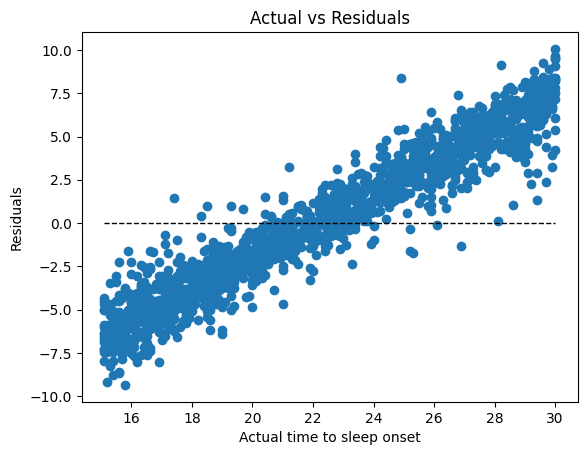

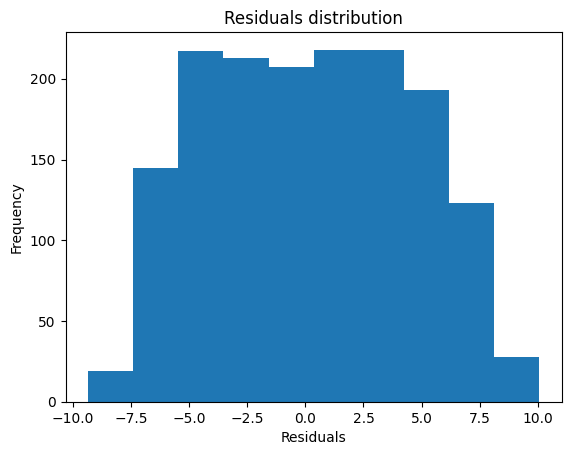

In [79]:
# evaluate the performance on the test set

predictions_test_clean_15_1, errors_test_clean_15_1, mape_test_clean_15_1, accuracy_test_clean_15_1, residuals_test_clean_15_1 = evaluate_performance_test(gbr_clean_15_1, X_test_15_1, y_test_15_1)

Mean Absolute Error: 3.38
Accuracy: -70.08 %.
Mean Squared Error: 16.33
Root Mean Squared Error: 4.04
R2: 0.09


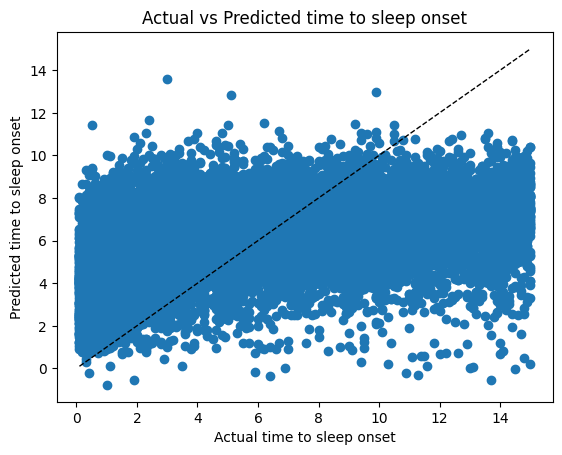

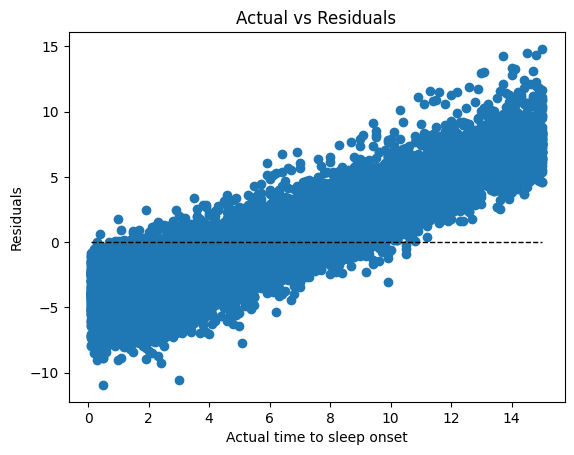

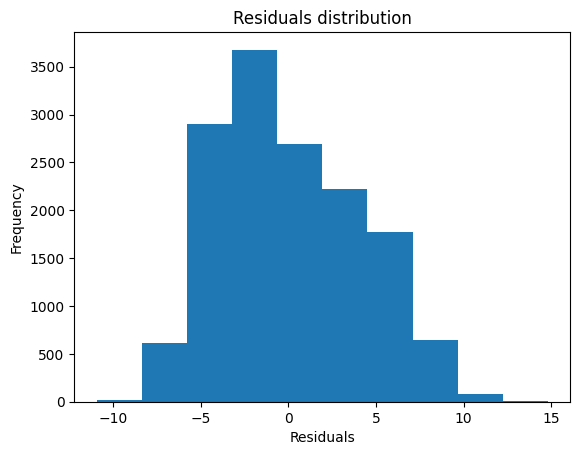

ValueError: too many values to unpack (expected 4)

In [80]:
# Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15)

# Create a dataframe with the test subjects
test_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects
train_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)
X_train_15 = train_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_train_15 = train_data_15['Label']

X_test_15 = test_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_test_15 = test_data_15['Label']

# Create a gradient boosting regressor
gbr_15 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_15 = cross_val_predict(gbr_15, X_train_15, y_train_15, cv=10)

# evaluate the predictions made during cross-validation
errors_15, mape_15, accuracy_15, residuals_15 = evaluate_performance_train(gbr_15, X_train_15, y_train_15, predictions_15)

# Plot the feature importances
gbr_15.fit(X_train_15, y_train_15)
importances_15, indices_15, names_15 = plot_feature_importances(gbr_15, X_train_15)


In [ ]:
# Evaluate the performance on the test set

predictions_test_15, errors_test_15, mape_test_15, accuracy_test_15, residuals_test_15 = evaluate_performance_test(gbr_15, X_test_15, y_test_15)

In [15]:
!pip install torch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.8/55.8 MB 3.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 5.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 6.6 MB/s eta 0:00:00a 0:00:01
  Using cached Jinja2-3.1.2-py3-none-any.whl (133 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.2/536.2 kB 4.2 MB/s eta 0:00:00a 0:00:01


# Restructure the data to create sliding windows minutes 

In [84]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import wandb

In [85]:

mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_allsbjs.csv')

In [86]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,-4.516727,-6.263800,-5.725365,-7.130945,-9.711886,...,0.368663,0.388763,0.361791,1.865539,0.0,0.0,0.500000,0.0,NaN,NaN
175296,0.4,6811,79,1,1,-4.225398,-6.021411,-6.309019,-7.301486,-9.633378,...,0.412933,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735,0.254520
175297,0.3,6811,79,1,1,-4.305932,-5.913641,-6.310800,-7.253252,-9.668088,...,0.394851,0.401651,0.379019,1.980931,0.0,0.0,0.500000,0.0,NaN,NaN
175298,0.2,6811,79,1,1,-4.146675,-5.690611,-6.052502,-7.268907,-9.663966,...,0.383634,0.442798,0.392801,1.925202,0.0,0.0,1.000000,0.0,NaN,NaN


In [87]:
mydata.isnull().sum()

Label                            0
Sbj_ID                           0
Age                              0
ifCleanOnset                     0
SleepStage                       0
                             ...  
Biphasic_vertices_count,     14820
Sleep_spindles_count,        14820
K_complex_count,             14820
O-information               137816
S-information               137816
Length: 72, dtype: int64

In [88]:
# Exclude the following columns: O-information, S-information, Monophasic_vertices_count, Biphasic_vertices_count, Sleep_spindles_count, K_complex_count

mydata = mydata.drop(['O-information', 'S-information', 'Monophasic_vertices_count,', 'Biphasic_vertices_count,', 'Sleep_spindles_count,', 'K_complex_count,'], axis=1)

In [89]:
# Exclude NaNs

mydata = mydata.dropna()

In [90]:
# Create a list of all unique subjects

subjects = mydata['Sbj_ID'].unique()


# Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set

train_subjects = np.random.choice(subjects, size=int(0.8*len(subjects)), replace=False)
val_subjects = np.random.choice(subjects, size=int(0.1*len(subjects)), replace=False)
test_subjects = np.random.choice(subjects, size=int(0.1*len(subjects)), replace=False)

# Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
mydata['Set'] = 'train'
mydata.loc[mydata['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
mydata.loc[mydata['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'



In [91]:
import pandas as pd
import numpy as np

# Sort your dataframe by Sbj_ID if not already sorted
df = mydata.sort_values('Sbj_ID')

# Drop the rows with the missing values
df = df.dropna()

# Show whether theres any nan values
df.isnull().values.any()



False

In [92]:
# Define your window size
window_size = 50  # This is equivalent to 1 minute (10 * 6 seconds)

# Create empty lists to store your sequences and labels
train_sequences = []
train_labels = []
val_sequences = []
val_labels = []
test_sequences = []
test_labels = []

# Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
for _, group in df.groupby('Sbj_ID'):
    
    # For each group, get the feature columns and convert them into numpy array
    group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

    train_test = group['Set'].iloc[0]
    
    # Iterate over the group array with a sliding window
    for i in range(len(group_features) - window_size):

        if train_test == 'train':
            # Append the window data to your sequences
            train_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            train_labels.append(group['Label'].iloc[i + window_size])
        
        elif train_test == 'val':
            # Append the window data to your sequences
            val_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            val_labels.append(group['Label'].iloc[i + window_size])

        elif train_test == 'test':
            # Append the window data to your sequences
            test_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            test_labels.append(group['Label'].iloc[i + window_size])
        
# Convert the sequences and labels into numpy arrays
train_sequences = np.array(train_sequences)
train_labels = np.array(train_labels)
val_sequences = np.array(val_sequences)
val_labels = np.array(val_labels)
test_sequences = np.array(test_sequences)
test_labels = np.array(test_labels)


In [93]:
print(type(train_sequences), train_sequences.dtype)
print(type(train_labels), train_labels.dtype)

<class 'numpy.ndarray'> float64
<class 'numpy.ndarray'> float64


In [94]:
for i, seq in enumerate(train_sequences):
    if not isinstance(seq, np.ndarray) or seq.shape != (window_size, 68):
        print(f"Sequence {i} has type {type(seq)} and shape {seq.shape}")

Sequence 0 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 1 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 2 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 3 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 4 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 5 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 6 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 7 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 8 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 9 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 10 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 11 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 12 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 13 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 14 has type <class 'numpy.ndarray'> and shape (50, 62)
Sequence 15 has type <class 'numpy.ndarray'> and s

In [ ]:
train_sequences.shape, train_labels.shape, test_sequences.shape, test_labels.shape, val_sequences.shape, val_labels.shape

((7136, 50, 68), (7136,), (991, 50, 68), (991,), (689, 50, 68), (689,))

In [ ]:
# Create a PyTorch dataset

class SleepDataset(Dataset):
    def __init__(self, sequences, labels):
        self.sequences = sequences
        self.labels = labels

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return torch.from_numpy(self.sequences[idx]).float(), torch.from_numpy(np.array(self.labels[idx])).float()
    
# Create the training, validation and test datasets
test_dataset = SleepDataset(test_sequences, test_labels)
train_dataset = SleepDataset(train_sequences, train_labels)
val_dataset = SleepDataset(val_sequences, val_labels)

# Create the dataloaders
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=True)





In [ ]:
test_dataset.__getitem__(0)

(tensor([[77.0000, -4.9341, -5.5183,  ...,  0.0000,  0.0823, 36.8090],
         [77.0000, -4.8269, -5.3904,  ...,  0.0000,  0.0855, 36.8123],
         [77.0000, -4.7145, -5.2539,  ...,  0.0000, 18.0180, 55.4379],
         ...,
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379],
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379],
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379]]),
 tensor(14.6000))

In [ ]:
import torch.nn as nn

class SleepOnsetRNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1) # output is a single value (time to sleep onset)

    def forward(self, x):
        # Initialize hidden and cell states 
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)

        # Forward propagate the LSTM
        out, _ = self.lstm(x, (h0, c0)) 

        # Decode the hidden state of the last time step
        out = self.fc(out[:, -1, :])
        return out

In [ ]:
# Write a training loop function that trains the model

def train(model, train_loader, val_loader, num_epochs, criterion, optimizer, device):

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):

        # Train the model
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
        
            loss = criterion(outputs, labels.view(-1, 1))

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Validate the model
        model.eval()
        with torch.no_grad():
            val_loss = 0
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                val_loss += criterion(outputs, labels.view(-1, 1)).item()

            print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Loss: {val_loss/len(val_loader)}')

        # Save the model training and validation losses for plotting 
        train_losses.append(loss.item())
        val_losses.append(val_loss/len(val_loader))
    
    return train_losses, val_losses, model



In [ ]:
# Define the model

model = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

# Train the model
train_losses, val_losses, model = train(model, train_loader, val_loader, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)




Epoch 1/50, Loss: 79.17044830322266, Validation Loss: 79.14597459272905
Epoch 2/50, Loss: 71.5047378540039, Validation Loss: 76.53942593661222
Epoch 3/50, Loss: 74.71084594726562, Validation Loss: 76.09779635342684
Epoch 4/50, Loss: 61.05760192871094, Validation Loss: 72.38902074640447
Epoch 5/50, Loss: 48.4798469543457, Validation Loss: 72.16089422052556
Epoch 6/50, Loss: 43.5098876953125, Validation Loss: 82.08686343106356
Epoch 7/50, Loss: 26.619325637817383, Validation Loss: 69.64002331820402
Epoch 8/50, Loss: 22.828760147094727, Validation Loss: 62.62939522483132
Epoch 9/50, Loss: 14.930692672729492, Validation Loss: 70.65079290216619
Epoch 10/50, Loss: 22.18313980102539, Validation Loss: 49.83130472356623
Epoch 11/50, Loss: 14.995061874389648, Validation Loss: 53.07712104103782
Epoch 12/50, Loss: 11.489705085754395, Validation Loss: 77.10603748668323
Epoch 13/50, Loss: 30.335311889648438, Validation Loss: 44.31065854159269
Epoch 14/50, Loss: 13.113533020019531, Validation Loss: 4

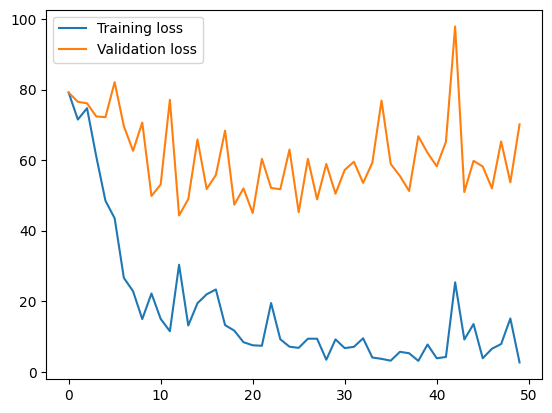

In [ ]:
# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()


In [ ]:
# test the trained model

def test(model, test_loader, device):
    model.eval()
    predictions, actuals = [], []
    with torch.no_grad():
        test_loss = 0
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            test_loss += criterion(outputs, labels.view(-1, 1)).item()

            predictions.append(outputs.cpu().numpy())
            actuals.append(labels.cpu().numpy())

        print(f'Test Loss: {test_loss/len(test_loader)}')

    return np.concatenate(predictions), np.concatenate(actuals)

predictions, actuals = test(model, test_loader, device)








Test Loss: 103.33945369720459


In [ ]:
def evaluate_performance_test(predictions, y_test):

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    #residuals = y_test - predictions
    #plt.scatter(y_test, residuals)
    #plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    #plt.xlabel('Actual time to sleep onset')
    #plt.ylabel('Residuals')
    #plt.title('Actual vs Residuals')
    #plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

Mean Absolute Error: 10.01
Accuracy: -160.69 %.
Mean Squared Error: 103.48
Root Mean Squared Error: 10.17
R2: -0.23


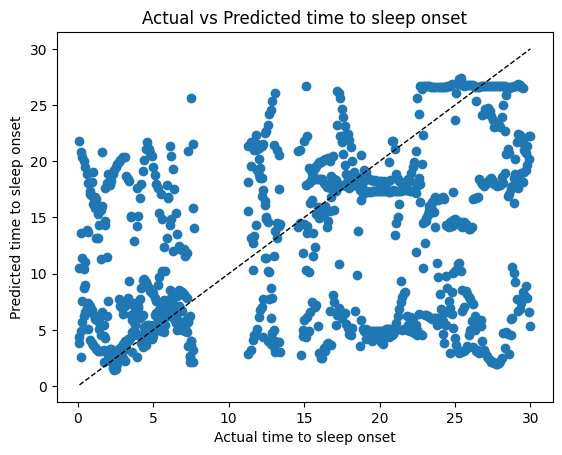

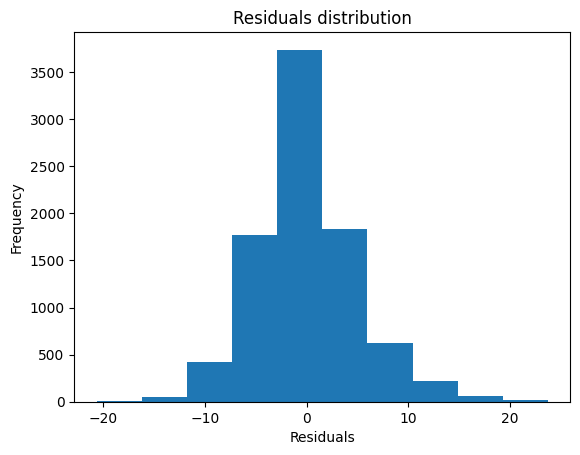

In [ ]:

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)

## Repeat the same analysis but with the scaled data ##

In [ ]:
from sklearn.preprocessing import StandardScaler

# Initialize the scaler
scaler = StandardScaler()


# Scale each sequence individually, excluding the first feature
train_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.fit_transform(seq[:, 1:])], axis=-1) for seq in train_sequences])
val_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in val_sequences])
test_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in test_sequences])

In [ ]:
# Demonstrate the effect of scaling
print('Before scaling:')
print(train_sequences[0, 0, :5])
print('After scaling:')
print(train_sequences_scaled[0, 0, :5])


Before scaling:
[83.         -2.4452326  -3.15595023 -2.71083191 -2.96241   ]
After scaling:
[83.          6.57864818  6.77650251  6.83865544  6.98901772]


In [ ]:
# Create a PyTorch dataset

train_dataset_scaled = SleepDataset(train_sequences_scaled, train_labels)
val_dataset_scaled = SleepDataset(val_sequences_scaled, val_labels)
test_dataset_scaled = SleepDataset(test_sequences_scaled, test_labels)

# Create a PyTorch data loader

train_loader_scaled = DataLoader(dataset=train_dataset_scaled, batch_size=64, shuffle=True)
val_loader_scaled = DataLoader(dataset=val_dataset_scaled, batch_size=64, shuffle=False)
test_loader_scaled = DataLoader(dataset=test_dataset_scaled, batch_size=64, shuffle=False)





Epoch 1/50, Loss: 78.9644546508789, Validation Loss: 77.65414532748136
Epoch 2/50, Loss: 73.78741455078125, Validation Loss: 75.62964370033957
Epoch 3/50, Loss: 37.098636627197266, Validation Loss: 217.2987239144065
Epoch 4/50, Loss: 19.390527725219727, Validation Loss: 178.7751700661399
Epoch 5/50, Loss: 14.522982597351074, Validation Loss: 154.24536028775302
Epoch 6/50, Loss: 14.26211929321289, Validation Loss: 159.87440733476117
Epoch 7/50, Loss: 18.098819732666016, Validation Loss: 153.8678741455078
Epoch 8/50, Loss: 11.420109748840332, Validation Loss: 142.02124179493296
Epoch 9/50, Loss: 3.9792983531951904, Validation Loss: 141.12945938110352
Epoch 10/50, Loss: 6.260242938995361, Validation Loss: 156.71519643610173
Epoch 11/50, Loss: 1.9964065551757812, Validation Loss: 150.05533599853516
Epoch 12/50, Loss: 11.227911949157715, Validation Loss: 129.37936540083453
Epoch 13/50, Loss: 4.088630676269531, Validation Loss: 119.70353178544478
Epoch 14/50, Loss: 3.247220516204834, Validat

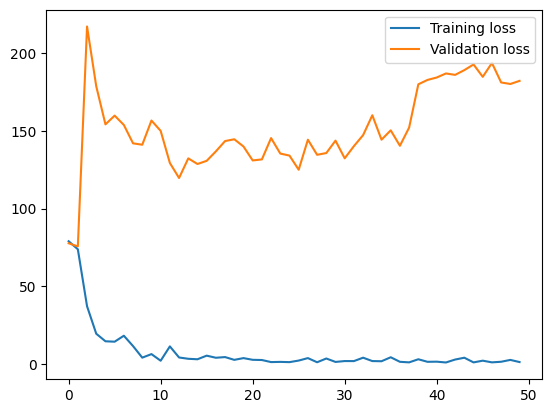

Test Loss: 173.52694064378738
Mean Absolute Error: 11.23
Accuracy: -63.65 %.
Mean Squared Error: 167.57
Root Mean Squared Error: 12.94
R2: -1.0


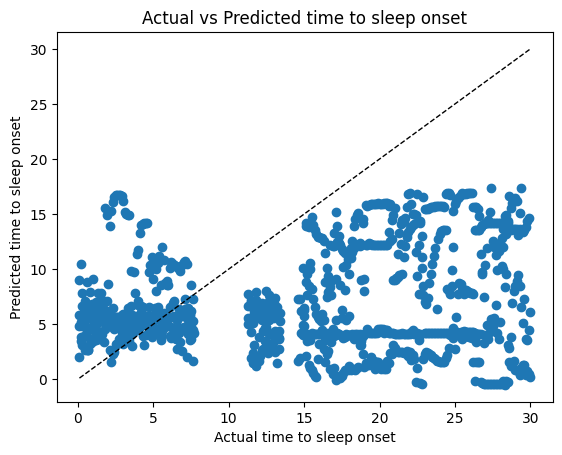

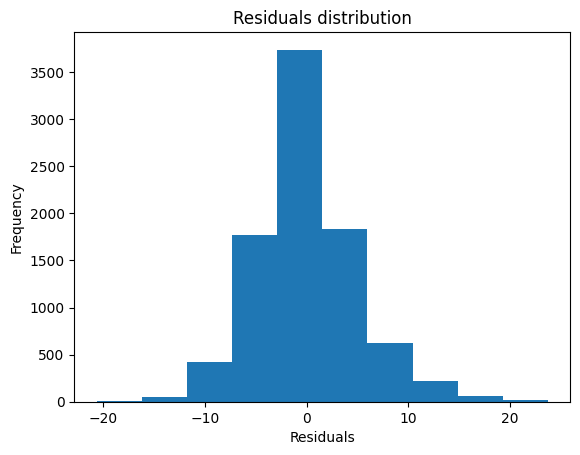

In [ ]:
# Define the model
model_scaled = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_scaled.parameters(), lr=0.001)

# Train the model
train_losses, val_losses, model_scaled = train(model_scaled, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)
# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_scaled, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)


In [ ]:
# Implement L2 regularization for SleepOnsetRNN

class SleepOnsetRNN(nn.Module):
    
    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2
        
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)
        
    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        
        out, _ = self.lstm(x, (h0, c0))  
        out = self.fc(out[:, -1, :])  
        
        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)
        
        return out + self.l2 * l2_reg
    
    

Epoch 1/50, Loss: 69.40338134765625, Validation Loss: 77.81042965975675
Epoch 2/50, Loss: 84.22791290283203, Validation Loss: 75.63748012889515
Epoch 3/50, Loss: 58.47734451293945, Validation Loss: 193.36434624411842
Epoch 4/50, Loss: 29.912899017333984, Validation Loss: 140.55609876459295
Epoch 5/50, Loss: 26.777236938476562, Validation Loss: 154.4676130468195
Epoch 6/50, Loss: 24.108280181884766, Validation Loss: 147.9511465592818
Epoch 7/50, Loss: 11.781251907348633, Validation Loss: 142.87735280123624
Epoch 8/50, Loss: 6.860189914703369, Validation Loss: 137.81526340137827
Epoch 9/50, Loss: 4.83211088180542, Validation Loss: 128.1112296364524
Epoch 10/50, Loss: 10.321246147155762, Validation Loss: 146.30216095664284
Epoch 11/50, Loss: 10.58066463470459, Validation Loss: 144.75499291853473
Epoch 12/50, Loss: 10.247501373291016, Validation Loss: 148.9814477400346
Epoch 13/50, Loss: 4.6198320388793945, Validation Loss: 167.69690773703834
Epoch 14/50, Loss: 1.6489567756652832, Validati

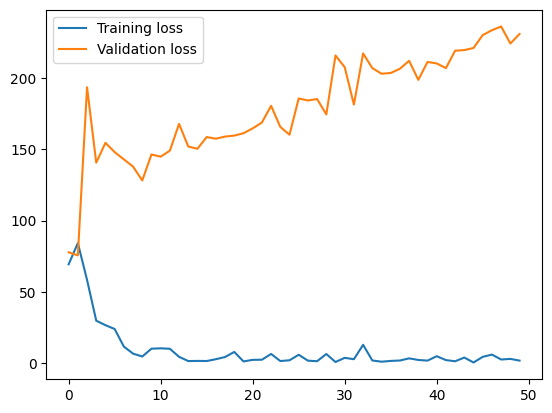

Test Loss: 241.56419777870178
Mean Absolute Error: 14.5
Accuracy: -57.78 %.
Mean Squared Error: 234.09
Root Mean Squared Error: 15.3
R2: -1.79


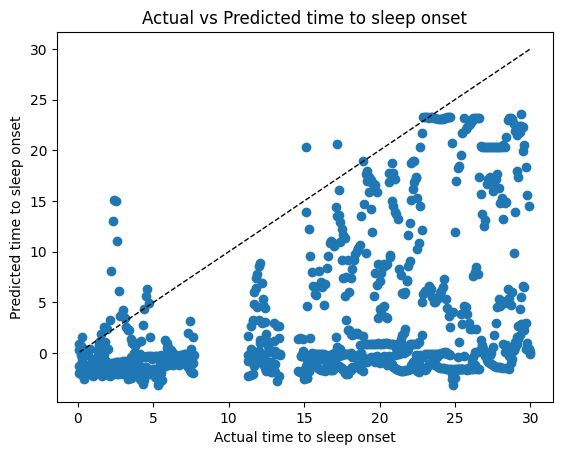

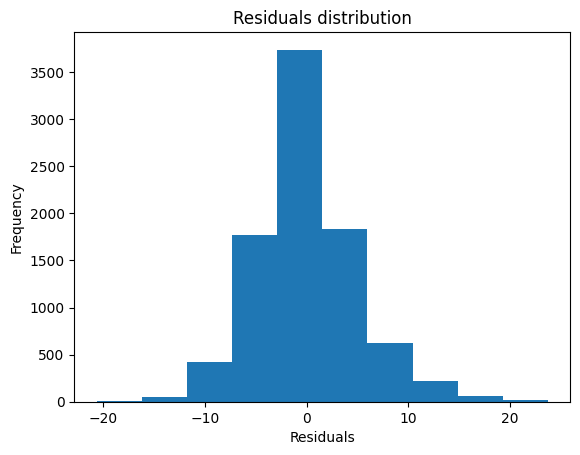

In [ ]:
# Try the regularized model

model_reg = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2, l2=0.001)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_reg.parameters(), lr=0.001)

# Train the model

train_losses, val_losses, model_reg = train(model_reg, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)

# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_reg, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)


Epoch 1/50, Loss: 79.13034057617188, Validation Loss: 78.19490710171786
Epoch 2/50, Loss: 84.81111907958984, Validation Loss: 75.54857097972523
Epoch 3/50, Loss: 74.30986785888672, Validation Loss: 75.43348121643066
Epoch 4/50, Loss: 62.31196975708008, Validation Loss: 234.8070240020752
Epoch 5/50, Loss: 25.064136505126953, Validation Loss: 238.57535934448242
Epoch 6/50, Loss: 21.6485595703125, Validation Loss: 281.8373790220781
Epoch 7/50, Loss: 23.931554794311523, Validation Loss: 258.24858925559306
Epoch 8/50, Loss: 16.914535522460938, Validation Loss: 286.12188373912466
Epoch 9/50, Loss: 10.173262596130371, Validation Loss: 277.42896686900747
Epoch 10/50, Loss: 9.820119857788086, Validation Loss: 270.798866965554
Epoch 11/50, Loss: 3.496812343597412, Validation Loss: 282.95674202658915
Epoch 12/50, Loss: 3.0186309814453125, Validation Loss: 300.4575826471502
Epoch 13/50, Loss: 4.007877826690674, Validation Loss: 266.3609182184393
Epoch 14/50, Loss: 11.202771186828613, Validation Lo

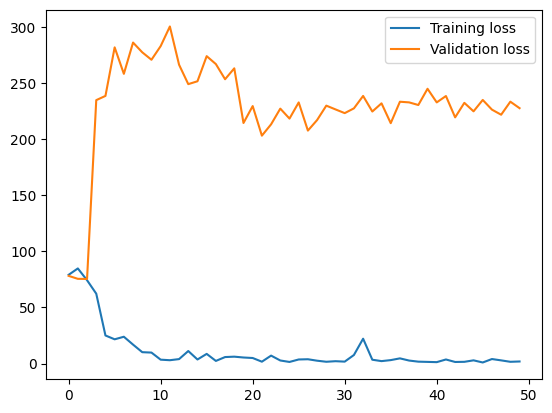

Test Loss: 248.52403497695923
Mean Absolute Error: 14.85
Accuracy: -79.24 %.
Mean Squared Error: 240.29
Root Mean Squared Error: 15.5
R2: -1.86


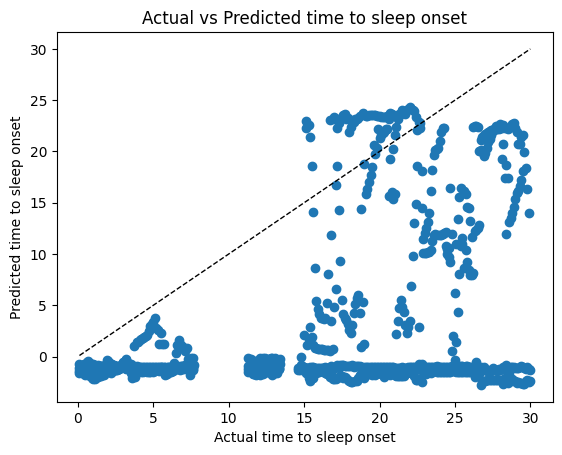

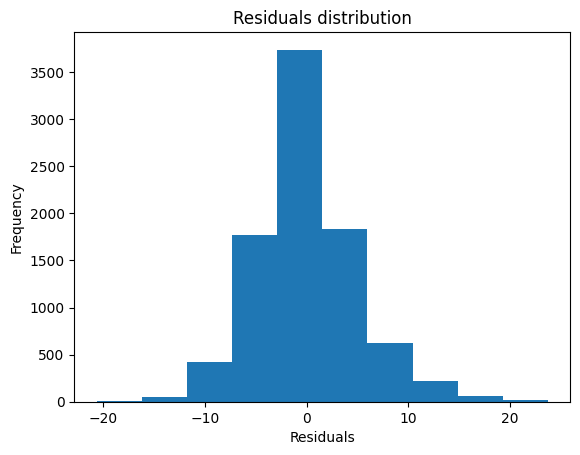

In [ ]:
# Implement dropout for SleepOnsetRNN

class SleepOnsetRNN(nn.Module):

    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])

        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)

        return out + self.l2 * l2_reg
    

# Try the dropout model

model_dropout = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2, dropout=0.5)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_dropout.parameters(), lr=0.001)

# Train the model

train_losses, val_losses, model_dropout = train(model_dropout, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)

# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_dropout, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)



## Create a hyperparameter training loop for my LSTM model ##

In [13]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import wandb
import sklearn

In [2]:

mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_allsbjs.csv')

In [95]:
# Create a PyTorch dataset
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
class SleepDataset(Dataset):
    def __init__(self, sequences, labels):
        self.sequences = sequences
        self.labels = labels

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return torch.from_numpy(self.sequences[idx]).float(), torch.from_numpy(np.array(self.labels[idx])).float()

In [96]:
# Create a function for creating sliding windows of selected length 

def create_sliding_windows(data,  window_size_minutes=5, random_seed = 42):

    # Create a list of all unique subjects
    subjects = data['Sbj_ID'].unique()


    # Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set
    np.random.seed(random_seed)
    train_subjects = np.random.choice(subjects, size=int(0.6*len(subjects)), replace=False)
    val_subjects = np.random.choice(np.setdiff1d(subjects, train_subjects), size=int(0.2*len(subjects)), replace=False)
    test_subjects = np.setdiff1d(subjects, np.concatenate((train_subjects, val_subjects)))
   
    
    # Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
    data['Set'] = 'train'
    data.loc[data['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
    data.loc[data['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'

    # Sort your dataframe by Sbj_ID if not already sorted
    data = data.sort_values('Sbj_ID')

    # Drop the rows with the missing values
    data = data.dropna()

    # Show whether theres any nan values
    data.isnull().values.any()


    # Convert the window size from minutes to 6-second epochs
    window_size = int((window_size_minutes*60)/6)

    # Create empty lists to store your sequences and labels
    train_sequences = []
    train_labels = []
    val_sequences = []
    val_labels = []
    test_sequences = []
    test_labels = []

    # Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
    for _, group in data.groupby('Sbj_ID'):
        
        # For each group, get the feature columns and convert them into numpy array
        group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

        train_test = group['Set'].iloc[0]
        
        # Iterate over the group array with a sliding window
        for i in range(len(group_features) - window_size):

            if train_test == 'train':

                # Append the window data to your sequences
                train_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                train_labels.append(group['Label'].iloc[i + window_size])

            
            elif train_test == 'val':
                # Append the window data to your sequences
                val_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                val_labels.append(group['Label'].iloc[i + window_size])

            elif train_test == 'test':
                # Append the window data to your sequences
                test_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                test_labels.append(group['Label'].iloc[i + window_size])
            
    # Convert the sequences and labels into numpy arrays
    train_sequences = np.array(train_sequences)
    train_labels = np.array(train_labels)
    val_sequences = np.array(val_sequences)
    val_labels = np.array(val_labels)
    test_sequences = np.array(test_sequences)
    test_labels = np.array(test_labels)

    return train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels





In [97]:

from torch import nn

class SleepOnsetRNN(nn.Module):

    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])

        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)

        return out + self.l2 * l2_reg

In [98]:
def train(model, train_loader, val_loader, num_epochs, criterion, optimizer, device, ifoutputpredictions):

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):

        # Train the model
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
        
            loss = criterion(outputs, labels.view(-1, 1))

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Validate the model
        model.eval()
        with torch.no_grad():
            val_loss = 0
            predictions, actuals = [], []
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                val_loss += criterion(outputs, labels.view(-1, 1)).item()

                

                predictions.append(outputs.cpu().numpy())
                actuals.append(labels.cpu().numpy())
            
            
           
            print('-'*100)
            print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Loss: {val_loss/len(val_loader)}')

        # Save the model training and validation losses for plotting 
        train_losses.append(loss.item())
        val_losses.append(val_loss/len(val_loader))

        # Calculate the mape, mae, and accuracy for the validation set
        predictions = np.concatenate(predictions)
        actuals = np.concatenate(actuals)
        mape = np.mean(np.abs(predictions - actuals)/actuals) * 100
        mae = np.mean(np.abs(predictions - actuals))
        # calculate accuracy in percentage
        accuracy = 100 - np.mean(mape)
      
        print('-'*100 )
        print(f'Validation MAPE: {mape}, Validation MAE: {mae}, Validation Accuracy: {accuracy}')
        print('-'*100 + '\n')

        
        last_predictions = predictions
    if ifoutputpredictions: 
        return train_losses, val_losses, model, accuracy, mape, mae, predictions, actuals
    else:    
        return train_losses, val_losses, model, accuracy, mape, mae
# test the trained model

def test(model, test_loader, device, criterion):
    model.eval()
    predictions, actuals = [], []
    with torch.no_grad():
        test_loss = 0
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            test_loss += criterion(outputs, labels.view(-1, 1)).item()

            predictions.append(outputs.cpu().numpy())
            actuals.append(labels.cpu().numpy())

        print(f'Test Loss: {test_loss/len(test_loader)}')

    return np.concatenate(predictions), np.concatenate(actuals)


In [99]:
def evaluate_performance_test(predictions, y_test):

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    #residuals = y_test - predictions
    #plt.scatter(y_test, residuals)
    #plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    #plt.xlabel('Actual time to sleep onset')
    #plt.ylabel('Residuals')
    #plt.title('Actual vs Residuals')
    #plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

In [103]:
def training_loop_feature_RNN(mydata, num_epochs, hidden_size, num_layers, dropout, l2, lr, weight_decay, batch_size, device, random_seed = 42, window_size_minutes = 1, iftest = 0, ifoutputpredictions = 0):

    train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels = create_sliding_windows(mydata, window_size_minutes, random_seed)
    

    # Initialize the scaler
    scaler = StandardScaler()

    # Scale each sequence individually, excluding the first feature
    train_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.fit_transform(seq[:, 1:])], axis=-1) for seq in train_sequences])
    val_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in val_sequences])
    test_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in test_sequences])


    # Convert the numpy arrays into PyTorch tensors
    #train_sequences_scaled = torch.from_numpy(train_sequences_scaled).float()
    #train_labels = torch.from_numpy(train_labels).float()
    #val_sequences_scaled = torch.from_numpy(val_sequences_scaled).float()
    #val_labels = torch.from_numpy(val_labels).float()
    #test_sequences_scaled = torch.from_numpy(test_sequences_scaled).float()
    #test_labels = torch.from_numpy(test_labels).float()

    # Create the training, validation and test sets
    train_dataset = SleepDataset(train_sequences_scaled, train_labels)
    val_dataset = SleepDataset(val_sequences_scaled, val_labels)
    test_dataset = SleepDataset(test_sequences_scaled, test_labels)

    # Create the training, validation and test loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    # show size of the test loader
    
    

    # Initialize the model
    model = SleepOnsetRNN(input_size=62, hidden_size=hidden_size, num_layers=num_layers, dropout=dropout, l2=l2).to(device)

    # Define the loss function
    criterion = nn.MSELoss()

    # Define the optimizer
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

    # Empty lists to store training and validation losses
    train_losses = []
    val_losses = []

    # Train the model
    if ifoutputpredictions:
        train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals  = train(model, train_loader, val_loader, num_epochs=num_epochs, criterion=criterion, optimizer=optimizer, device=device, ifoutputpredictions = ifoutputpredictions)
    else: 
        train_losses, val_losses, model, accuracy, mape, mae = train(model, train_loader, val_loader, num_epochs=num_epochs, criterion=criterion, optimizer=optimizer, device=device, ifoutputpredictions = ifoutputpredictions)
    # plot the training and validation losses

    plt.plot(train_losses, label='Training loss')
    plt.plot(val_losses, label='Validation loss')
    plt.legend()
    plt.show()

    # test the trained model
    if iftest == 1:

        predictions, actuals = test(model, test_loader, device, criterion)
        predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)    
    
        return train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model
    else:
        if ifoutputpredictions:
            return train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals
        else:
            return train_losses, val_losses, model, accuracy, mape, mae



In [101]:
import torch
from sklearn.preprocessing import StandardScaler

## Experiment with different window sizes ##

Window size: 1 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 78.05316162109375, Validation Loss: 115.93133206617746
----------------------------------------------------------------------------------------------------
Validation MAPE: 406.9610595703125, Validation MAE: 8.97188949584961, Validation Accuracy: -306.9610595703125
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 60.47553253173828, Validation Loss: 146.93708223668472
----------------------------------------------------------------------------------------------------
Validation MAPE: 453.2069683074951, Validation MAE: 9.98340892791748, Validation Accuracy: -353.2069683074951
----------------------------------------------------------------------------------------------------

-

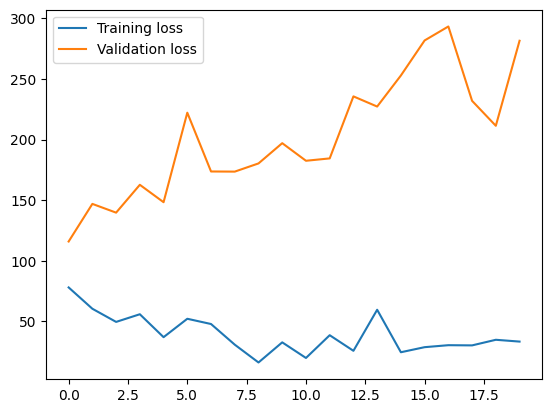

Window size: 2 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 56.82020950317383, Validation Loss: 85.84108550859465
----------------------------------------------------------------------------------------------------
Validation MAPE: 345.9252119064331, Validation MAE: 8.721224784851074, Validation Accuracy: -245.9252119064331
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 21.30670166015625, Validation Loss: 85.27054147000248
----------------------------------------------------------------------------------------------------
Validation MAPE: 307.4087142944336, Validation MAE: 8.961997032165527, Validation Accuracy: -207.4087142944336
----------------------------------------------------------------------------------------------------

-

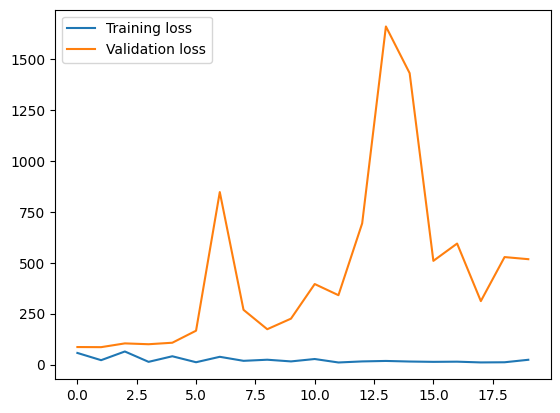

Window size: 3 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 94.15531158447266, Validation Loss: 86.6137434764811
----------------------------------------------------------------------------------------------------
Validation MAPE: 305.7708740234375, Validation MAE: 9.03226375579834, Validation Accuracy: -205.7708740234375
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 11.657087326049805, Validation Loss: 110.2194350096015
----------------------------------------------------------------------------------------------------
Validation MAPE: 340.7700300216675, Validation MAE: 10.186761856079102, Validation Accuracy: -240.77003002166748
----------------------------------------------------------------------------------------------------



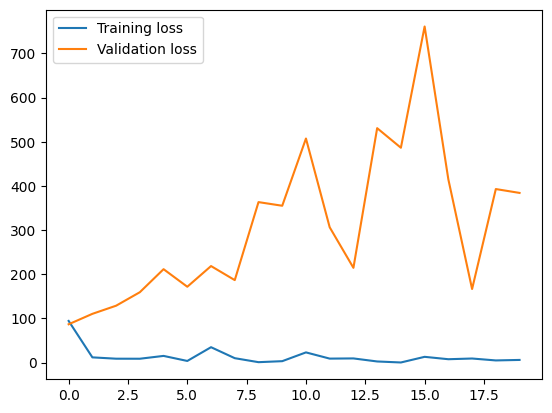

Window size: 4 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 66.76217651367188, Validation Loss: 86.24662928804092
----------------------------------------------------------------------------------------------------
Validation MAPE: 302.09672451019287, Validation MAE: 9.218657493591309, Validation Accuracy: -202.09672451019287
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 50.949161529541016, Validation Loss: 126.28826581234394
----------------------------------------------------------------------------------------------------
Validation MAPE: 307.5786590576172, Validation MAE: 10.7244234085083, Validation Accuracy: -207.5786590576172
----------------------------------------------------------------------------------------------------

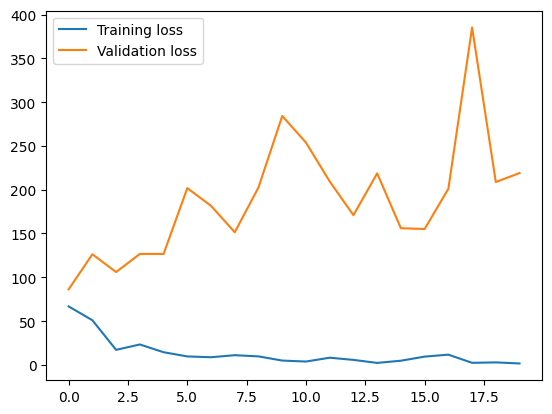

Window size: 5 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 14.754782676696777, Validation Loss: 99.55685719724974
----------------------------------------------------------------------------------------------------
Validation MAPE: 324.44448471069336, Validation MAE: 9.630953788757324, Validation Accuracy: -224.44448471069336
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 1.39686119556427, Validation Loss: 126.88326227560835
----------------------------------------------------------------------------------------------------
Validation MAPE: 353.70326042175293, Validation MAE: 10.514925956726074, Validation Accuracy: -253.70326042175293
-------------------------------------------------------------------------------------------------

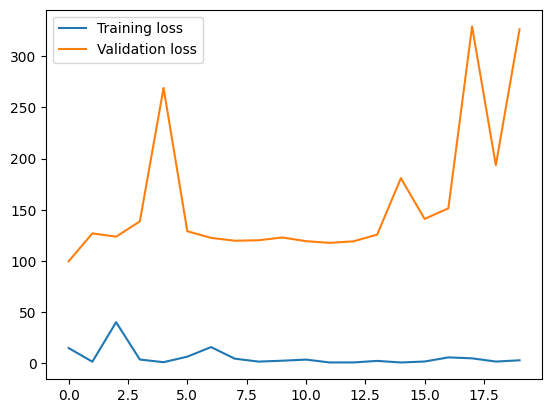

Window size: 6 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 39.76465606689453, Validation Loss: 124.12016874659398
----------------------------------------------------------------------------------------------------
Validation MAPE: 367.9882764816284, Validation MAE: 10.617719650268555, Validation Accuracy: -267.9882764816284
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 10.692987442016602, Validation Loss: 141.34423378236147
----------------------------------------------------------------------------------------------------
Validation MAPE: 377.5164604187012, Validation MAE: 11.362317085266113, Validation Accuracy: -277.5164604187012
--------------------------------------------------------------------------------------------------

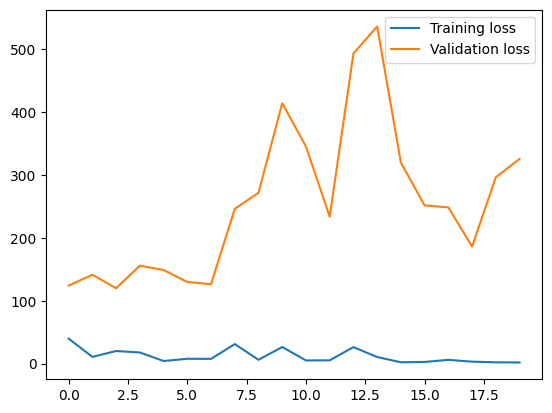

Window size: 7 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 26.000106811523438, Validation Loss: 112.90621977426984
----------------------------------------------------------------------------------------------------
Validation MAPE: 340.69972038269043, Validation MAE: 10.038599967956543, Validation Accuracy: -240.69972038269043
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 26.147859573364258, Validation Loss: 121.89654801303698
----------------------------------------------------------------------------------------------------
Validation MAPE: 362.5814914703369, Validation MAE: 10.350873947143555, Validation Accuracy: -262.5814914703369
-----------------------------------------------------------------------------------------------

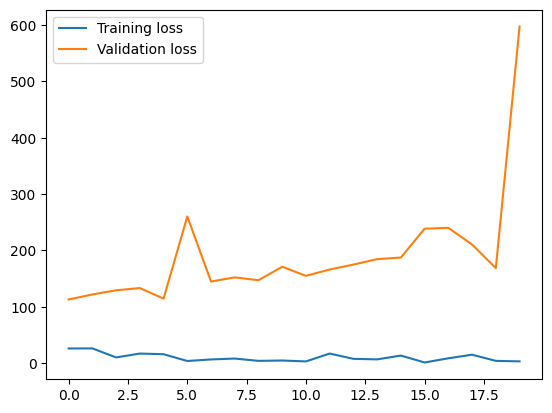

Window size: 8 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 57.45130157470703, Validation Loss: 120.64318879128813
----------------------------------------------------------------------------------------------------
Validation MAPE: 313.3837938308716, Validation MAE: 10.252699851989746, Validation Accuracy: -213.38379383087158
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 5.541157245635986, Validation Loss: 123.07079317365593
----------------------------------------------------------------------------------------------------
Validation MAPE: 332.9009532928467, Validation MAE: 10.097457885742188, Validation Accuracy: -232.90095329284668
-------------------------------------------------------------------------------------------------

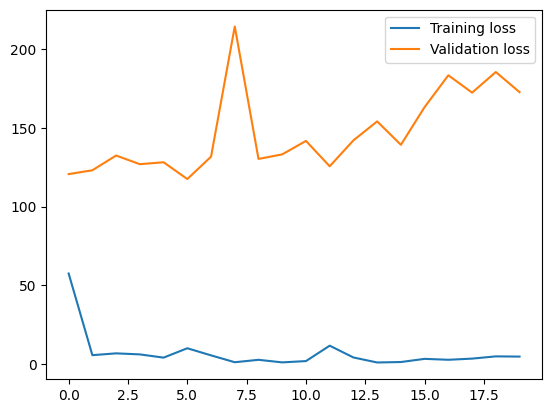

Window size: 9 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 9.602956771850586, Validation Loss: 112.06685503460004
----------------------------------------------------------------------------------------------------
Validation MAPE: 278.70333194732666, Validation MAE: 10.004415512084961, Validation Accuracy: -178.70333194732666
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 1.011611819267273, Validation Loss: 127.29812049041993
----------------------------------------------------------------------------------------------------
Validation MAPE: 282.7928066253662, Validation MAE: 10.512389183044434, Validation Accuracy: -182.7928066253662
-------------------------------------------------------------------------------------------------

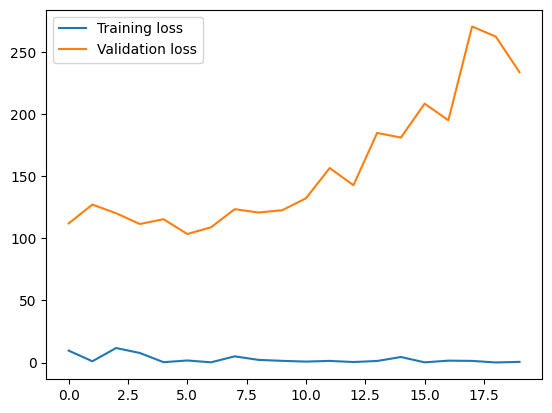

Window size: 10 minute(s)
----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 24.535736083984375, Validation Loss: 158.14957894220518
----------------------------------------------------------------------------------------------------
Validation MAPE: 104.49814796447754, Validation MAE: 11.236376762390137, Validation Accuracy: -4.498147964477539
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 3.976724624633789, Validation Loss: 178.8391389111678
----------------------------------------------------------------------------------------------------
Validation MAPE: 103.47898006439209, Validation MAE: 11.96484375, Validation Accuracy: -3.47898006439209
----------------------------------------------------------------------------------------------------

--

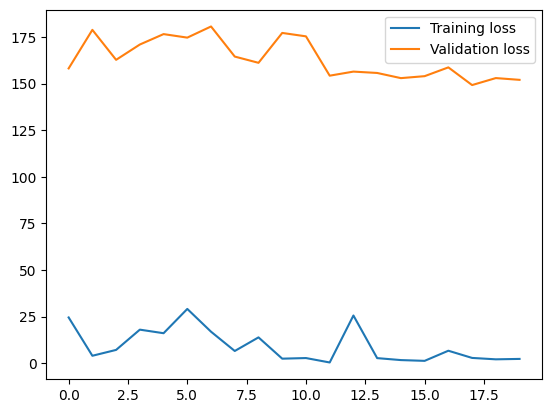

In [104]:
# Try different window sizes

window_size_minutes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# create a list to store the results
train_losses_list = []
val_losses_list = []
predictions_list = []
actuals_list = []
errors_list = []
mape_list = []
accuracy_list = []



for window_size_minute in window_size_minutes:
    print('Window size: {} minute(s)'.format(window_size_minute))

    # Train the model

    train_losses, val_losses, _, accuracy, mape, mae  = training_loop_feature_RNN(mydata, num_epochs=20, hidden_size=128, num_layers=2, dropout=0.0, l2=0.5, lr=0.001, weight_decay=0.0, batch_size=16, device=device, random_seed=42, window_size_minutes=window_size_minute, iftest=0)

    # Store the results
    train_losses_list.append(train_losses)
    val_losses_list.append(val_losses)
    accuracy_list.append(accuracy)
    mape_list.append(mape)
    #predictions_list.append(predictions)
    #actuals_list.append(actuals)
    #errors_list.append(errors)
    accuracy_list.append(accuracy)
    

## The 10 minute window shows a good performance with MSE loss. See if the results make sense ##

In [1]:
# Test the 10 miniutes window size model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals = training_loop_feature_RNN(mydata, num_epochs=20, hidden_size=128, num_layers=2, dropout=0, l2=0.1, lr=0.01, weight_decay=0.1, batch_size=32, device=device, random_seed=42, window_size_minutes=10, iftest=0, ifoutputpredictions=1)

# plot last predictions and actuals
plt.scatter(last_actuals, last_predictions)
# add a line for perfect correlation using actual min and max
plt.plot([last_actuals.min(), last_actuals.max()], [last_actuals.min(), last_actuals.max()], 'k--', lw=1)
plt.xlabel('Actual sleep onset time (minutes)')

plt.ylabel('Predicted sleep onset time (minutes)')
plt.show()




NameError: name 'torch' is not defined

----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 19.773529052734375, Validation Loss: 169.34509388193672
----------------------------------------------------------------------------------------------------
Validation MAPE: 109.19802188873291, Validation MAE: 11.752493858337402, Validation Accuracy: -9.19802188873291
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 3.167412519454956, Validation Loss: 152.66573503292148
----------------------------------------------------------------------------------------------------
Validation MAPE: 109.76560115814209, Validation MAE: 11.101094245910645, Validation Accuracy: -9.76560115814209
----------------------------------------------------------------------------------------------------

---------------------

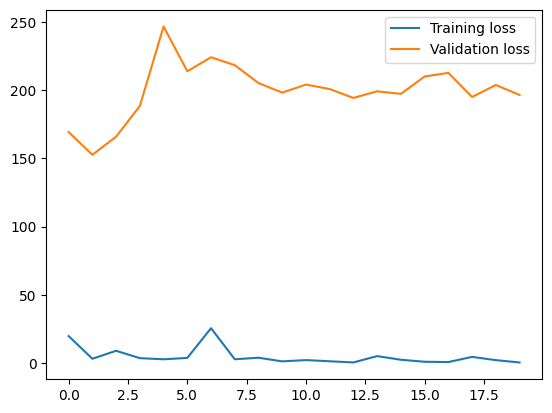

Test Loss: 160.95047291373632
Mean Absolute Error: 11.65
Accuracy: -11.24 %.
Mean Squared Error: 160.8
Root Mean Squared Error: 12.68
R2: -1.57


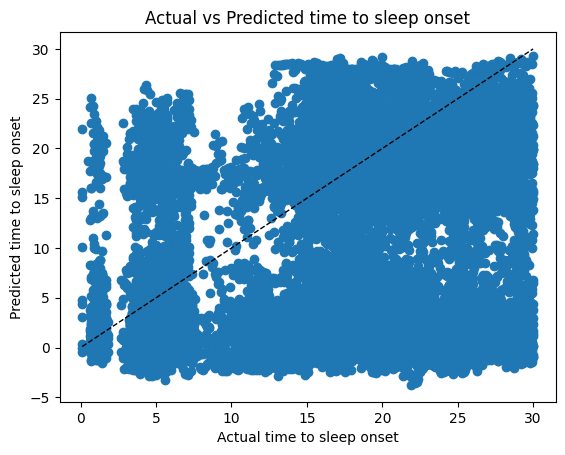

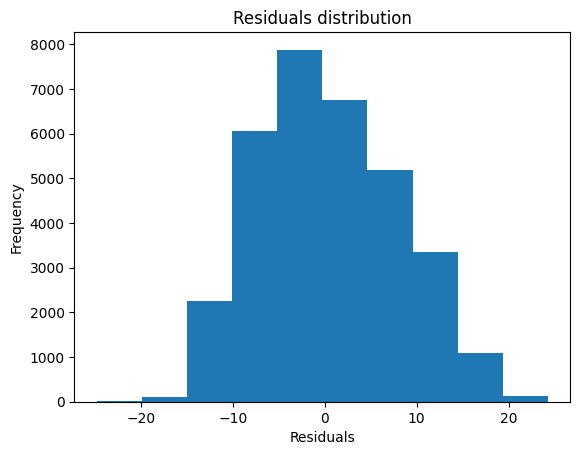

In [106]:

train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(mydata, num_epochs=20, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=16, device=device, random_seed=42, window_size_minutes=10, iftest=1, ifoutputpredictions=0)

## Try to experiment with 7 minute windows ##

----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 21.26357078552246, Validation Loss: 101.16610657798071
----------------------------------------------------------------------------------------------------
Validation MAPE: 334.52868461608887, Validation MAE: 9.92828369140625, Validation Accuracy: -234.52868461608887
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 33.71397018432617, Validation Loss: 108.18102581343115
----------------------------------------------------------------------------------------------------
Validation MAPE: 308.7428569793701, Validation MAE: 10.022662162780762, Validation Accuracy: -208.74285697937012
----------------------------------------------------------------------------------------------------

---------------------

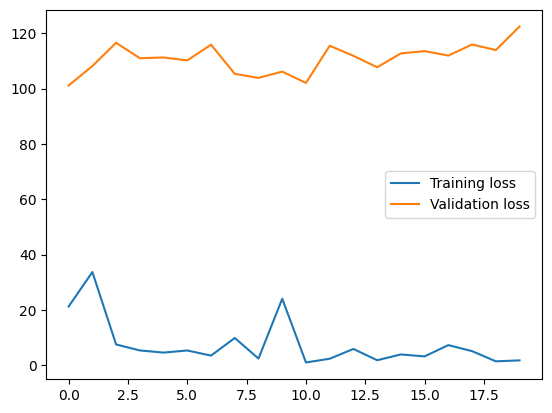

----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 33.13980484008789, Validation Loss: 96.29433001255667
----------------------------------------------------------------------------------------------------
Validation MAPE: 363.1129503250122, Validation MAE: 9.37569522857666, Validation Accuracy: -263.1129503250122
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 17.753549575805664, Validation Loss: 103.0089824342802
----------------------------------------------------------------------------------------------------
Validation MAPE: 341.108775138855, Validation MAE: 9.403964042663574, Validation Accuracy: -241.10877513885498
----------------------------------------------------------------------------------------------------

--------------------------

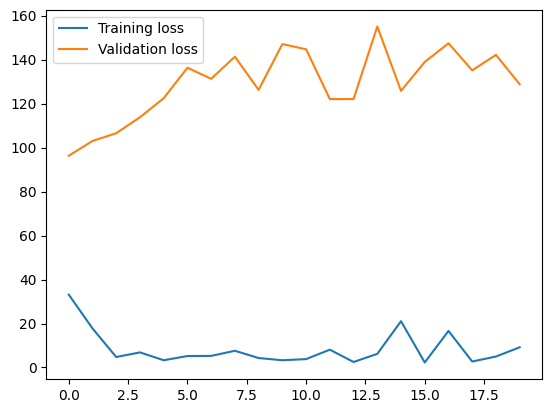

Test Loss: 117.01703797988115
Mean Absolute Error: 9.94
Accuracy: -233.66 %.
Mean Squared Error: 117.07
Root Mean Squared Error: 10.82
R2: -0.48


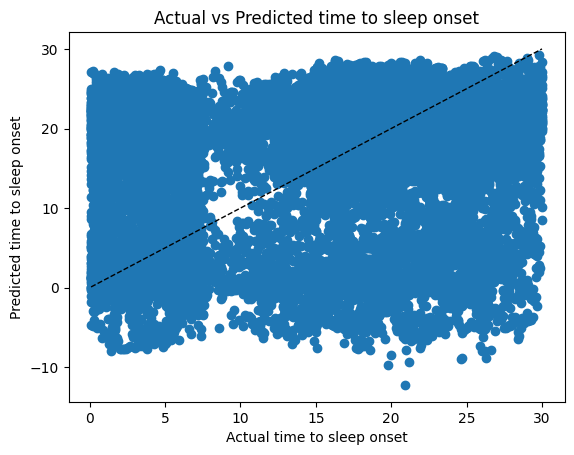

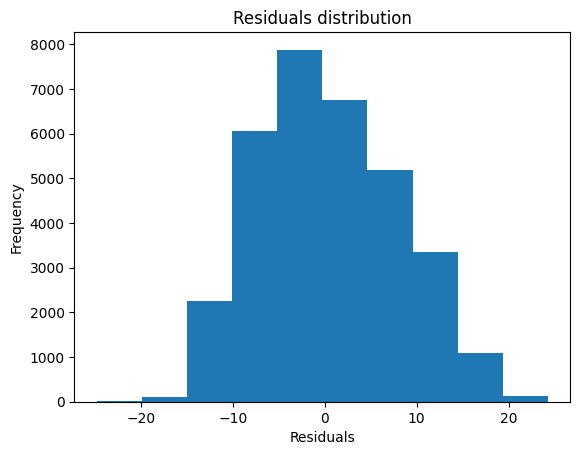

In [107]:
# Test the 7 miniutes window size model
train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals = training_loop_feature_RNN(mydata, num_epochs=20, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=16, device=device, random_seed=42, window_size_minutes=7, iftest=0, ifoutputpredictions=1)
train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(mydata, num_epochs=20, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=16, device=device, random_seed=42, window_size_minutes=7, iftest=1)

----------------------------------------------------------------------------------------------------
Epoch 1/2, Loss: 32.40744400024414, Validation Loss: 125.85671046205292
----------------------------------------------------------------------------------------------------
Validation MAPE: 236.18335723876953, Validation MAE: 10.349472999572754, Validation Accuracy: -136.18335723876953
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/2, Loss: 11.679917335510254, Validation Loss: 126.27274963542114
----------------------------------------------------------------------------------------------------
Validation MAPE: 291.05522632598877, Validation MAE: 10.420354843139648, Validation Accuracy: -191.05522632598877
----------------------------------------------------------------------------------------------------



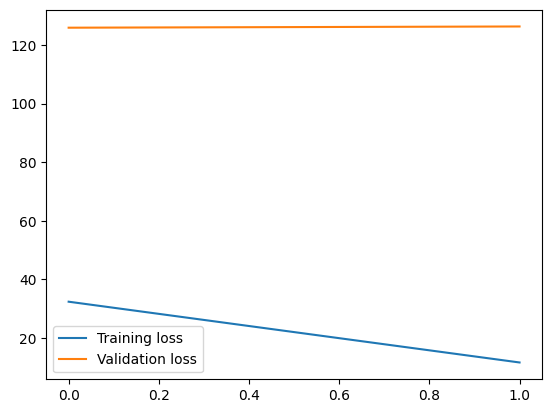

In [108]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
train_losses, val_losses, model, accuracy, mape, mae = training_loop_feature_RNN(mydata, num_epochs=2, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=32, device=device, random_seed=42, window_size_minutes=5, iftest=0)

In [11]:
import sklearn

Hidden size: 64
(559, 70, 68)
35
Epoch 1/10, Loss: 48.442806243896484, Validation Loss: 56.432920563220975
Epoch 2/10, Loss: 50.912803649902344, Validation Loss: 36.47548884550731
Epoch 3/10, Loss: 56.0352668762207, Validation Loss: 35.1251194106208
Epoch 4/10, Loss: 47.89923095703125, Validation Loss: 34.66275585492452
Epoch 5/10, Loss: 35.809967041015625, Validation Loss: 35.01250510745578
Epoch 6/10, Loss: 36.183563232421875, Validation Loss: 34.50756829049852
Epoch 7/10, Loss: 53.18490219116211, Validation Loss: 61.45211470259561
Epoch 8/10, Loss: 21.703275680541992, Validation Loss: 67.92249018417465
Epoch 9/10, Loss: 5.844109058380127, Validation Loss: 71.40340287155576
Epoch 10/10, Loss: 8.521757125854492, Validation Loss: 73.75594401359558


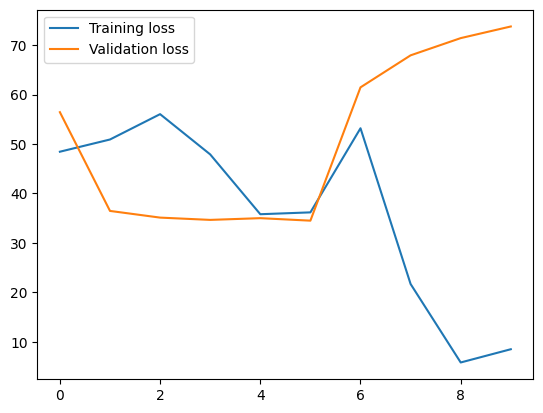

Test Loss: 57.24830402646746
Mean Absolute Error: 6.56
Accuracy: 59.08 %.
Mean Squared Error: 57.32
Root Mean Squared Error: 7.57
R2: -0.5


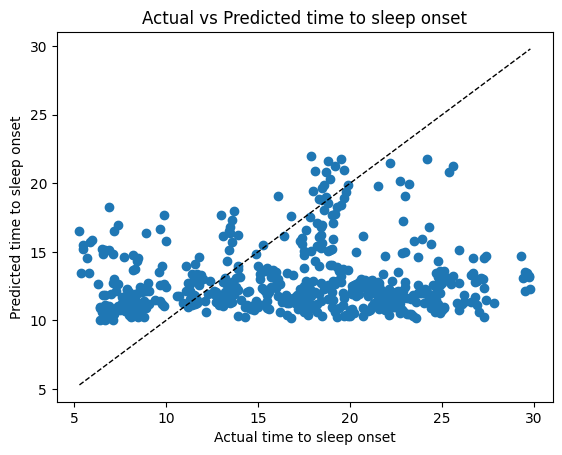

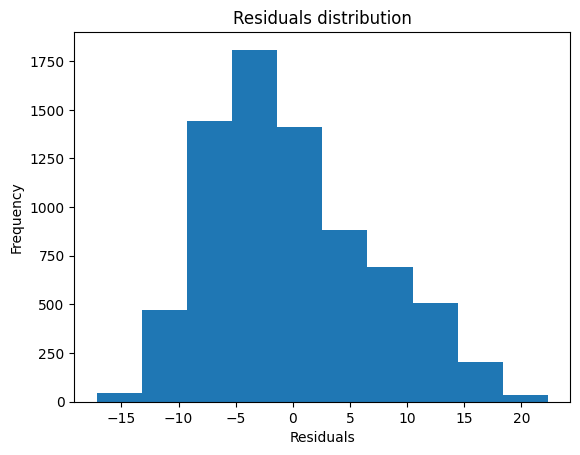

Hidden size: 128
(559, 70, 68)
35
Epoch 1/10, Loss: 24.124685287475586, Validation Loss: 35.143134636349146
Epoch 2/10, Loss: 20.375797271728516, Validation Loss: 34.45019010967678
Epoch 3/10, Loss: 50.03842544555664, Validation Loss: 34.38093331125047
Epoch 4/10, Loss: 41.85551071166992, Validation Loss: 34.651685900158355
Epoch 5/10, Loss: 52.40129852294922, Validation Loss: 40.57683779001236
Epoch 6/10, Loss: 32.860538482666016, Validation Loss: 43.14775447580549
Epoch 7/10, Loss: 12.434442520141602, Validation Loss: 38.98957231309679
Epoch 8/10, Loss: 27.838642120361328, Validation Loss: 38.04937245580885
Epoch 9/10, Loss: 14.634208679199219, Validation Loss: 45.78699852625529
Epoch 10/10, Loss: 17.477514266967773, Validation Loss: 46.81334288650089


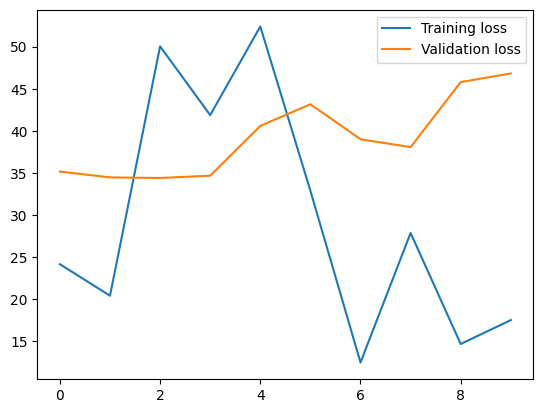

Test Loss: 53.31442405155727
Mean Absolute Error: 5.56
Accuracy: 50.63 %.
Mean Squared Error: 53.39
Root Mean Squared Error: 7.31
R2: -0.39


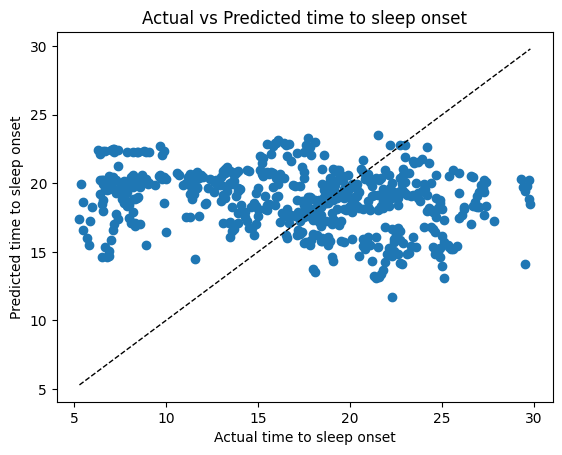

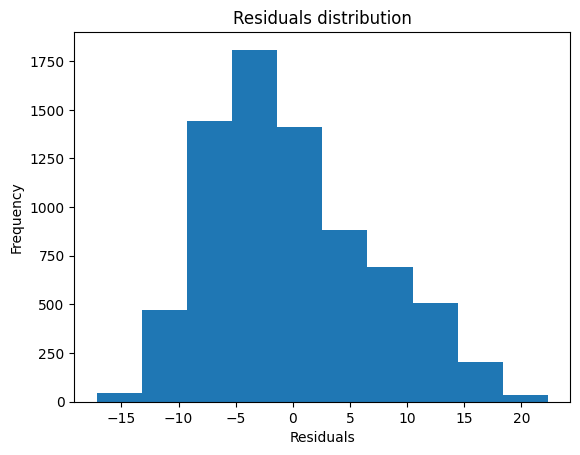

Hidden size: 256
(559, 70, 68)
35
Epoch 1/10, Loss: 38.07845687866211, Validation Loss: 34.07517614364624
Epoch 2/10, Loss: 26.560745239257812, Validation Loss: 34.54621753692627
Epoch 3/10, Loss: 68.9994125366211, Validation Loss: 34.582341236538355
Epoch 4/10, Loss: 27.1877384185791, Validation Loss: 35.16208119392395
Epoch 5/10, Loss: 33.456722259521484, Validation Loss: 34.85611731741164
Epoch 6/10, Loss: 40.8275146484375, Validation Loss: 35.369401110543144
Epoch 7/10, Loss: 23.79050636291504, Validation Loss: 37.29757117960188
Epoch 8/10, Loss: 54.606964111328125, Validation Loss: 41.47287018696467
Epoch 9/10, Loss: 28.072338104248047, Validation Loss: 56.896382300059
Epoch 10/10, Loss: 15.954155921936035, Validation Loss: 60.85287030802833


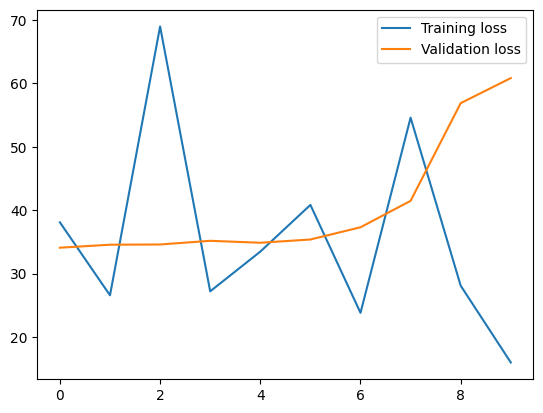

Test Loss: 50.15096081324986
Mean Absolute Error: 6.15
Accuracy: 59.04 %.
Mean Squared Error: 50.23
Root Mean Squared Error: 7.09
R2: -0.31


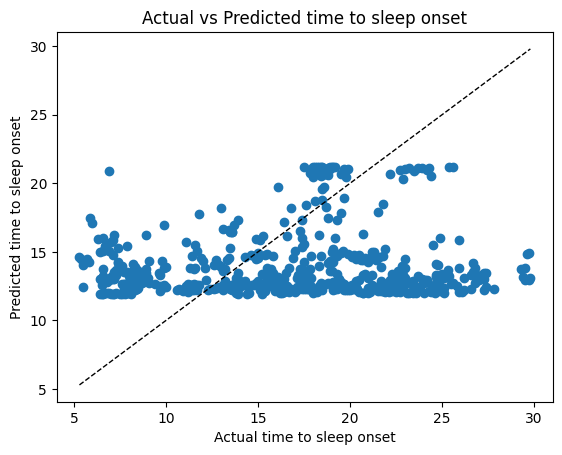

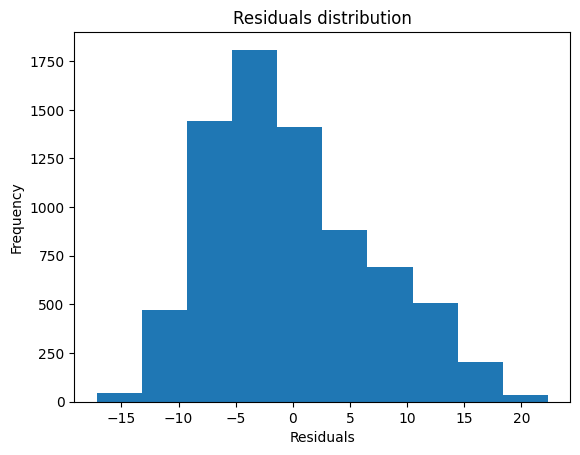

In [188]:
# Try different hidden sizes for 7 minutes window size model

hidden_sizes = [64, 128, 256]
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
for hidden_size in hidden_sizes:
    print('Hidden size: {}'.format(hidden_size))

    # Train the model
    train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(mydata, num_epochs=10, hidden_size=hidden_size, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=16, device=device, random_seed=42, window_size_minutes=7, iftest=1)

    

## Hyperparameter tuning using WandB bayesian optimisation (only 2-5 minute windows included) ##

In [ ]:
!pip install wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 6.7 MB/s eta 0:00:0000:0100:01
  Using cached click-8.1.3-py3-none-any.whl (96 kB)
  Using cached GitPython-3.1.31-py3-none-any.whl (184 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 209.4/209.4 kB 4.8 MB/s eta 0:00:0000:01
  Using cached docker_pycreds-0.4.0-py2.py3-none-any.whl (9.0 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.5/167.5 kB 8.6 MB/s eta 0:00:00
  Using cached pathtools-0.1.2.tar.gz (11 kB)
  Preparing metadata (setup.py) ... done
  Using cached appdirs-1.4.4-py2.py3-none-any.whl (9.6 kB)
  Using cached gitdb-4.0.10-py3-none-any.whl (62 kB)
  Using cached smmap-5.0.0-py3-none-any.whl (24 kB)
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8791 sha256=acfa61b46619a543a8326252f52056697ccff6587f14e06c1db3d9a39e71afec
  Stored in directory: /Users/anastasia/Library/Caches/pip/wheels/ea/b7/8b/84e94095ea418b9442f5abeba4ca7b0ad52d3fe7b69d6238a6
Successfully built pathtools


In [12]:
import wandb

In [13]:

# login to wandb
wandb.login(key="a18126ca7a6f1fe683e47a1e2f0e546590106fb3")
WAND_API_KEY = "a18126ca7a6f1fe683e47a1e2f0e546590106fb3"






Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: anastasia-ilina2902 (drug_discovery_ai). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /Users/anastasia/.netrc


In [14]:
wandb.init(project="sleep-onset-detection")

In [15]:
import sklearn
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Create sweep with ID: c5f3f50w
Sweep URL: https://wandb.ai/drug_discovery_ai/sleep-onset-detection/sweeps/c5f3f50w
Create sweep with ID: 0tp6auov
Sweep URL: https://wandb.ai/drug_discovery_ai/my_project/sweeps/0tp6auov


wandb: Agent Starting Run: vbchbg5a with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0.2
wandb: 	hidden_size: 256
wandb: 	l2: 0
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: anastasia-ilina2902 (drug_discovery_ai). Use `wandb login --relogin` to force relogin


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 129.8914031982422, Validation Loss: 86.47518703608746
----------------------------------------------------------------------------------------------------
Validation MAPE: 281.4829349517822, Validation MAE: 8.8784761428833, Validation Accuracy: -181.48293495178223
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 79.22476959228516, Validation Loss: 85.58398163137097
----------------------------------------------------------------------------------------------------
Validation MAPE: 266.3863182067871, Validation MAE: 9.068509101867676, Validation Accuracy: -166.3863182067871
----------------------------------------------------------------------------------------------------

---------------------------

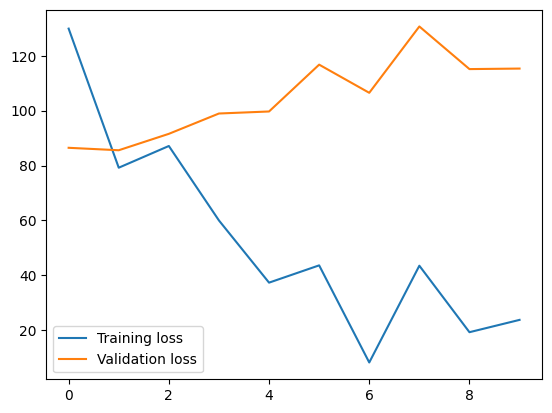

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-117.85207
mae,9.58356
mape,217.85207
val_loss,85.58398


wandb: Agent Starting Run: ftpjssla with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0.1
wandb: 	hidden_size: 64
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 116.79936981201172, Validation Loss: 89.40809131778033
----------------------------------------------------------------------------------------------------
Validation MAPE: 297.43549823760986, Validation MAE: 8.541669845581055, Validation Accuracy: -197.43549823760986
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 70.57964324951172, Validation Loss: 89.19114192548741
----------------------------------------------------------------------------------------------------
Validation MAPE: 301.7307758331299, Validation MAE: 8.53658676147461, Validation Accuracy: -201.73077583312988
----------------------------------------------------------------------------------------------------

-----------------------

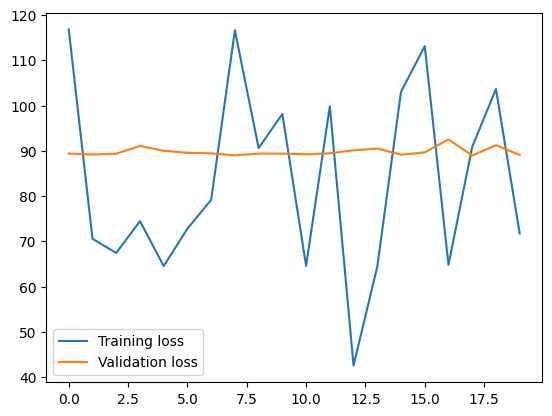

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-204.17821
mae,8.53439
mape,304.17821
val_loss,88.97166


wandb: Agent Starting Run: 4v2pbw7s with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0
wandb: 	hidden_size: 128
wandb: 	l2: 0.1
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 108.05706024169922, Validation Loss: 73.92088530681751
----------------------------------------------------------------------------------------------------
Validation MAPE: 69.12868022918701, Validation MAE: 7.6008734703063965, Validation Accuracy: 30.87131977081299
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 99.56046295166016, Validation Loss: 69.1198159677011
----------------------------------------------------------------------------------------------------
Validation MAPE: 69.59540843963623, Validation MAE: 7.227556228637695, Validation Accuracy: 30.40459156036377
----------------------------------------------------------------------------------------------------

---------------------------

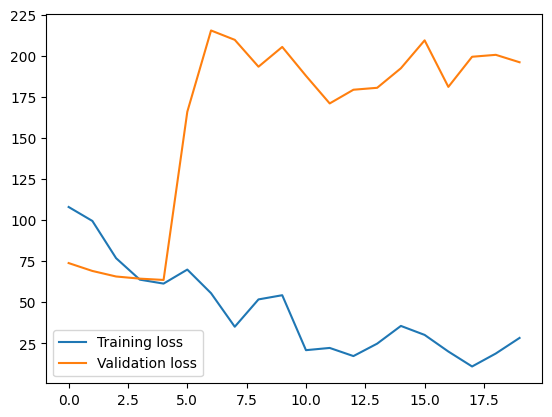

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,23.5669
mae,12.05233
mape,76.4331
val_loss,63.64628


wandb: Agent Starting Run: hmqcf32p with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0.5
wandb: 	hidden_size: 128
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 49.036827087402344, Validation Loss: 101.58122839751067
----------------------------------------------------------------------------------------------------
Validation MAPE: 68.79409551620483, Validation MAE: 9.054901123046875, Validation Accuracy: 31.205904483795166
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 103.43467712402344, Validation Loss: 143.3103049242938
----------------------------------------------------------------------------------------------------
Validation MAPE: 72.10467457771301, Validation MAE: 10.443078994750977, Validation Accuracy: 27.895325422286987
----------------------------------------------------------------------------------------------------

----------------------

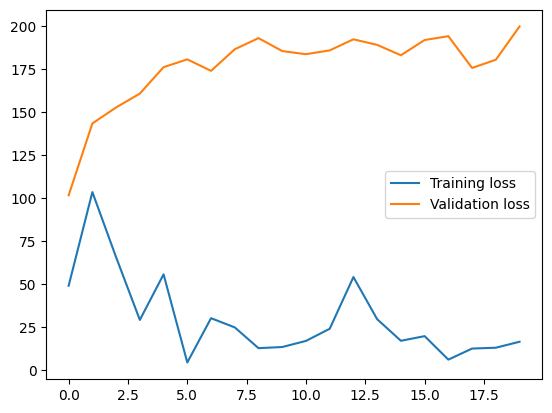

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,23.88957
mae,12.2503
mape,76.11043
val_loss,101.58123


wandb: Agent Starting Run: as69hgca with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.1
wandb: 	hidden_size: 32
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 1
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 168.7773895263672, Validation Loss: 134.15265743857935
----------------------------------------------------------------------------------------------------
Validation MAPE: 554.2237281799316, Validation MAE: 10.008455276489258, Validation Accuracy: -454.22372817993164
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 126.44759368896484, Validation Loss: 92.27868214657433
----------------------------------------------------------------------------------------------------
Validation MAPE: 425.5633354187012, Validation MAE: 8.598892211914062, Validation Accuracy: -325.5633354187012
----------------------------------------------------------------------------------------------------

----------------------

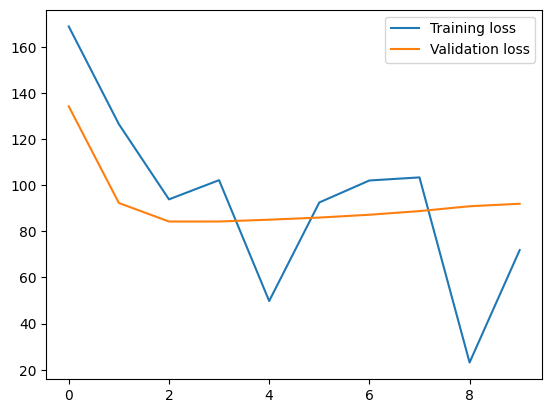

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-219.21413
mae,8.20106
mape,319.21413
val_loss,84.24591


wandb: Agent Starting Run: 3y369rzw with config:
wandb: 	batch_size: 4
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 1
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 90.75455474853516, Validation Loss: 89.38509734734387
----------------------------------------------------------------------------------------------------
Validation MAPE: 70.1421320438385, Validation MAE: 8.597336769104004, Validation Accuracy: 29.8578679561615
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 35.972747802734375, Validation Loss: 128.91510452787267
----------------------------------------------------------------------------------------------------
Validation MAPE: 69.58633065223694, Validation MAE: 10.099529266357422, Validation Accuracy: 30.41366934776306
----------------------------------------------------------------------------------------------------

---------------------------

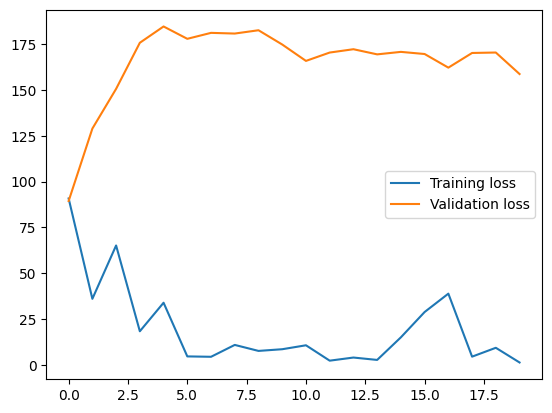

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,25.8939
mae,11.05222
mape,74.1061
val_loss,89.3851


wandb: Agent Starting Run: pv4zfc96 with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.1
wandb: 	hidden_size: 64
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 151.13389587402344, Validation Loss: 159.98220294230694
----------------------------------------------------------------------------------------------------
Validation MAPE: 518.1079387664795, Validation MAE: 10.455913543701172, Validation Accuracy: -418.1079387664795
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 80.73306274414062, Validation Loss: 93.11080824362266
----------------------------------------------------------------------------------------------------
Validation MAPE: 360.0977659225464, Validation MAE: 8.584064483642578, Validation Accuracy: -260.0977659225464
----------------------------------------------------------------------------------------------------

-----------------------

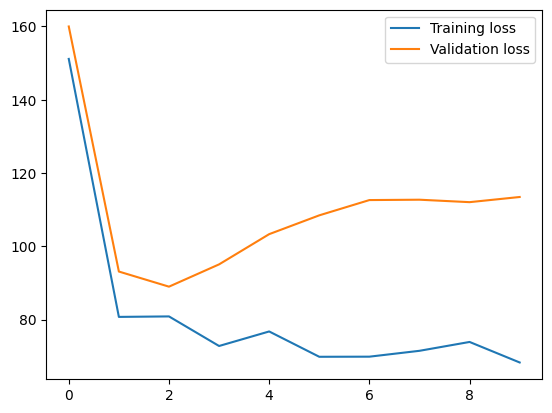

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-185.65364
mae,8.79432
mape,285.65364
val_loss,88.98433


wandb: Agent Starting Run: xsjia40v with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0.2
wandb: 	hidden_size: 32
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 39.33437728881836, Validation Loss: 89.2355170817794
----------------------------------------------------------------------------------------------------
Validation MAPE: 296.60842418670654, Validation MAE: 8.542829513549805, Validation Accuracy: -196.60842418670654
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 84.68328857421875, Validation Loss: 88.6248413122989
----------------------------------------------------------------------------------------------------
Validation MAPE: 301.1204719543457, Validation MAE: 8.537367820739746, Validation Accuracy: -201.1204719543457
----------------------------------------------------------------------------------------------------

--------------------------

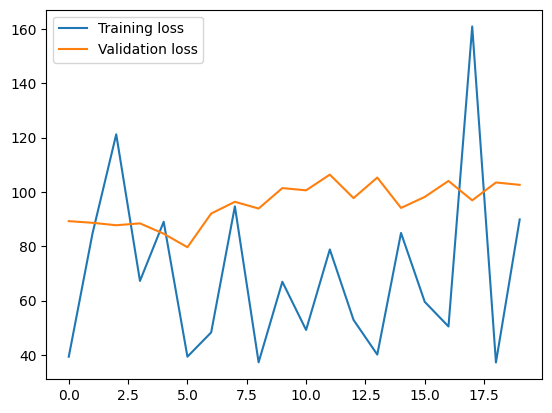

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-289.98652
mae,9.73897
mape,389.98652
val_loss,79.6386


wandb: Agent Starting Run: yknu2cee with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0
wandb: 	hidden_size: 64
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 70.3883056640625, Validation Loss: 67.15811961668508
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.31099700927734, Validation MAE: 7.256945610046387, Validation Accuracy: 28.689002990722656
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 58.58808898925781, Validation Loss: 114.55048449834187
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.26718759536743, Validation MAE: 9.534467697143555, Validation Accuracy: 28.73281240463257
----------------------------------------------------------------------------------------------------

---------------------------

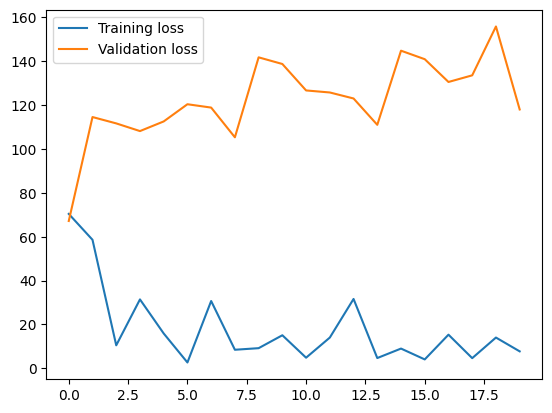

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,23.73739
mae,9.23691
mape,76.26261
val_loss,67.15812


wandb: Agent Starting Run: gc4t1luo with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.1
wandb: 	hidden_size: 256
wandb: 	l2: 0.1
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 40.82147216796875, Validation Loss: 64.2667908138699
----------------------------------------------------------------------------------------------------
Validation MAPE: 70.49153447151184, Validation MAE: 6.804924964904785, Validation Accuracy: 29.50846552848816
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 33.67889404296875, Validation Loss: 62.75735819781268
----------------------------------------------------------------------------------------------------
Validation MAPE: 70.93462347984314, Validation MAE: 6.676513195037842, Validation Accuracy: 29.06537652015686
----------------------------------------------------------------------------------------------------

-----------------------------

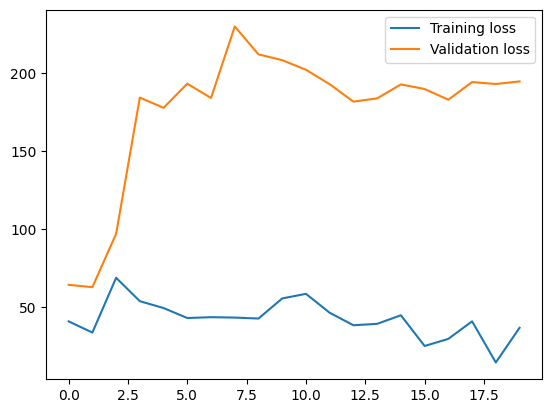

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,19.35683
mae,11.94749
mape,80.64317
val_loss,62.75736


wandb: Agent Starting Run: 8d2r4nin with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.1
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 76.83304595947266, Validation Loss: 89.90759537671063
----------------------------------------------------------------------------------------------------
Validation MAPE: 288.8878583908081, Validation MAE: 8.556218147277832, Validation Accuracy: -188.8878583908081
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 63.02793502807617, Validation Loss: 89.20564924704063
----------------------------------------------------------------------------------------------------
Validation MAPE: 296.5827941894531, Validation MAE: 8.542930603027344, Validation Accuracy: -196.58279418945312
----------------------------------------------------------------------------------------------------

-------------------------

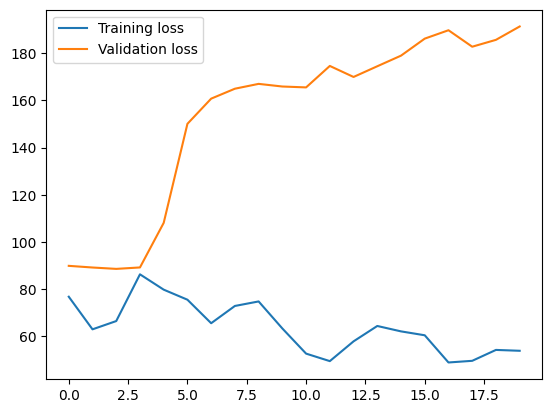

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-81.22121
mae,10.39829
mape,181.22121
val_loss,88.62251


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gc7aiim9 with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0
wandb: 	hidden_size: 128
wandb: 	l2: 0.2
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 40.30691146850586, Validation Loss: 72.29649834058903
----------------------------------------------------------------------------------------------------
Validation MAPE: 69.44594979286194, Validation MAE: 7.606499671936035, Validation Accuracy: 30.55405020713806
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 37.311458587646484, Validation Loss: 103.176523870892
----------------------------------------------------------------------------------------------------
Validation MAPE: 68.30605864524841, Validation MAE: 9.16282844543457, Validation Accuracy: 31.693941354751587
----------------------------------------------------------------------------------------------------

----------------------------

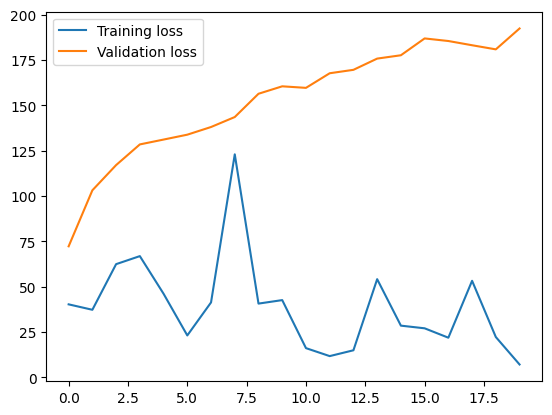

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,29.38235
mae,12.18036
mape,70.61765
val_loss,72.2965


wandb: Agent Starting Run: 9fjghix2 with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0.1
wandb: 	hidden_size: 64
wandb: 	l2: 0.2
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 41.348628997802734, Validation Loss: 66.26036360528734
----------------------------------------------------------------------------------------------------
Validation MAPE: 69.99692916870117, Validation MAE: 6.995121479034424, Validation Accuracy: 30.003070831298828
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 80.81905364990234, Validation Loss: 65.553539775036
----------------------------------------------------------------------------------------------------
Validation MAPE: 70.14890313148499, Validation MAE: 6.928467750549316, Validation Accuracy: 29.851096868515015
----------------------------------------------------------------------------------------------------

---------------------------

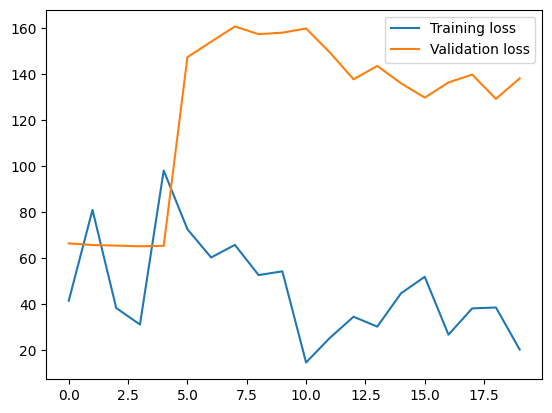

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,25.50611
mae,10.02325
mape,74.49389
val_loss,64.98762


wandb: Agent Starting Run: vbkzkr5l with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.2
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 69.72311401367188, Validation Loss: 61.729133959169744
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.47327065467834, Validation MAE: 6.549213886260986, Validation Accuracy: 28.526729345321655
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 80.20230865478516, Validation Loss: 64.90660914668331
----------------------------------------------------------------------------------------------------
Validation MAPE: 70.2744722366333, Validation MAE: 6.887737274169922, Validation Accuracy: 29.7255277633667
----------------------------------------------------------------------------------------------------

----------------------------

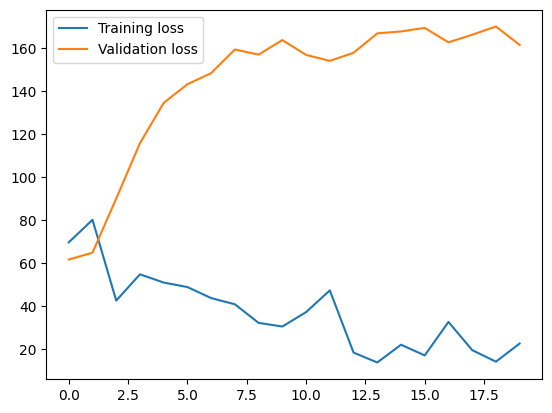

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,19.76472
mae,11.16785
mape,80.23528
val_loss,61.72913


wandb: Agent Starting Run: uop08qq4 with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0.2
wandb: 	hidden_size: 64
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 33.25690841674805, Validation Loss: 86.03473670394332
----------------------------------------------------------------------------------------------------
Validation MAPE: 104.38843965530396, Validation MAE: 7.076456069946289, Validation Accuracy: -4.388439655303955
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 74.3206787109375, Validation Loss: 57.30723758538564
----------------------------------------------------------------------------------------------------
Validation MAPE: 77.01174020767212, Validation MAE: 6.002799034118652, Validation Accuracy: 22.98825979232788
----------------------------------------------------------------------------------------------------

---------------------------

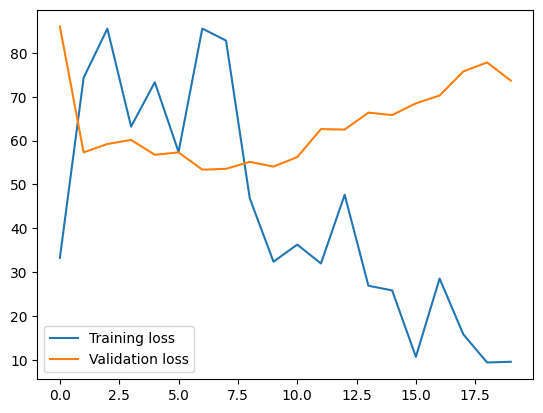

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,23.07306
mae,8.0543
mape,76.92694
val_loss,53.3689


wandb: Agent Starting Run: ydbbexeo with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.2
wandb: 	hidden_size: 256
wandb: 	l2: 0.2
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 61.90758514404297, Validation Loss: 60.75680979975947
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.96317315101624, Validation MAE: 6.456541538238525, Validation Accuracy: 28.036826848983765
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 64.99340057373047, Validation Loss: 59.79432148403592
----------------------------------------------------------------------------------------------------
Validation MAPE: 72.17285633087158, Validation MAE: 6.452116966247559, Validation Accuracy: 27.827143669128418
----------------------------------------------------------------------------------------------------

--------------------------

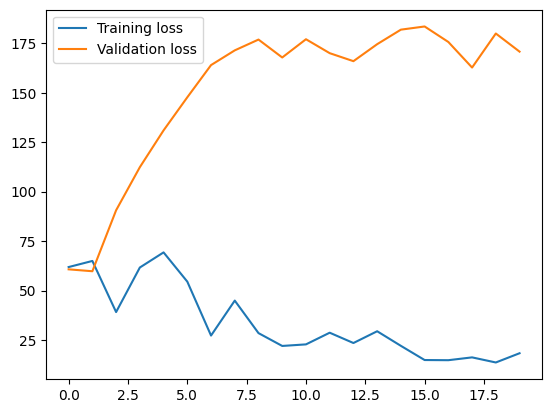

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,24.48285
mae,11.30744
mape,75.51715
val_loss,59.79432


wandb: Agent Starting Run: dkzuwafn with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0.2
wandb: 	hidden_size: 128
wandb: 	l2: 0.1
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 60.867149353027344, Validation Loss: 61.99225259268725
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.24251127243042, Validation MAE: 6.599005699157715, Validation Accuracy: 28.75748872756958
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 116.45206451416016, Validation Loss: 60.52463852696948
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.94522619247437, Validation MAE: 6.459586143493652, Validation Accuracy: 28.054773807525635
----------------------------------------------------------------------------------------------------

-------------------------

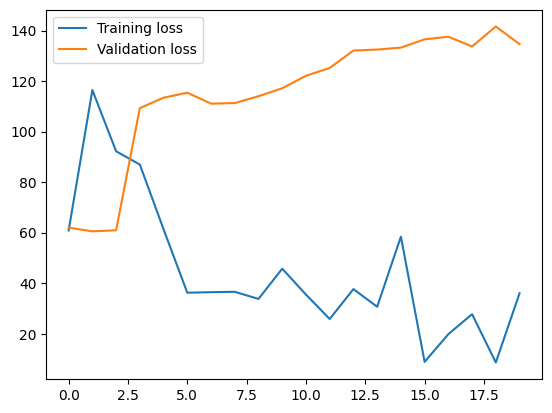

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,27.51756
mae,10.1972
mape,72.48244
val_loss,60.52464


wandb: Agent Starting Run: 7ev8lb3h with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.2
wandb: 	hidden_size: 32
wandb: 	l2: 0.1
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 79.59525299072266, Validation Loss: 78.2749752468533
----------------------------------------------------------------------------------------------------
Validation MAPE: 68.80338191986084, Validation MAE: 7.882437705993652, Validation Accuracy: 31.19661808013916
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 74.68387603759766, Validation Loss: 61.96507107770002
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.36338353157043, Validation MAE: 6.57234525680542, Validation Accuracy: 28.636616468429565
----------------------------------------------------------------------------------------------------

-----------------------------

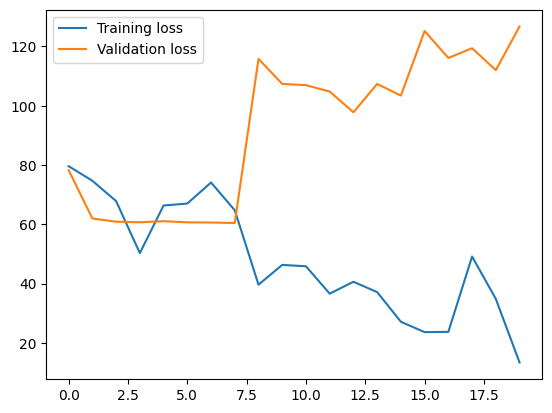

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,28.06634
mae,9.81635
mape,71.93366
val_loss,60.4371


wandb: Agent Starting Run: 6wntnjay with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.2
wandb: 	hidden_size: 64
wandb: 	l2: 0.2
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 70.94387817382812, Validation Loss: 89.34755044370084
----------------------------------------------------------------------------------------------------
Validation MAPE: 296.5543508529663, Validation MAE: 8.54290771484375, Validation Accuracy: -196.5543508529663
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 96.4799575805664, Validation Loss: 88.30431193274421
----------------------------------------------------------------------------------------------------
Validation MAPE: 301.7862558364868, Validation MAE: 8.536951065063477, Validation Accuracy: -201.78625583648682
----------------------------------------------------------------------------------------------------

---------------------------

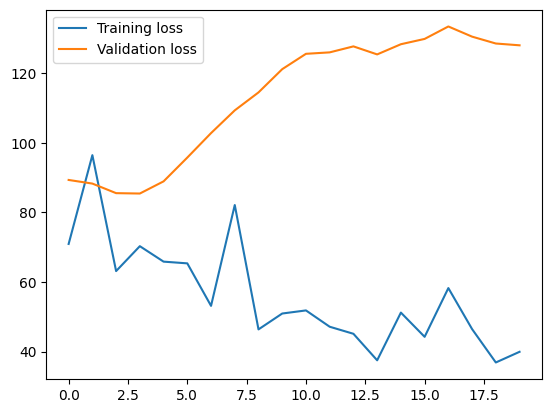

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-237.92703
mae,9.65128
mape,337.92703
val_loss,85.44364


wandb: Agent Starting Run: euas99cj with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.2
wandb: 	hidden_size: 32
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 71.69493103027344, Validation Loss: 60.72547439292625
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.93122506141663, Validation MAE: 6.462010383605957, Validation Accuracy: 28.068774938583374
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 74.56788635253906, Validation Loss: 62.11352793375651
----------------------------------------------------------------------------------------------------
Validation MAPE: 70.99284529685974, Validation MAE: 6.673752307891846, Validation Accuracy: 29.00715470314026
----------------------------------------------------------------------------------------------------

---------------------------

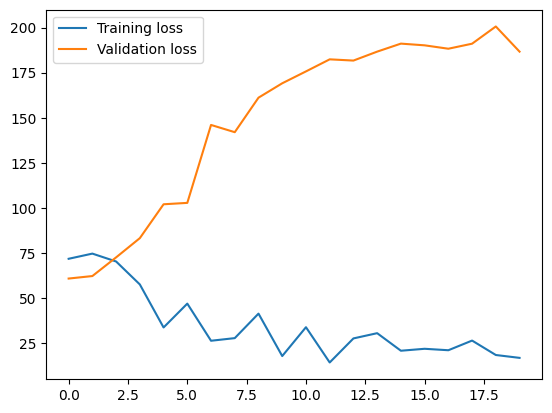

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,27.88585
mae,11.87291
mape,72.11415
val_loss,60.72547


wandb: Agent Starting Run: 5pt939bp with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0.5
wandb: 	hidden_size: 32
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 57.364418029785156, Validation Loss: 57.83020623153615
----------------------------------------------------------------------------------------------------
Validation MAPE: 77.33563780784607, Validation MAE: 5.99012565612793, Validation Accuracy: 22.66436219215393
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 51.498600006103516, Validation Loss: 60.72079945724701
----------------------------------------------------------------------------------------------------
Validation MAPE: 72.14122414588928, Validation MAE: 6.427347660064697, Validation Accuracy: 27.858775854110718
----------------------------------------------------------------------------------------------------

--------------------------

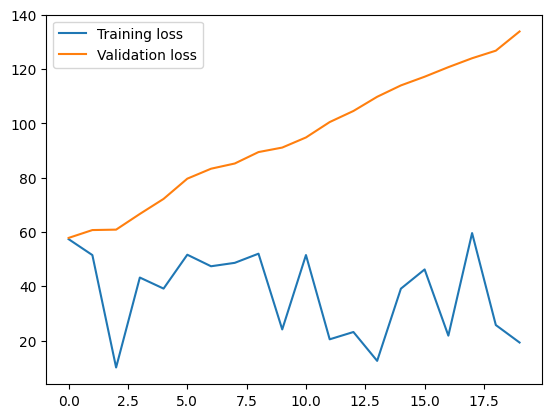

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,29.14025
mae,10.2193
mape,70.85975
val_loss,57.83021


wandb: Agent Starting Run: ekdh4e76 with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.1
wandb: 	hidden_size: 32
wandb: 	l2: 0
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 288.2611389160156, Validation Loss: 381.56333640769674
----------------------------------------------------------------------------------------------------
Validation MAPE: 96.22306227684021, Validation MAE: 17.976165771484375, Validation Accuracy: 3.77693772315979
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 250.4253387451172, Validation Loss: 329.3300981874819
----------------------------------------------------------------------------------------------------
Validation MAPE: 85.31317114830017, Validation MAE: 16.47517204284668, Validation Accuracy: 14.686828851699829
----------------------------------------------------------------------------------------------------

--------------------------

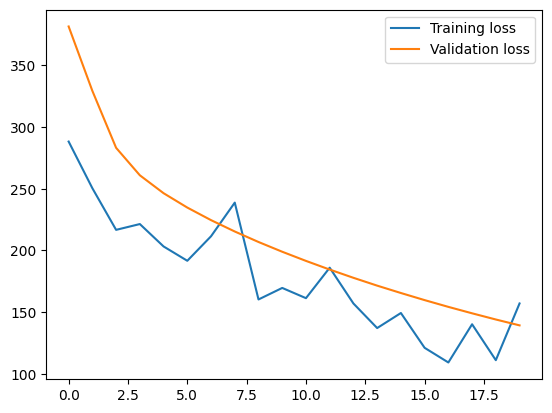

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,33.65105
mae,10.61551
mape,66.34895
val_loss,139.25003


wandb: Agent Starting Run: u9iljv2g with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0.5
wandb: 	hidden_size: 64
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 130.51544189453125, Validation Loss: 57.833202495753206
----------------------------------------------------------------------------------------------------
Validation MAPE: 77.29783654212952, Validation MAE: 5.991499423980713, Validation Accuracy: 22.702163457870483
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 109.90721893310547, Validation Loss: 60.928774886042156
----------------------------------------------------------------------------------------------------
Validation MAPE: 72.00305461883545, Validation MAE: 6.449708938598633, Validation Accuracy: 27.99694538116455
----------------------------------------------------------------------------------------------------

-----------------------

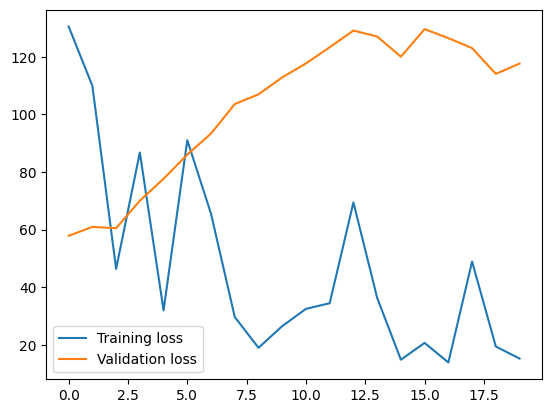

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,22.12162
mae,9.06768
mape,77.87838
val_loss,57.8332


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8kf51sbl with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0.5
wandb: 	hidden_size: 256
wandb: 	l2: 0.2
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 5
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 36.55834197998047, Validation Loss: 63.44610995275003
----------------------------------------------------------------------------------------------------
Validation MAPE: 70.60717940330505, Validation MAE: 6.775249004364014, Validation Accuracy: 29.392820596694946
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 77.11529541015625, Validation Loss: 101.66297918778879
----------------------------------------------------------------------------------------------------
Validation MAPE: 68.65434050559998, Validation MAE: 9.036713600158691, Validation Accuracy: 31.345659494400024
----------------------------------------------------------------------------------------------------

-------------------------

wandb: Ctrl + C detected. Stopping sweep.


----------------------------------------------------------------------------------------------------
Epoch 10/20, Loss: 16.82470703125, Validation Loss: 172.60745756714434
----------------------------------------------------------------------------------------------------
Validation MAPE: 74.12512302398682, Validation MAE: 11.181597709655762, Validation Accuracy: 25.874876976013184
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 11/20, Loss: 39.516334533691406, Validation Loss: 172.8797537309152
----------------------------------------------------------------------------------------------------
Validation MAPE: 74.6756374835968, Validation MAE: 11.156571388244629, Validation Accuracy: 25.3243625164032
----------------------------------------------------------------------------------------------------

--------------------------

In [32]:
# Hyperparameter tuning in wandb
sweep_config = {
    'method': 'bayes',
    'metric': {
        'name': 'val_loss',
        'goal': 'minimize'
    },
    'parameters': {
        'hidden_size': {
            'values': [32, 64, 128, 256]
        },
        'window_size_minutes': {
            'values': [1, 2, 5]
        },
        'num_layers': {
            'values': [1, 2, 3]
        },
        'dropout': {
            'values': [0.0, 0.1, 0.2, 0.5]
        },
        'l2': {
            'values': [0.0, 0.1, 0.2, 0.5]
        },
        'lr': {
            'values': [0.001, 0.0001]
        },
        'weight_decay': {
            'values': [0.0, 0.1, 0.2, 0.5]

        },
        'batch_size': {
            'values': [4, 8, 16, 32, 64]
        
        }, 
        'num_epochs': {
            'values': [10, 20]
    
    }
}
}



sweep_id = wandb.sweep(sweep_config, project="sleep-onset-detection")

def train_and_eval(config=None):
    with wandb.init(config=config):
        config = wandb.config
        train_losses, val_losses, model, accuracy, mape, mae = training_loop_feature_RNN(mydata, config.num_epochs, config.hidden_size, config.num_layers, config.dropout, config.l2, config.lr, config.weight_decay, config.batch_size, device, window_size_minutes=config.window_size_minutes)
        wandb.log({"val_loss": min(val_losses), "accuracy": accuracy, "mape": mape, "mae": mae})

sweep_id = wandb.sweep(sweep_config, project="my_project")

# Run the sweep
wandb.agent(sweep_id, function=train_and_eval)

    


## Hyperparameter tuning using WandB bayesian optimisation (10 minute windows included) ##

Create sweep with ID: dc8ak2de
Sweep URL: https://wandb.ai/drug_discovery_ai/sleep-onset-detection/sweeps/dc8ak2de


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


Create sweep with ID: vw3snvmj
Sweep URL: https://wandb.ai/drug_discovery_ai/my_project/sweeps/vw3snvmj
<IPython.core.display.HTML object>
<IPython.core.display.HTML object>
<IPython.core.display.HTML object>


wandb: Agent Starting Run: 6usf71j0 with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0.1
wandb: 	hidden_size: 128
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 7


Exception in thread NetStatThr:
Traceback (most recent call last):
Exception in thread   File "/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/threading.py", line 1038, in _bootstrap_inner
ChkStopThr:
Traceback (most recent call last):
  File "/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/threading.py", line 1038, in _bootstrap_inner
        self.run()self.run()

  File "/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/threading.py", line 975, in run
  File "/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/wandb/sdk/wandb_run.py", line 275, in check_stop_status
    self._target(*self._args, **self._kwargs)
    self._loop_check_status(  File "/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/l

----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 75.41873168945312, Validation Loss: 30.682445653279622
----------------------------------------------------------------------------------------------------
Validation MAPE: 23.782627284526825, Validation MAE: 4.203724384307861, Validation Accuracy: 76.21737271547318
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 36.060237884521484, Validation Loss: 25.593038198682997
----------------------------------------------------------------------------------------------------
Validation MAPE: 22.5951686501503, Validation MAE: 3.7387521266937256, Validation Accuracy: 77.4048313498497
----------------------------------------------------------------------------------------------------

-------------------------

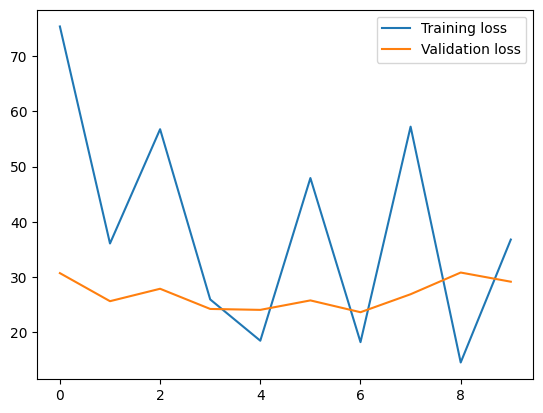

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,76.62061
mae,4.06552
mape,23.37939
val_loss,23.59146


wandb: Agent Starting Run: 1f2opl87 with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0.5
wandb: 	hidden_size: 64
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 1
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 2


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/rnn.py:71: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn("dropout option adds dropout after all but last "


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 75.74424743652344, Validation Loss: 85.92971987096038
----------------------------------------------------------------------------------------------------
Validation MAPE: 280.41412830352783, Validation MAE: 8.96755313873291, Validation Accuracy: -180.41412830352783
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 51.60329818725586, Validation Loss: 94.79535762683766
----------------------------------------------------------------------------------------------------
Validation MAPE: 283.1472635269165, Validation MAE: 9.314953804016113, Validation Accuracy: -183.1472635269165
----------------------------------------------------------------------------------------------------

-------------------------

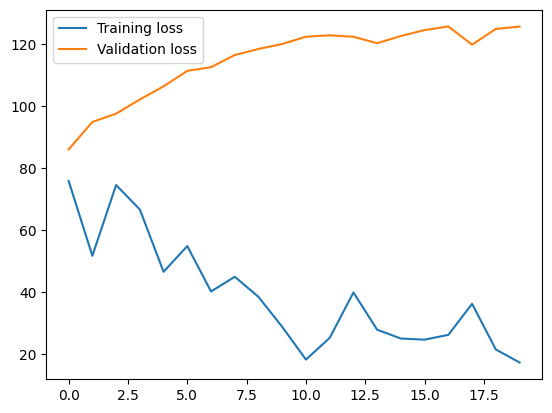

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,-253.13969
mae,10.71519
mape,353.13969
val_loss,85.92972


wandb: Agent Starting Run: 0ibmjw2f with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.1
wandb: 	hidden_size: 32
wandb: 	l2: 0
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 5


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 182.86441040039062, Validation Loss: 209.16274982028537
----------------------------------------------------------------------------------------------------
Validation MAPE: 65.9924566745758, Validation MAE: 12.73267650604248, Validation Accuracy: 34.007543325424194
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 144.16412353515625, Validation Loss: 141.2871321218985
----------------------------------------------------------------------------------------------------
Validation MAPE: 66.30220413208008, Validation MAE: 10.685361862182617, Validation Accuracy: 33.69779586791992
----------------------------------------------------------------------------------------------------

------------------------

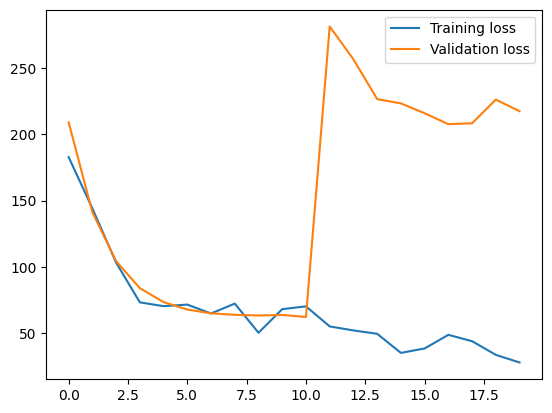

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,20.56333
mae,12.66932
mape,79.43667
val_loss,62.02824


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 0ubjlcdw with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0.1
wandb: 	hidden_size: 256
wandb: 	l2: 0
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0
wandb: 	window_size_minutes: 5


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 33.68655014038086, Validation Loss: 62.17173332992558
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.35936617851257, Validation MAE: 6.573217868804932, Validation Accuracy: 28.640633821487427
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 80.18986511230469, Validation Loss: 61.60519584679158
----------------------------------------------------------------------------------------------------
Validation MAPE: 71.62364721298218, Validation MAE: 6.518411636352539, Validation Accuracy: 28.376352787017822
----------------------------------------------------------------------------------------------------

--------------------------

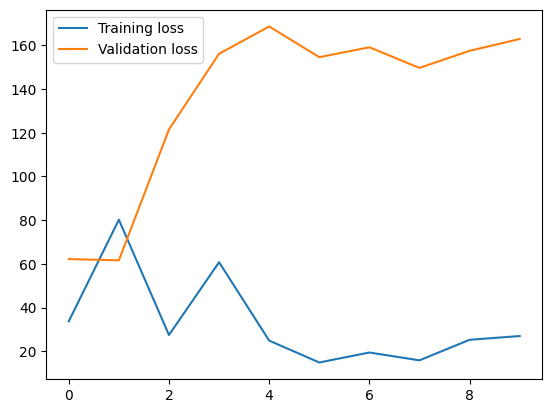

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,25.67523
mae,11.26823
mape,74.32477
val_loss,61.6052


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: pbfdmsgl with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0.2
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 1004.3638916015625, Validation Loss: 993.6765899658203
----------------------------------------------------------------------------------------------------
Validation MAPE: 151.41198635101318, Validation MAE: 31.28125, Validation Accuracy: -51.411986351013184
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 940.3212890625, Validation Loss: 835.2947540283203
----------------------------------------------------------------------------------------------------
Validation MAPE: 138.78835439682007, Validation MAE: 28.64884376525879, Validation Accuracy: -38.78835439682007
----------------------------------------------------------------------------------------------------

----------------------------------

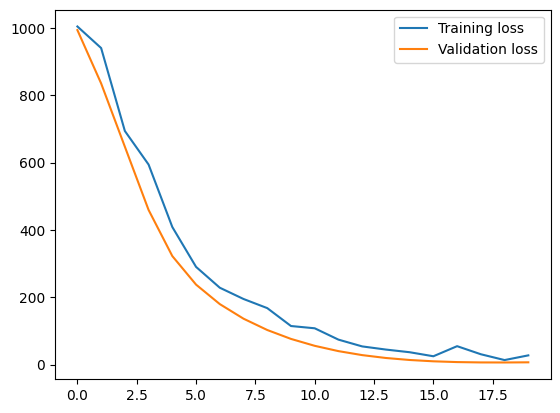

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,92.28108
mae,1.74985
mape,7.71892
val_loss,6.20214


wandb: Agent Starting Run: wsbi426f with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0.2
wandb: 	hidden_size: 128
wandb: 	l2: 0.2
wandb: 	lr: 0.0001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 7


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 41.035579681396484, Validation Loss: 30.249934095806545
----------------------------------------------------------------------------------------------------
Validation MAPE: 23.682120442390442, Validation MAE: 4.1698784828186035, Validation Accuracy: 76.31787955760956
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 50.654327392578125, Validation Loss: 29.987834437688193
----------------------------------------------------------------------------------------------------
Validation MAPE: 23.610828816890717, Validation MAE: 4.146331310272217, Validation Accuracy: 76.38917118310928
----------------------------------------------------------------------------------------------------

---------------------

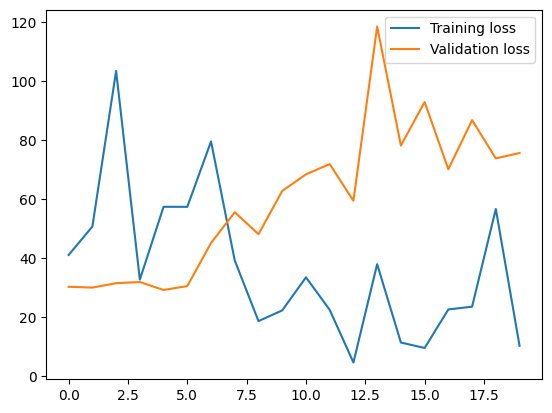

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,63.44551
mae,6.81444
mape,36.55449
val_loss,29.1783


wandb: Agent Starting Run: 6ktqbyy1 with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0.2
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 544.3633422851562, Validation Loss: 466.89447239467074
----------------------------------------------------------------------------------------------------
Validation MAPE: 104.02412414550781, Validation MAE: 21.399456024169922, Validation Accuracy: -4.0241241455078125
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 180.35618591308594, Validation Loss: 147.65156745910645
----------------------------------------------------------------------------------------------------
Validation MAPE: 58.09053182601929, Validation MAE: 11.820920944213867, Validation Accuracy: 41.90946817398071
----------------------------------------------------------------------------------------------------

--------------------

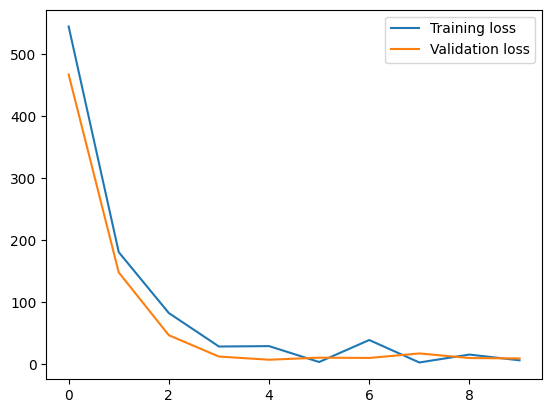

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,91.32831
mae,1.98962
mape,8.67169
val_loss,6.8436


wandb: Agent Starting Run: jrnsdnpr with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 942.6141967773438, Validation Loss: 842.8555385044643
----------------------------------------------------------------------------------------------------
Validation MAPE: 139.82691764831543, Validation MAE: 28.86541748046875, Validation Accuracy: -39.82691764831543
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 615.9140625, Validation Loss: 474.16580636160717
----------------------------------------------------------------------------------------------------
Validation MAPE: 104.84291315078735, Validation MAE: 21.57019805908203, Validation Accuracy: -4.8429131507873535
----------------------------------------------------------------------------------------------------

----------------------------

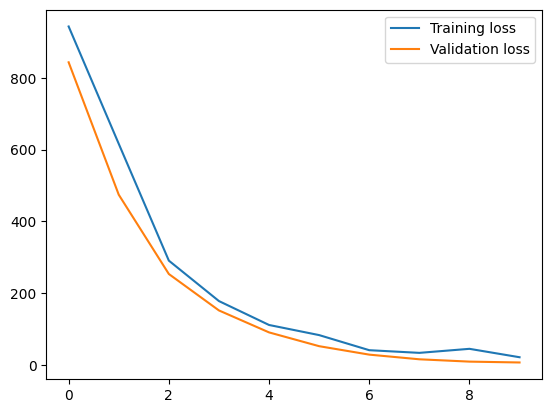

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,91.26969
mae,1.86244
mape,8.73031
val_loss,6.98052


wandb: Agent Starting Run: a5hl3lvr with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 194.64697265625, Validation Loss: 103.94114412580218
----------------------------------------------------------------------------------------------------
Validation MAPE: 48.436522483825684, Validation MAE: 9.807767868041992, Validation Accuracy: 51.563477516174316
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 98.93815612792969, Validation Loss: 25.94477108546666
----------------------------------------------------------------------------------------------------
Validation MAPE: 23.8740012049675, Validation MAE: 4.818930625915527, Validation Accuracy: 76.1259987950325
----------------------------------------------------------------------------------------------------

-----------------------------

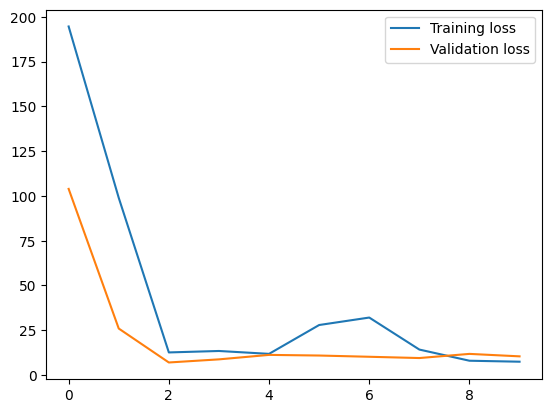

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,90.10196
mae,2.26916
mape,9.89804
val_loss,6.98722


wandb: Agent Starting Run: hz7i145p with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 1
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 52.8790168762207, Validation Loss: 81.04817867279053
----------------------------------------------------------------------------------------------------
Validation MAPE: 41.02158546447754, Validation MAE: 8.846939086914062, Validation Accuracy: 58.97841453552246
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 11.00435733795166, Validation Loss: 25.172168493270874
----------------------------------------------------------------------------------------------------
Validation MAPE: 20.478932559490204, Validation MAE: 4.550574779510498, Validation Accuracy: 79.5210674405098
----------------------------------------------------------------------------------------------------

----------------------------

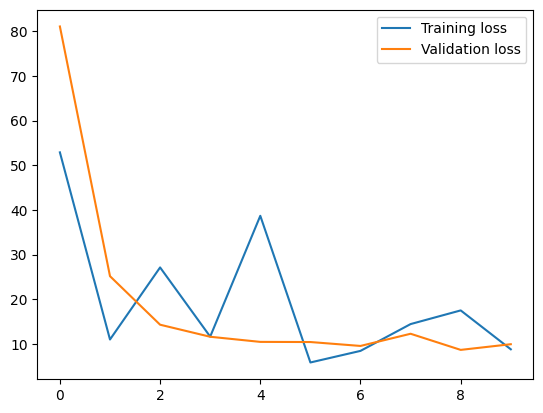

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,89.44853
mae,2.41446
mape,10.55147
val_loss,8.6794


wandb: Agent Starting Run: j8bv328i with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0.1
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 1
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/rnn.py:71: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn("dropout option adds dropout after all but last "


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 28.614397048950195, Validation Loss: 14.519739730017525
----------------------------------------------------------------------------------------------------
Validation MAPE: 13.42204064130783, Validation MAE: 3.035832643508911, Validation Accuracy: 86.57795935869217
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 5.870262145996094, Validation Loss: 12.483142018318176
----------------------------------------------------------------------------------------------------
Validation MAPE: 11.862938106060028, Validation MAE: 2.7005836963653564, Validation Accuracy: 88.13706189393997
----------------------------------------------------------------------------------------------------

-----------------------

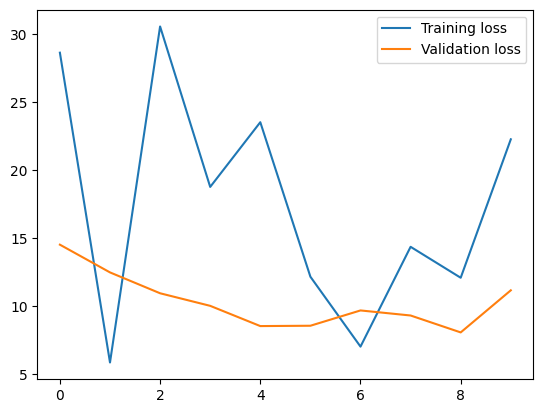

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,89.04026
mae,2.49657
mape,10.95974
val_loss,8.0775


wandb: Agent Starting Run: jogwmuyf with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 115.46134185791016, Validation Loss: 70.12398910522461
----------------------------------------------------------------------------------------------------
Validation MAPE: 39.24305438995361, Validation MAE: 7.905588150024414, Validation Accuracy: 60.75694561004639
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 18.316423416137695, Validation Loss: 28.71736717224121
----------------------------------------------------------------------------------------------------
Validation MAPE: 22.20776379108429, Validation MAE: 4.9153289794921875, Validation Accuracy: 77.79223620891571
----------------------------------------------------------------------------------------------------

-------------------------

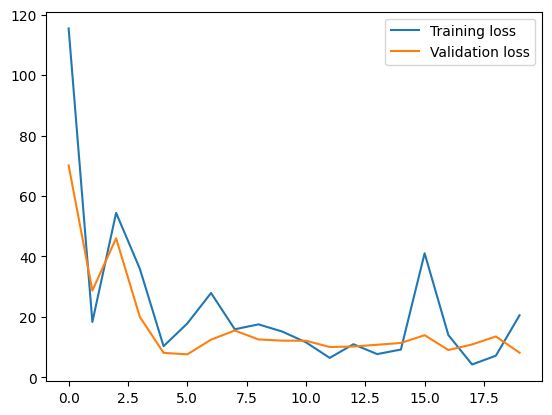

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,91.17591
mae,2.02679
mape,8.82409
val_loss,7.58824


wandb: Agent Starting Run: ae1qs1gu with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 1
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 2.108100175857544, Validation Loss: 13.79700345652444
----------------------------------------------------------------------------------------------------
Validation MAPE: 12.928339838981628, Validation MAE: 2.929757595062256, Validation Accuracy: 87.07166016101837
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 12.963553428649902, Validation Loss: 10.432620482785362
----------------------------------------------------------------------------------------------------
Validation MAPE: 10.22636890411377, Validation MAE: 2.3436384201049805, Validation Accuracy: 89.77363109588623
----------------------------------------------------------------------------------------------------

------------------------

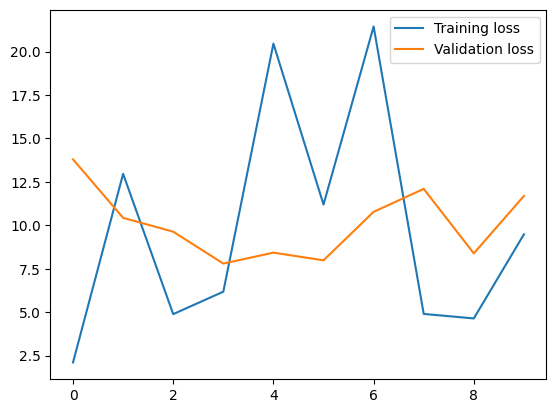

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,88.45774
mae,2.62559
mape,11.54226
val_loss,7.80117


wandb: Agent Starting Run: t0qm306o with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.0001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 203.4222869873047, Validation Loss: 151.98179244995117
----------------------------------------------------------------------------------------------------
Validation MAPE: 58.60866904258728, Validation MAE: 11.928966522216797, Validation Accuracy: 41.39133095741272
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 123.57337188720703, Validation Loss: 104.92738342285156
----------------------------------------------------------------------------------------------------
Validation MAPE: 48.345959186553955, Validation MAE: 9.7888822555542, Validation Accuracy: 51.654040813446045
----------------------------------------------------------------------------------------------------

------------------------

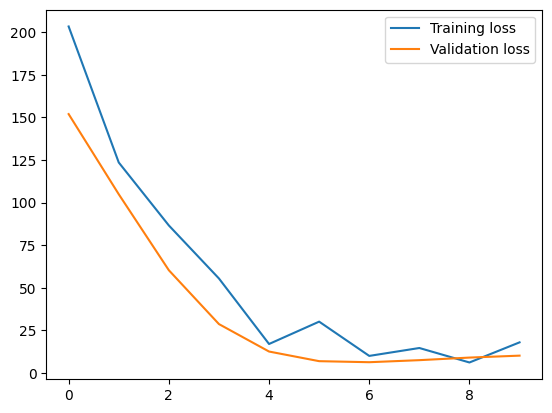

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,89.45217
mae,2.41483
mape,10.54783
val_loss,6.30164


wandb: Agent Starting Run: i1f9sasv with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 227.28646850585938, Validation Loss: 239.5764923095703
----------------------------------------------------------------------------------------------------
Validation MAPE: 72.61762022972107, Validation MAE: 15.435665130615234, Validation Accuracy: 27.38237977027893
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 95.25220489501953, Validation Loss: 105.71595764160156
----------------------------------------------------------------------------------------------------
Validation MAPE: 47.19710052013397, Validation MAE: 10.134720802307129, Validation Accuracy: 52.80289947986603
----------------------------------------------------------------------------------------------------

------------------------

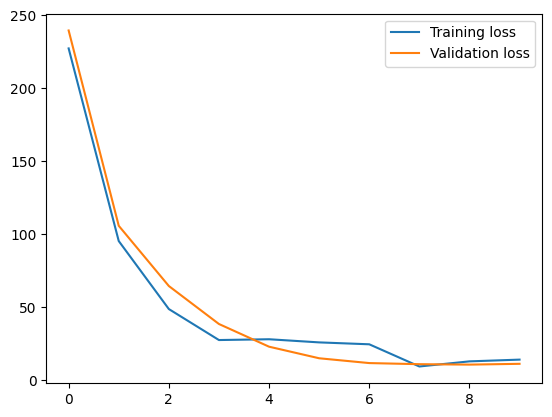

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,88.5315
mae,2.6154
mape,11.4685
val_loss,10.55974


wandb: Agent Starting Run: y02gpwl4 with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0
wandb: 	hidden_size: 64
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 15.67760181427002, Validation Loss: 26.694713865007675
----------------------------------------------------------------------------------------------------
Validation MAPE: 20.48405110836029, Validation MAE: 4.551843643188477, Validation Accuracy: 79.51594889163971
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 15.374589920043945, Validation Loss: 11.742194788796562
----------------------------------------------------------------------------------------------------
Validation MAPE: 11.121286451816559, Validation MAE: 2.5401487350463867, Validation Accuracy: 88.87871354818344
----------------------------------------------------------------------------------------------------

-----------------------

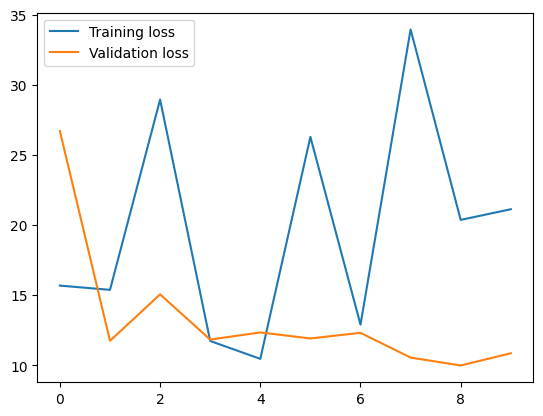

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,89.63018
mae,2.37564
mape,10.36982
val_loss,9.98088


wandb: Agent Starting Run: 017g4hyu with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0
wandb: 	hidden_size: 128
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 42.897239685058594, Validation Loss: 7.719761848449707
----------------------------------------------------------------------------------------------------
Validation MAPE: 10.582133382558823, Validation MAE: 2.2075726985931396, Validation Accuracy: 89.41786661744118
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 25.86243438720703, Validation Loss: 13.97057580947876
----------------------------------------------------------------------------------------------------
Validation MAPE: 13.814273476600647, Validation MAE: 3.1201062202453613, Validation Accuracy: 86.18572652339935
----------------------------------------------------------------------------------------------------

-----------------------

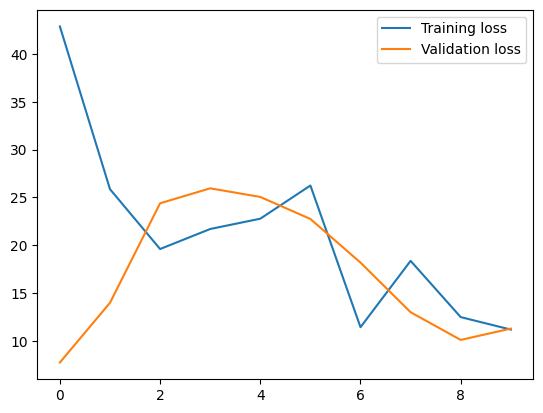

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,88.39208
mae,2.64557
mape,11.60792
val_loss,7.71976


wandb: Agent Starting Run: a4n5dzse with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0
wandb: 	hidden_size: 64
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 26.42549705505371, Validation Loss: 16.61860188416072
----------------------------------------------------------------------------------------------------
Validation MAPE: 14.969854056835175, Validation MAE: 3.3683903217315674, Validation Accuracy: 85.03014594316483
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 37.403629302978516, Validation Loss: 15.765311326299395
----------------------------------------------------------------------------------------------------
Validation MAPE: 14.381642639636993, Validation MAE: 3.2420096397399902, Validation Accuracy: 85.618357360363
----------------------------------------------------------------------------------------------------

------------------------

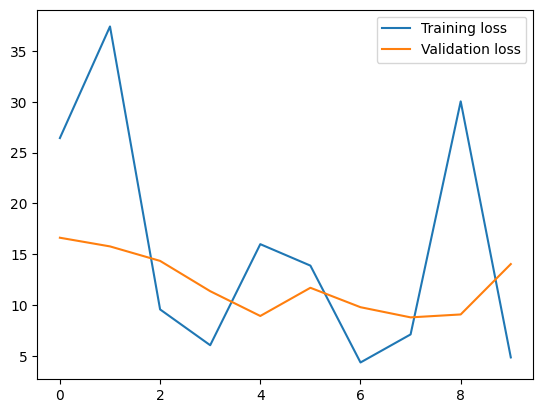

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,86.85925
mae,2.9754
mape,13.14075
val_loss,8.78197


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: tvs2js7a with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 9.547354698181152, Validation Loss: 24.69116715022496
----------------------------------------------------------------------------------------------------
Validation MAPE: 19.544248282909393, Validation MAE: 4.351230144500732, Validation Accuracy: 80.4557517170906
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 10.87834644317627, Validation Loss: 13.545887538364955
----------------------------------------------------------------------------------------------------
Validation MAPE: 12.732698023319244, Validation MAE: 2.887722969055176, Validation Accuracy: 87.26730197668076
----------------------------------------------------------------------------------------------------

--------------------------

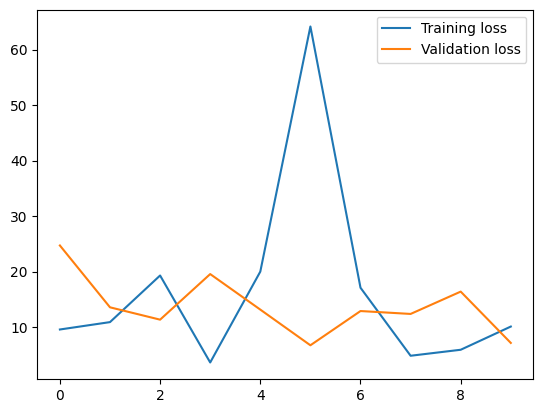

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,92.25417
mae,1.75518
mape,7.74583
val_loss,6.70148


wandb: Agent Starting Run: g0qqtevt with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0
wandb: 	hidden_size: 128
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 16.24825668334961, Validation Loss: 12.413488473211016
----------------------------------------------------------------------------------------------------
Validation MAPE: 11.77128255367279, Validation MAE: 2.6808812618255615, Validation Accuracy: 88.22871744632721
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 10.033366203308105, Validation Loss: 12.955771190779549
----------------------------------------------------------------------------------------------------
Validation MAPE: 12.238303571939468, Validation MAE: 2.781498670578003, Validation Accuracy: 87.76169642806053
----------------------------------------------------------------------------------------------------

-----------------------

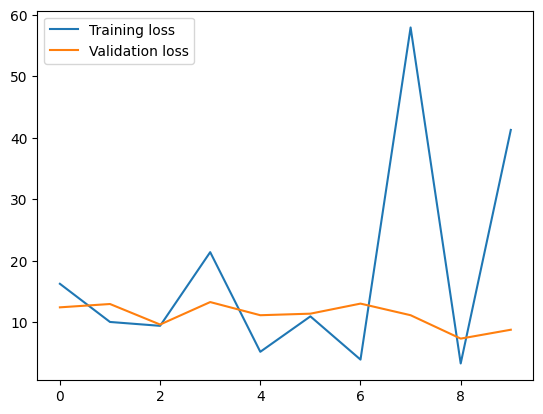

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,91.27699
mae,2.00312
mape,8.72301
val_loss,7.32224


wandb: Agent Starting Run: zsg5iolz with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0
wandb: 	hidden_size: 128
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 1
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 17.466899871826172, Validation Loss: 37.48063278198242
----------------------------------------------------------------------------------------------------
Validation MAPE: 25.59766173362732, Validation MAE: 5.627493858337402, Validation Accuracy: 74.40233826637268
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 19.144121170043945, Validation Loss: 23.97319507598877
----------------------------------------------------------------------------------------------------
Validation MAPE: 19.13396418094635, Validation MAE: 4.2630767822265625, Validation Accuracy: 80.86603581905365
----------------------------------------------------------------------------------------------------

-------------------------

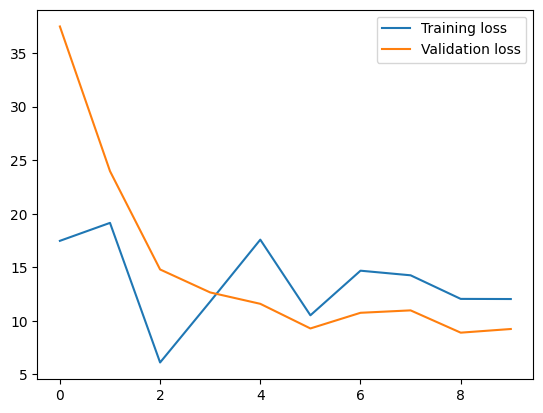

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,90.78536
mae,2.11458
mape,9.21464
val_loss,8.89377


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: vrvtwd0m with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 20
wandb: 	num_layers: 1
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/20, Loss: 18.45256996154785, Validation Loss: 13.103001867021833
----------------------------------------------------------------------------------------------------
Validation MAPE: 12.32689842581749, Validation MAE: 2.8004603385925293, Validation Accuracy: 87.67310157418251
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/20, Loss: 18.043508529663086, Validation Loss: 10.095917650631495
----------------------------------------------------------------------------------------------------
Validation MAPE: 9.816083312034607, Validation MAE: 2.2522757053375244, Validation Accuracy: 90.1839166879654
----------------------------------------------------------------------------------------------------

------------------------

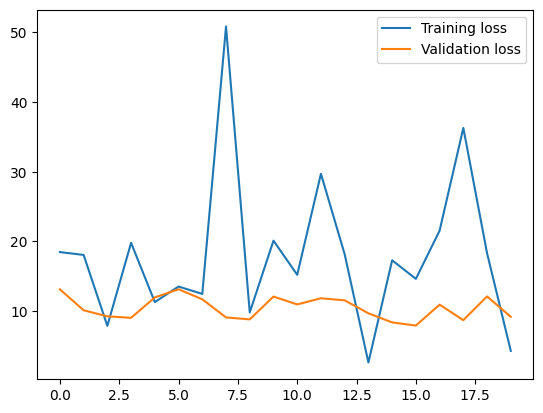

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,90.6939
mae,2.12189
mape,9.3061
val_loss,7.90035


wandb: Agent Starting Run: gznyedab with config:
wandb: 	batch_size: 64
wandb: 	dropout: 0.1
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 59.336856842041016, Validation Loss: 19.282402992248535
----------------------------------------------------------------------------------------------------
Validation MAPE: 20.263096690177917, Validation MAE: 4.108647346496582, Validation Accuracy: 79.73690330982208
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 15.816418647766113, Validation Loss: 21.406845569610596
----------------------------------------------------------------------------------------------------
Validation MAPE: 18.51593405008316, Validation MAE: 4.130289554595947, Validation Accuracy: 81.48406594991684
----------------------------------------------------------------------------------------------------

-----------------------

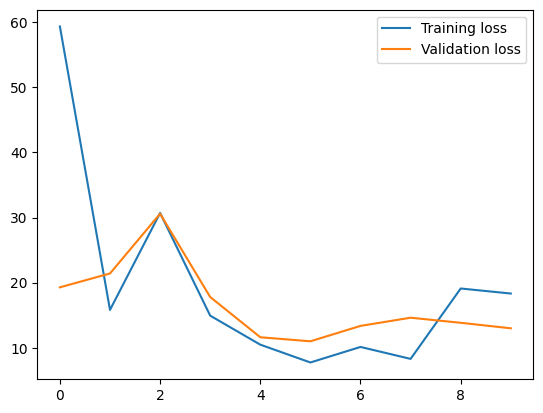

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,86.93326
mae,2.9595
mape,13.06674
val_loss,10.99348


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xmigfafs with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0
wandb: 	hidden_size: 64
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 3.822842836380005, Validation Loss: 11.865046441555023
----------------------------------------------------------------------------------------------------
Validation MAPE: 11.306917667388916, Validation MAE: 2.580437183380127, Validation Accuracy: 88.69308233261108
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 27.506378173828125, Validation Loss: 11.495827393872398
----------------------------------------------------------------------------------------------------
Validation MAPE: 10.990400612354279, Validation MAE: 2.5117413997650146, Validation Accuracy: 89.00959938764572
----------------------------------------------------------------------------------------------------

----------------------

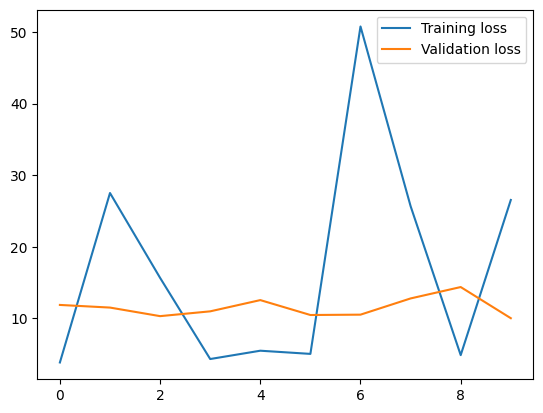

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,90.25264
mae,2.23693
mape,9.74736
val_loss,10.0103


wandb: Agent Starting Run: qx3x9pog with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 7.528306484222412, Validation Loss: 17.237069266183035
----------------------------------------------------------------------------------------------------
Validation MAPE: 15.284396708011627, Validation MAE: 3.435972213745117, Validation Accuracy: 84.71560329198837
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 25.830305099487305, Validation Loss: 13.029205765042986
----------------------------------------------------------------------------------------------------
Validation MAPE: 12.201816588640213, Validation MAE: 2.7736592292785645, Validation Accuracy: 87.79818341135979
----------------------------------------------------------------------------------------------------

----------------------

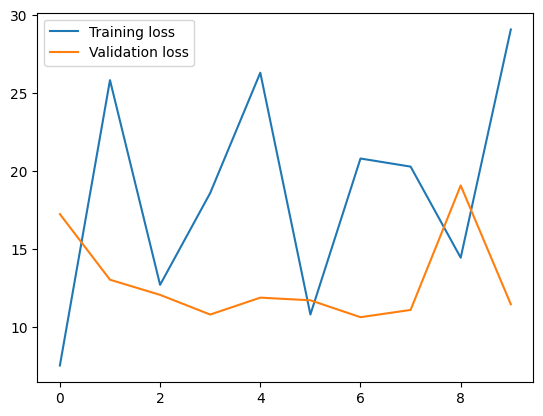

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,89.13179
mae,2.4851
mape,10.86821
val_loss,10.62538


wandb: Agent Starting Run: l9mpbtb0 with config:
wandb: 	batch_size: 32
wandb: 	dropout: 0
wandb: 	hidden_size: 128
wandb: 	l2: 0.2
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 1
wandb: 	weight_decay: 0.5
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 183.64955139160156, Validation Loss: 194.71279525756836
----------------------------------------------------------------------------------------------------
Validation MAPE: 65.30895233154297, Validation MAE: 13.911587715148926, Validation Accuracy: 34.69104766845703
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 88.84882354736328, Validation Loss: 137.1726303100586
----------------------------------------------------------------------------------------------------
Validation MAPE: 54.292845726013184, Validation MAE: 11.614396095275879, Validation Accuracy: 45.707154273986816
----------------------------------------------------------------------------------------------------

----------------------

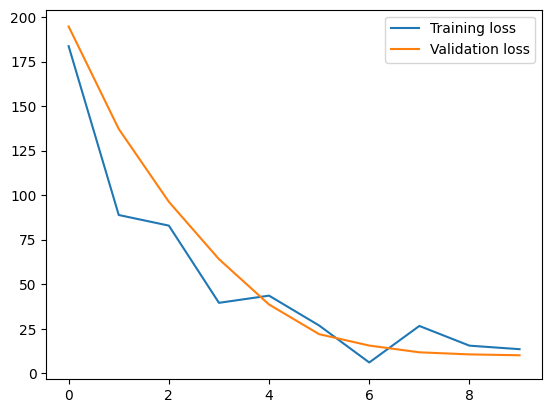

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,89.36293
mae,2.4344
mape,10.63707
val_loss,10.07634


wandb: Agent Starting Run: l7yf2m24 with config:
wandb: 	batch_size: 8
wandb: 	dropout: 0
wandb: 	hidden_size: 128
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 3
wandb: 	weight_decay: 0.2
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 20.20701026916504, Validation Loss: 14.901069028036934
----------------------------------------------------------------------------------------------------
Validation MAPE: 13.753795623779297, Validation MAE: 3.107112407684326, Validation Accuracy: 86.2462043762207
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 2.570344924926758, Validation Loss: 11.603622300284249
----------------------------------------------------------------------------------------------------
Validation MAPE: 11.07686311006546, Validation MAE: 2.5305070877075195, Validation Accuracy: 88.92313688993454
----------------------------------------------------------------------------------------------------

-------------------------

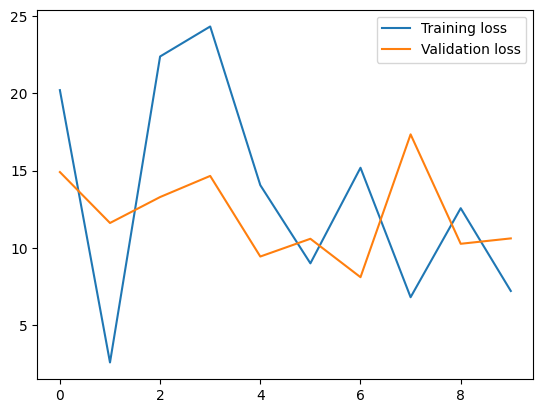

accuracy,▁
mae,▁
mape,▁
val_loss,▁
accuracy,89.75987
mae,2.34694
mape,10.24013
val_loss,8.09415


wandb: Agent Starting Run: 7g6y3xje with config:
wandb: 	batch_size: 16
wandb: 	dropout: 0
wandb: 	hidden_size: 256
wandb: 	l2: 0.5
wandb: 	lr: 0.001
wandb: 	num_epochs: 10
wandb: 	num_layers: 2
wandb: 	weight_decay: 0.1
wandb: 	window_size_minutes: 10


----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 21.869384765625, Validation Loss: 19.27825771059309
----------------------------------------------------------------------------------------------------
Validation MAPE: 16.552186012268066, Validation MAE: 3.7083652019500732, Validation Accuracy: 83.44781398773193
----------------------------------------------------------------------------------------------------



In [16]:
# Hyperparameter tuning in wandb
sweep_config = {
    'method': 'bayes',
    'metric': {
        'name': 'val_loss',
        'goal': 'minimize'
    },
    'parameters': {
        'hidden_size': {
            'values': [32, 64, 128, 256]
        },
        'window_size_minutes': {
            'values': [1, 2, 5, 7, 10]
        },
        'num_layers': {
            'values': [1, 2, 3]
        },
        'dropout': {
            'values': [0.0, 0.1, 0.2, 0.5]
        },
        'l2': {
            'values': [0.0, 0.1, 0.2, 0.5]
        },
        'lr': {
            'values': [0.001, 0.0001]
        },
        'weight_decay': {
            'values': [0.0, 0.1, 0.2, 0.5]

        },
        'batch_size': {
            'values': [8, 16, 32, 64]
        
        }, 
        'num_epochs': {
            'values': [10, 20]
    
    }
}
}



sweep_id = wandb.sweep(sweep_config, project="sleep-onset-detection")

def train_and_eval(config=None):
    with wandb.init(config=config):
        config = wandb.config
        train_losses, val_losses, model, accuracy, mape, mae = training_loop_feature_RNN(mydata, config.num_epochs, config.hidden_size, config.num_layers, config.dropout, config.l2, config.lr, config.weight_decay, config.batch_size, device, window_size_minutes=config.window_size_minutes)
        wandb.log({"val_loss": min(val_losses), "accuracy": accuracy, "mape": mape, "mae": mae})

sweep_id = wandb.sweep(sweep_config, project="my_project")

# Run the sweep
wandb.agent(sweep_id, function=train_and_eval)

    

    
    



